In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Carica i dati
transfers = pd.read_csv("../Datasets/SNA/transfers.csv")

# Crea il grafo
G = nx.DiGraph()

# Aggiungi nodi (club)
clubs = set(transfers['from_club_id']).union(set(transfers['to_club_id']))
for club in clubs:
    G.add_node(club, type='club')

# Aggiungi nodi (giocatori)
players = transfers['player_id'].unique()
for player in players:
    G.add_node(player, type='player')

# Aggiungi archi (trasferimenti)
for _, row in transfers.iterrows():
    G.add_edge(row['from_club_id'], row['to_club_id'], 
               player=row['player_id'],
               date=row['transfer_date'],
               fee=row['transfer_fee'],
               market_value=row['market_value_in_eur'])

# Visualizza un grafo semplice
plt.figure(figsize=(12, 12))
pos = nx.spring_layout(G)  # Layout per il grafo
nx.draw(G, pos, with_labels=False, node_size=20, edge_color="blue", alpha=0.6)
plt.title("Rete dei trasferimenti")
plt.show()

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# ------------------------------------------------------
# 1. LETTURA DEI CSV
# ------------------------------------------------------
print("=== 1. Lettura dei CSV ===")
clubs = pd.read_csv("../Datasets/SNA/clubs.csv")
transfers = pd.read_csv("../Datasets/SNA/transfers.csv")

print("Clubs (prime 5 righe):")
print(clubs.head())
print("\nTransfers (prime 5 righe):")
print(transfers.head())


In [ ]:
# ------------------------------------------------------
# 2. PREPARAZIONE DIZIONARIO club_id -> club_name
# ------------------------------------------------------
print("\n=== 2. Creazione dizionario club_id_to_name ===")
# Assicuriamoci che 'club_id' sia integer (se nel CSV è string, fai .astype(int))
clubs["club_id"] = clubs["club_id"].astype(int)

club_id_to_name = dict(zip(clubs["club_id"], clubs["name"]))
print("Esempio di mapping (primi 5):")
for i, (k, v) in enumerate(club_id_to_name.items()):
    print(k, "->", v)
    if i >= 4:
        break

In [ ]:
# ------------------------------------------------------
# 3. CREAZIONE DEL GRAFO
# ------------------------------------------------------
print("\n=== 3. Creazione del grafo con i club come nodi ===")

# In transfers.csv, 'from_club_id' e 'to_club_id' devono anch'essi essere int
transfers["from_club_id"] = transfers["from_club_id"].astype(int)
transfers["to_club_id"] = transfers["to_club_id"].astype(int)

# Creiamo un grafo diretto
G = nx.DiGraph()

for idx, row in transfers.iterrows():
    from_id = row["from_club_id"]
    to_id = row["to_club_id"]
    
    # Se i from_id / to_id non sono in clubs, saltiamo per sicurezza
    if from_id not in club_id_to_name or to_id not in club_id_to_name:
        continue
    
    # Se l'arco esiste già, sommiamo i costi o incrementiamo contatore
    if G.has_edge(from_id, to_id):
        G[from_id][to_id]["weight"] += 1
        G[from_id][to_id]["cost"] += row.get("transfer_fee", 0)
    else:
        G.add_edge(
            from_id, to_id, 
            weight=1, 
            cost=row.get("transfer_fee", 0)
        )

print("Numero di nodi:", G.number_of_nodes())
print("Numero di archi:", G.number_of_edges())

In [ ]:
# ------------------------------------------------------
# 4. RILABEL NODES: DA club_id A club_name
# ------------------------------------------------------
print("\n=== 4. Rilabel nodes con club_id_to_name ===")
nx.relabel_nodes(G, club_id_to_name, copy=False)

print("Esempio di nodi (5 nodi random):")
sample_nodes = list(G.nodes)[:5]
print(sample_nodes)

In [ ]:
# ------------------------------------------------------
# 5. VISUALIZZAZIONE
# ------------------------------------------------------
print("\n=== 5. Visualizzazione del grafo con nomi dei club ===")

plt.figure(figsize=(12, 12))

# Layout
pos = nx.spring_layout(G, seed=42)

# Se vogliamo disegnare in base a 'weight' o 'cost', scegliamo uno dei due
edges, costs = zip(*nx.get_edge_attributes(G, 'weight').items())

# Disegno nodi
nx.draw_networkx_nodes(G, pos, node_size=50, node_color='skyblue', alpha=0.9)

# Disegno archi con spessore proporzionale al costo (ad es. ridotto di 1e7)
nx.draw_networkx_edges(
    G, pos, edgelist=edges, 
    width=[c / 1e7 for c in costs], 
    edge_color='gray', alpha=0.7
)

# Disegno etichette
nx.draw_networkx_labels(G, pos, font_size=8, font_color='black')

plt.title("Rete dei Club con nomi (non ID)", fontsize=14)
plt.axis('off')
plt.show()

print("\n=== Fine Notebook ===")

In [ ]:
# Disegnare il grafo con archi ponderati
plt.figure(figsize=(12, 12))
pos = nx.spring_layout(G, seed=42)  # Layout per la disposizione dei nodi

# Estrazione dei pesi degli archi
edges, weights = zip(*nx.get_edge_attributes(G, 'weight').items())

# Disegnare nodi
nx.draw_networkx_nodes(G, pos, node_size=50, node_color='skyblue', alpha=0.9)

# Disegnare archi con spessore proporzionale al peso
nx.draw_networkx_edges(G, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare etichette dei nodi
nx.draw_networkx_labels(G, pos, font_size=8, font_color='black')

# Titolo del grafo
plt.title("Rete dei Club: Peso = Numero di Trasferimenti", fontsize=14)
plt.axis('off')  # Nascondere assi
plt.show()

In [ ]:
# ------------------------------------------------------
# 5. VISUALIZZAZIONE
# ------------------------------------------------------
print("\n=== 5. Visualizzazione del grafo con nomi dei club ===")

plt.figure(figsize=(12, 12))

# Layout
pos = nx.spring_layout(G, seed=42)

# Se vogliamo disegnare in base a 'weight' o 'cost', scegliamo uno dei due
edges, costs = zip(*nx.get_edge_attributes(G, 'cost').items())

# Disegno nodi
nx.draw_networkx_nodes(G, pos, node_size=50, node_color='lightgreen', alpha=0.9)

# Disegno archi con spessore proporzionale al costo (ad es. ridotto di 1e7)
nx.draw_networkx_edges(
    G, pos, edgelist=edges, 
    width=[c / 1e7 for c in costs], 
    edge_color='gray', alpha=0.7
)

# Disegno etichette
nx.draw_networkx_labels(G, pos, font_size=8, font_color='black')

plt.title("Rete dei Club con nomi (non ID)", fontsize=14)
plt.axis('off')
plt.show()

print("\n=== Fine Notebook ===")

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 12))
pos = nx.spring_layout(G, seed=42)

# Se hai i pesi negli attributi "cost" o "weight", estraili
edges, costs = zip(*nx.get_edge_attributes(G, 'cost').items())

# Disegna i nodi con i NOMI già relabeled
nx.draw_networkx_nodes(G, pos, node_size=50, node_color='lightgreen', alpha=0.9)

# Disegna gli archi, con spessore proporzionale
nx.draw_networkx_edges(G, pos, edgelist=edges, width=[c / 1e7 for c in costs], edge_color='gray', alpha=0.7)

# Disegna le etichette dei nodi (ora sono i nomi dei club)
nx.draw_networkx_labels(G, pos, font_size=8, font_color='black')

plt.title("Rete dei Club (con nome invece di ID)", fontsize=14)
plt.axis('off')
plt.show()

In [ ]:
# Identifica le comunità
communities = list(greedy_modularity_communities(G))

# Colori distinti per ogni comunità
community_map = {}
for i, community in enumerate(communities):
    for node in community:
        community_map[node] = i

colors = [community_map[node] for node in G.nodes]

plt.figure(figsize=(12, 12))
nx.draw(G, pos, node_size=50, node_color=colors, cmap=plt.cm.tab20, alpha=0.8)
plt.title("Comunità nella Rete dei Club", fontsize=14)
plt.show()

In [ ]:
degree_centrality = nx.degree_centrality(G)

plt.figure(figsize=(12, 12))
node_sizes = [v * 3000 for v in degree_centrality.values()]
nx.draw(G, pos, node_size=node_sizes, node_color='lightcoral', alpha=0.7)
plt.title("Degree Centrality dei Club", fontsize=14)
plt.show()

In [ ]:
betweenness_centrality = nx.betweenness_centrality(G)

plt.figure(figsize=(12, 12))
node_sizes = [v * 3000 for v in betweenness_centrality.values()]
nx.draw(G, pos, node_size=node_sizes, node_color='gold', alpha=0.7)
plt.title("Betweenness Centrality dei Club", fontsize=14)
plt.show()

In [ ]:
closeness_centrality = nx.closeness_centrality(G)

plt.figure(figsize=(12, 12))
node_sizes = [v * 3000 for v in closeness_centrality.values()]
nx.draw(G, pos, node_size=node_sizes, node_color='lime', alpha=0.7)
plt.title("Closeness Centrality dei Club", fontsize=14)
plt.show()

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Supponendo che G sia il grafo già creato e relabeled con i nomi dei club
# (cioè i nodi sono le stringhe dei nomi, e non gli ID numerici)

plt.figure(figsize=(16, 12))  # Aumentiamo la dimensione della figura

# Parametri del layout. 'k' controlla la forza di repulsione tra nodi:
pos = nx.spring_layout(G, seed=42, k=0.5, iterations=200)

# Se G è molto grande, potresti filtrare o ridurre i nodi/archi.
# Esempio: visualizzare solo nodi con grado > X
# sub_nodes = [n for n, deg in G.degree() if deg > 3]
# G = G.subgraph(sub_nodes).copy()

# Disegno dei nodi
nx.draw_networkx_nodes(
    G,
    pos,
    node_size=300,      # Aumenta la dimensione del nodo
    node_color='skyblue',
    alpha=0.8
)

# Disegno degli archi
# Se vuoi archi più spessi, regola scale e alpha
edges = G.edges(data=True)
weights = [edge[2].get('cost', 1) for edge in edges]  # o 'weight'
nx.draw_networkx_edges(
    G,
    pos,
    edgelist=edges,
    width=[w / 1e7 for w in weights],  # se 'cost' è molto grande
    edge_color='gray',
    alpha=0.5
)

# Disegno delle etichette
# Aumentiamo il font_size per renderle più visibili
nx.draw_networkx_labels(
    G,
    pos,
    font_size=10,      # Grandezza etichetta
    font_color='black'
)

plt.title("Rete dei Club con Migliore Leggibilità", fontsize=16)
plt.axis('off')  # Nasconde gli assi
plt.tight_layout()  # Ottimizza gli spazi
plt.show()

In [ ]:
from pyvis.network import Network

# Usa 'in_line' o 'remote' al posto di 'local'
net = Network(height='750px',
              width='100%',
              notebook=True,
              directed=True,
              cdn_resources='remote')

# Converti il grafo networkx in PyVis
net.from_nx(G)

# (Opzionale) Regola la fisica e i parametri di layout
net.repulsion(
    node_distance=120,
    spring_length=100,
)

net.show("transfer_network.html")

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Caricamento dei dati
transfers = pd.read_csv("../Datasets/SNA/transfers.csv")
clubs = pd.read_csv("../Datasets/SNA/clubs.csv")

# Verifica dei dati caricati
print("Anteprima del dataset Transfers:")
print(transfers.head())
print("\nAnteprima del dataset Clubs:")
print(clubs.head())

# Filtrare i club italiani
italian_clubs = clubs[clubs["domestic_competition_id"] == "IT1"]
italian_club_ids = italian_clubs["club_id"].unique()

# 1° Approccio: Grafico con squadre italiane senza limiti temporali
# Filtrare i trasferimenti tra squadre italiane
italian_transfers = transfers[
    (transfers["from_club_id"].isin(italian_club_ids)) &
    (transfers["to_club_id"].isin(italian_club_ids))
]

print("\nTrasferimenti tra club italiani (totale):", len(italian_transfers))
print(italian_transfers.head())

# Creare il grafo (somma dei trasferimenti e dei costi come peso)
G_sum_transfers = nx.DiGraph()
G_sum_costs = nx.DiGraph()

for _, row in italian_transfers.iterrows():
    from_club = row["from_club_name"]
    to_club = row["to_club_name"]
    transfer_fee = row["transfer_fee"]
    
    # Somma trasferimenti
    if G_sum_transfers.has_edge(from_club, to_club):
        G_sum_transfers[from_club][to_club]["weight"] += 1
    else:
        G_sum_transfers.add_edge(from_club, to_club, weight=1)
    
    # Somma costi
    if G_sum_costs.has_edge(from_club, to_club):
        G_sum_costs[from_club][to_club]["weight"] += transfer_fee
    else:
        G_sum_costs.add_edge(from_club, to_club, weight=transfer_fee)

print("\nGrafo creato per trasferimenti (nodi):", len(G_sum_transfers.nodes))
print("Grafo creato per trasferimenti (archi):", len(G_sum_transfers.edges))

# Analisi metriche e comunità
def analyze_graph(G, graph_name):
    print(f"\nAnalisi del grafo: {graph_name}")
    print(f"Numero di nodi: {G.number_of_nodes()}")
    print(f"Numero di archi: {G.number_of_edges()}")

    # Calcolare grado
    degrees = dict(G.degree(weight="weight"))
    print(f"Grado medio: {sum(degrees.values()) / len(degrees):.2f}")
    
    # Metriche di centralità
    print("Calcolo della centralità...")
    in_degree_centrality = nx.in_degree_centrality(G)
    out_degree_centrality = nx.out_degree_centrality(G)

    # Individuare comunità
    print("Individuazione comunità...")
    communities = list(nx.community.greedy_modularity_communities(G))
    print(f"Trovate {len(communities)} comunità.")

    return degrees, in_degree_centrality, out_degree_centrality, communities

# Analizzare entrambi i grafi
analyze_graph(G_sum_transfers, "Grafo - Somma Trasferimenti")
analyze_graph(G_sum_costs, "Grafo - Somma Costi")

# 2° Approccio: Solo trasferimenti degli ultimi 10 anni
italian_transfers_10yrs = italian_transfers[
    pd.to_datetime(italian_transfers["transfer_date"]) >= pd.to_datetime("2014-01-01")
]

print("\nTrasferimenti italiani ultimi 10 anni (totale):", len(italian_transfers_10yrs))
print(italian_transfers_10yrs.head())

# Creare un nuovo grafo con lo stesso processo
G_sum_transfers_10yrs = nx.DiGraph()
G_sum_costs_10yrs = nx.DiGraph()

for _, row in italian_transfers_10yrs.iterrows():
    from_club = row["from_club_name"]
    to_club = row["to_club_name"]
    transfer_fee = row["transfer_fee"]
    
    # Somma trasferimenti
    if G_sum_transfers_10yrs.has_edge(from_club, to_club):
        G_sum_transfers_10yrs[from_club][to_club]["weight"] += 1
    else:
        G_sum_transfers_10yrs.add_edge(from_club, to_club, weight=1)
    
    # Somma costi
    if G_sum_costs_10yrs.has_edge(from_club, to_club):
        G_sum_costs_10yrs[from_club][to_club]["weight"] += transfer_fee
    else:
        G_sum_costs_10yrs.add_edge(from_club, to_club, weight=transfer_fee)

print("\nGrafo creato per trasferimenti ultimi 10 anni (nodi):", len(G_sum_transfers_10yrs.nodes))
print("Grafo creato per trasferimenti ultimi 10 anni (archi):", len(G_sum_transfers_10yrs.edges))

# Analizzare i grafi degli ultimi 10 anni
analyze_graph(G_sum_transfers_10yrs, "Grafo Ultimi 10 Anni - Somma Trasferimenti")
analyze_graph(G_sum_costs_10yrs, "Grafo Ultimi 10 Anni - Somma Costi")

# Visualizzazione di un grafo
def draw_graph(G, title):
    plt.figure(figsize=(12, 8))
    pos = nx.spring_layout(G, seed=42)
    nx.draw(G, pos, with_labels=True, node_size=700, node_color="skyblue", edge_color="gray", font_size=10)
    plt.title(title)
    plt.show()

draw_graph(G_sum_transfers, "Grafo - Trasferimenti Club Italiani")
draw_graph(G_sum_transfers_10yrs, "Grafo - Trasferimenti Club Italiani (Ultimi 10 Anni)")

# CODICE FINALE!!!

In [36]:
# Importiamo le librerie necessarie
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns

# Caricamento dei dati (modifica i percorsi ai tuoi file)
print("=== 1. Lettura dei CSV ===")
transfers = pd.read_csv("../Datasets/SNA/transfers.csv")
clubs = pd.read_csv("../Datasets/SNA/clubs.csv")

# Verifica dei dati caricati
print("\nAnteprima del dataset Clubs:")
print(clubs.head())

print("\nAnteprima del dataset Transfers:")
print(transfers.head())

=== 1. Lettura dei CSV ===

Anteprima del dataset Clubs:
   club_id          club_code                             name  \
0      105    sv-darmstadt-98                  SV Darmstadt 98   
1    11127  ural-ekaterinburg               Ural Yekaterinburg   
2      114  besiktas-istanbul        Beşiktaş Jimnastik Kulübü   
3       12             as-rom       Associazione Sportiva Roma   
4      148  tottenham-hotspur  Tottenham Hotspur Football Club   

  domestic_competition_id  total_market_value  squad_size  average_age  \
0                      L1                 NaN          27         25.6   
1                     RU1                 NaN          30         26.5   
2                     TR1                 NaN          31         26.4   
3                     IT1                 NaN          26         26.4   
4                     GB1                 NaN          27         25.5   

   foreigners_number  foreigners_percentage  national_team_players  \
0                 13           

In [37]:
# ------------------------------------------------------
# 2. CONVERSIONE DEI DATI
# ------------------------------------------------------
print("\n=== 2. Conversione dei club_id in entrambi i dataset ===")

# Assicuriamoci che 'club_id' sia un intero
clubs["club_id"] = clubs["club_id"].astype(int)
transfers["from_club_id"] = transfers["from_club_id"].astype(int)
transfers["to_club_id"] = transfers["to_club_id"].astype(int)

# Verifica che i tipi siano corretti
print(f"\nTipo di 'club_id' in clubs: {clubs['club_id'].dtype}")
print(f"Tipo di 'from_club_id' e 'to_club_id' in transfers: {transfers['from_club_id'].dtype}, {transfers['to_club_id'].dtype}")


=== 2. Conversione dei club_id in entrambi i dataset ===

Tipo di 'club_id' in clubs: int64
Tipo di 'from_club_id' e 'to_club_id' in transfers: int64, int64


In [38]:
# ------------------------------------------------------
# 3. CREAZIONE DEL DIZIONARIO CLUB_ID -> CLUB_NAME
# ------------------------------------------------------
print("\n=== 3. Creazione dizionario club_id -> club_name ===")
club_id_to_name = dict(zip(clubs["club_id"], clubs["name"]))

# Verifica del dizionario
print("\nEsempio di dizionario club_id -> club_name (primi 5):")
for i, (k, v) in enumerate(club_id_to_name.items()):
    if i >= 5:
        break
    print(f"{k} -> {v}")


=== 3. Creazione dizionario club_id -> club_name ===

Esempio di dizionario club_id -> club_name (primi 5):
105 -> SV Darmstadt 98
11127 -> Ural Yekaterinburg
114 -> Beşiktaş Jimnastik Kulübü
12 -> Associazione Sportiva Roma
148 -> Tottenham Hotspur Football Club


Dettaglio delle metriche:


	•	Numero di nodi: Calcola il numero di nodi nel grafo.
	•	Numero di archi: Calcola il numero di archi nel grafo.
	•	Densità: La densità di un grafo è il rapporto tra il numero di archi effettivi e il numero massimo di archi possibili in un grafo completo.
	•	Clustering medio: La media dei coefficienti di clustering per tutti i nodi del grafo. Indica la “densità” di connessioni tra vicini di un nodo.
	•	Raggio: Il raggio del grafo è la massima distanza più breve tra un nodo e qualsiasi altro nodo (solo nei grafi connessi).
	•	Diametro: Il diametro del grafo è la massima distanza tra due nodi qualsiasi (solo nei grafi connessi). (Uso average_clustering: Poiché stiamo lavorando con un grafo diretto, il calcolo del clustering viene fatto su una versione non diretta del grafo, utilizzando G.to_undirected(). Questo converte temporaneamente il grafo diretto in uno non diretto per il calcolo del clustering, che non è definito per i grafi diretti.)
	•	Grado dei nodi: Il grado di un nodo è il numero di archi incidenti su di esso. La funzione restituisce un dizionario con il grado per ogni nodo.
	•	Centralità di grado: La centralità di grado di un nodo è il rapporto tra il grado del nodo e il numero massimo di nodi che può avere.
	•	Centralità di betweenness: La centralità di betweenness misura quanto un nodo funge da ponte (o “mediator”) tra altri due nodi.
	•	Centralità di PageRank: Misura la “importanza” di un nodo basata sulla struttura del grafo, considerando la centralità dei suoi vicini.

In [39]:
import networkx as nx

def calculate_and_print_graph_metrics(G):
    # Numero di nodi
    num_nodes = G.number_of_nodes()

    # Numero di archi
    num_edges = G.number_of_edges()

    # Densità del grafo
    density = round(nx.density(G), 3)

    # Clustering medio (per grafi diretti)
    avg_clustering = round(nx.average_clustering(G.to_undirected()), 3)  # Usiamo la versione non diretta per il clustering

    # Verifica se il grafo è fortemente connesso
    if nx.is_strongly_connected(G):
        radius = nx.radius(G)
        diameter = nx.diameter(G)
    else:
        radius = None
        diameter = None

    # Grado dei nodi
    degree = dict(G.degree())

    # Centralità di grado
    degree_centrality = nx.degree_centrality(G)

    # Centralità di betweenness
    betweenness_centrality = nx.betweenness_centrality(G)

    # Aggiungiamo altre metriche interessanti come la centralità di PageRank
    pagerank_centrality = nx.pagerank(G)

    # Stampiamo le metriche
    print("\n=== Metriche del grafo ===")
    print(f"Numero di nodi: {num_nodes}")
    print(f"Numero di archi: {num_edges}")
    print(f"Densità del grafo: {density}")
    print(f"Clustering medio: {avg_clustering}")
    print(f"Raggio del grafo: {radius}")
    print(f"Diametro del grafo: {diameter}")
    print(f"Grado dei nodi: {degree}")
    print(f"Centralità di grado: {degree_centrality}")
    print(f"Centralità di betweenness: {betweenness_centrality}")
    print(f"Centralità di PageRank: {pagerank_centrality}")

In [40]:
# ------------------------------------------------------
# 4. CREAZIONE DEL GRAFO DEI CLUB
# ------------------------------------------------------
print("\n=== 4. Creazione del grafo dei club con tutti i trasferimenti ===")

# Creiamo un grafo diretto (i trasferimenti vanno da un club a un altro)
G = nx.DiGraph()

# Contatori per i trasferimenti scartati e per club non validi
ignored_transfers = 0
valid_transfers = 0
missing_club_counts = {}

# Aggiungiamo gli archi (trasferimenti tra club)
for idx, row in transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    # Verifica che i club_id siano validi nel dizionario
    if from_club in club_id_to_name and to_club in club_id_to_name:
        valid_transfers += 1
        if G.has_edge(from_club, to_club):
            # Incrementa il peso (numero di trasferimenti)
            G[from_club][to_club]["weight"] += 1
            G[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
        else:
            # Aggiungi l'arco con peso 1
            G.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))
    else:
        ignored_transfers += 1
        # Traccia i club mancanti e incrementa il contatore
        missing_clubs = []
        if from_club not in club_id_to_name:
            missing_clubs.append(f"from_club: {from_club}")
            if from_club not in missing_club_counts:
                missing_club_counts[from_club] = 0
            missing_club_counts[from_club] += 1
        if to_club not in club_id_to_name:
            missing_clubs.append(f"to_club: {to_club}")
            if to_club not in missing_club_counts:
                missing_club_counts[to_club] = 0
            missing_club_counts[to_club] += 1
        
        print(f"Trasferimento ignorato per club_id non valido: {', '.join(missing_clubs)}")

# Stampa dei risultati
print(f"\nNumero di nodi (club) nel grafo: {G.number_of_nodes()}")
print(f"Numero di archi (trasferimenti) nel grafo: {G.number_of_edges()}")
print(f"\nNumero totale di trasferimenti: {valid_transfers}")
print(f"Numero di trasferimenti ignorati: {ignored_transfers}")

# Ordinare il dizionario in ordine decrescente in base al numero di occorrenze
sorted_missing_clubs = sorted(missing_club_counts.items(), key=lambda x: x[1])

# Stampa il numero di trasferimenti ignorati per ciascun club mancante in ordine decrescente
for club, count in sorted_missing_clubs:
    print(f"Trasferimenti mancati a causa del club {club}: {count}")
    
calculate_and_print_graph_metrics(G)


=== 4. Creazione del grafo dei club con tutti i trasferimenti ===
Trasferimento ignorato per club_id non valido: from_club: 279
Trasferimento ignorato per club_id non valido: to_club: 1030
Trasferimento ignorato per club_id non valido: from_club: 3837, to_club: 11204
Trasferimento ignorato per club_id non valido: to_club: 123
Trasferimento ignorato per club_id non valido: to_club: 123
Trasferimento ignorato per club_id non valido: to_club: 123
Trasferimento ignorato per club_id non valido: to_club: 515
Trasferimento ignorato per club_id non valido: to_club: 515
Trasferimento ignorato per club_id non valido: to_club: 515
Trasferimento ignorato per club_id non valido: from_club: 7732
Trasferimento ignorato per club_id non valido: from_club: 8815
Trasferimento ignorato per club_id non valido: from_club: 6945
Trasferimento ignorato per club_id non valido: from_club: 447
Trasferimento ignorato per club_id non valido: from_club: 15642
Trasferimento ignorato per club_id non valido: from_club

In [41]:
# ------------------------------------------------------
# 4.1 Creazione del grafo G con la gestione degli svincolati
# ------------------------------------------------------
print("\n=== 4.1 Creazione del grafo G con la gestione degli svincolati ===")

# Creiamo una copia del grafo originale G_backup per non alterarlo
G_backup = G.copy()

# Creiamo il grafo G, che sarà il grafo modificato
G = nx.DiGraph()

# Creiamo un dizionario per contare i trasferimenti mancati per ogni club
missing_transfers_count = {}

# Aggiungiamo gli archi (trasferimenti tra club)
for idx, row in transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]

    # Se il club di origine o destinazione è 515 (svincolati), lo sostituiamo con "Svincolati"
    if from_club == 515:
        from_club = "Svincolati"
    if to_club == 515:
        to_club = "Svincolati"

    # Verifica che i club_id siano validi nel dizionario (adesso include anche "Svincolati")
    if from_club in club_id_to_name or from_club == "Svincolati":
        if to_club in club_id_to_name or to_club == "Svincolati":
            if G.has_edge(from_club, to_club):
                # Incrementa il peso (numero di trasferimenti)
                G[from_club][to_club]["weight"] += 1
                G[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
            else:
                # Aggiungi l'arco con peso 1
                G.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))
        else:
            # Incrementa i trasferimenti mancati a causa del club di destinazione non valido
            if to_club not in missing_transfers_count:
                missing_transfers_count[to_club] = 0
            missing_transfers_count[to_club] += 1
            print(f"Trasferimento ignorato: il club {to_club} non è valido")
    else:
        # Incrementa i trasferimenti mancati a causa del club di origine non valido
        if from_club not in missing_transfers_count:
            missing_transfers_count[from_club] = 0
        missing_transfers_count[from_club] += 1
        print(f"Trasferimento ignorato: il club {from_club} non è valido")

# Verifica il numero di nodi e archi nel grafo G
print(f"\nNumero di nodi nel grafo G: {G.number_of_nodes()}")
print(f"Numero di archi nel grafo G: {G.number_of_edges()}")

# Stampa i club coinvolti nel grafo
print("\nNodi nel grafo G:")
print(G.nodes())

# Stampa il numero di trasferimenti tra club nel grafo G
total_transfers = sum([G[u][v]['weight'] for u, v in G.edges()])
print(f"\nNumero totale di trasferimenti nel grafo G: {total_transfers}")

calculate_and_print_graph_metrics(G)


=== 4.1 Creazione del grafo G con la gestione degli svincolati ===
Trasferimento ignorato: il club 279 non è valido
Trasferimento ignorato: il club 1030 non è valido
Trasferimento ignorato: il club 3837 non è valido
Trasferimento ignorato: il club 123 non è valido
Trasferimento ignorato: il club 123 non è valido
Trasferimento ignorato: il club 123 non è valido
Trasferimento ignorato: il club 7732 non è valido
Trasferimento ignorato: il club 8815 non è valido
Trasferimento ignorato: il club 6945 non è valido
Trasferimento ignorato: il club 447 non è valido
Trasferimento ignorato: il club 15642 non è valido
Trasferimento ignorato: il club 101362 non è valido
Trasferimento ignorato: il club 978 non è valido
Trasferimento ignorato: il club 409 non è valido
Trasferimento ignorato: il club 332 non è valido
Trasferimento ignorato: il club 1017 non è valido
Trasferimento ignorato: il club 279 non è valido
Trasferimento ignorato: il club 2581 non è valido
Trasferimento ignorato: il club 31614 

In [42]:
# ------------------------------------------------------
# 4.2 Stampa dei trasferimenti mancati per club
# ------------------------------------------------------
print("\n=== Trasferimenti mancati a causa dei club ===")

# Ordina i trasferimenti mancati in ordine crescente di occorrenze
sorted_missing_transfers = sorted(missing_transfers_count.items(), key=lambda x: x[1])

# Stampa i trasferimenti mancati per ogni club
for club, count in sorted_missing_transfers:
    print(f"Trasferimenti mancati a causa del club {club}: {count}")


=== Trasferimenti mancati a causa dei club ===
Trasferimenti mancati a causa del club 34499: 1
Trasferimenti mancati a causa del club 46293: 1
Trasferimenti mancati a causa del club 52687: 1
Trasferimenti mancati a causa del club 16576: 1
Trasferimenti mancati a causa del club 12497: 1
Trasferimenti mancati a causa del club 75596: 1
Trasferimenti mancati a causa del club 76417: 1
Trasferimenti mancati a causa del club 120394: 1
Trasferimenti mancati a causa del club 101813: 1
Trasferimenti mancati a causa del club 79389: 1
Trasferimenti mancati a causa del club 15916: 1
Trasferimenti mancati a causa del club 2945: 1
Trasferimenti mancati a causa del club 95354: 1
Trasferimenti mancati a causa del club 12019: 1
Trasferimenti mancati a causa del club 91427: 1
Trasferimenti mancati a causa del club 98106: 1
Trasferimenti mancati a causa del club 8231: 1
Trasferimenti mancati a causa del club 20887: 1
Trasferimenti mancati a causa del club 83266: 1
Trasferimenti mancati a causa del club 5

In [43]:
# ------------------------------------------------------
# 5. RILABEL DEI NODI CON I NOMI DEI CLUB
# ------------------------------------------------------
print("\n=== 5. Rilabel dei nodi con i nomi dei club ===")

# Rilabel dei nodi nel grafo con i nomi dei club
nx.relabel_nodes(G, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")
    
# Stampa i club coinvolti nel grafo
print("\nNodi nel grafo G:")
print(G.nodes())


=== 5. Rilabel dei nodi con i nomi dei club ===

Esempio di nodi con nome (primi 5):
Svincolati -> {}
Verein für Bewegungsspiele Stuttgart 1893 -> {}
FC Bayern München -> {}
1. Fußball- und Sportverein Mainz 05 -> {}
Società Sportiva Lazio S.p.A. -> {}

Nodi nel grafo G:
['Svincolati', 'Verein für Bewegungsspiele Stuttgart 1893', 'FC Bayern München', '1. Fußball- und Sportverein Mainz 05', 'Società Sportiva Lazio S.p.A.', 'US Salernitana 1919', 'APO Levadiakos Football Club', 'Panathinaikos Athlitikos Omilos', 'Inverness Caledonian Thistle FC', 'Dundee United Football Club', 'Sport Lisboa e Benfica', 'Beşiktaş Jimnastik Kulübü', 'Brøndby Idrætsforening', 'FK Rostov', 'Fußball-Club Augsburg 1907', 'Stade brestois 29', 'Associazione Calcio Fiorentina', 'Fenerbahçe Spor Kulübü', 'Associazione Calcio Monza', 'Juventus Football Club', 'Association sportive de Monaco Football Club', 'Galatasaray Spor Kulübü', 'Aalborg Boldspilklub', 'Borussia Verein für Leibesübungen 1900 Mönchengladbach', 

In [44]:
# ------------------------------------------------------
# 5. RILABEL DEI NODI CON I NOMI DEI CLUB (anche per il grafo senza svincolati)
# ------------------------------------------------------
print("\n=== 5. Rilabel dei nodi con i nomi dei club ===")

# Rilabel dei nodi nel grafo con i nomi dei club
nx.relabel_nodes(G_backup, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_backup.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")
    
# Stampa i club coinvolti nel grafo
print("\nNodi nel grafo G_backup:")
print(G_backup.nodes())


=== 5. Rilabel dei nodi con i nomi dei club ===

Esempio di nodi con nome (primi 5):
Verein für Bewegungsspiele Stuttgart 1893 -> {}
FC Bayern München -> {}
1. Fußball- und Sportverein Mainz 05 -> {}
Società Sportiva Lazio S.p.A. -> {}
US Salernitana 1919 -> {}

Nodi nel grafo G_backup:
['Verein für Bewegungsspiele Stuttgart 1893', 'FC Bayern München', '1. Fußball- und Sportverein Mainz 05', 'Società Sportiva Lazio S.p.A.', 'US Salernitana 1919', 'APO Levadiakos Football Club', 'Panathinaikos Athlitikos Omilos', 'Inverness Caledonian Thistle FC', 'Dundee United Football Club', 'Sport Lisboa e Benfica', 'Beşiktaş Jimnastik Kulübü', 'Fußball-Club Augsburg 1907', 'Stade brestois 29', 'Associazione Calcio Fiorentina', 'Fenerbahçe Spor Kulübü', 'Associazione Calcio Monza', 'Juventus Football Club', 'Association sportive de Monaco Football Club', 'Galatasaray Spor Kulübü', 'Borussia Verein für Leibesübungen 1900 Mönchengladbach', 'Associazione Sportiva Roma', 'Girona Fútbol Club S. A. D.', 


=== 6. Visualizzazione del grafo ===


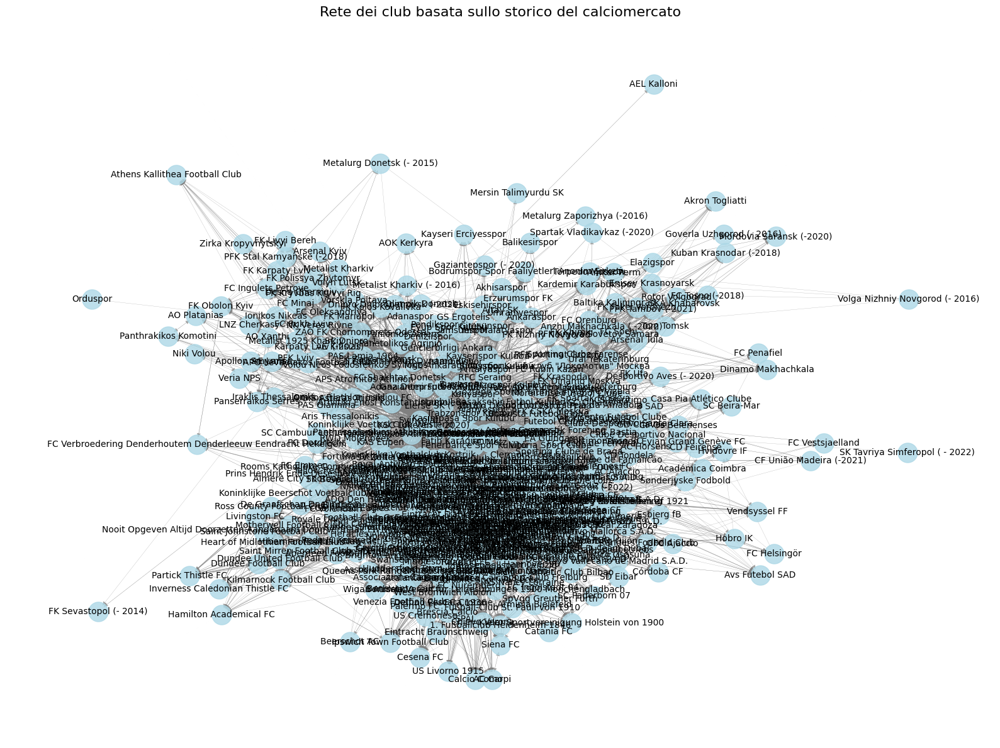


=== Fine della visualizzazione del grafo ===


In [45]:
# ------------------------------------------------------
# 6. VISUALIZZAZIONE DEL GRAFO
# ------------------------------------------------------
print("\n=== 6. Visualizzazione del grafo ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G, seed=42, k=0.5, iterations=200)

# Disegnare i nodi
nx.draw_networkx_nodes(G, pos, node_size=500, node_color='lightblue', alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G, 'weight').items())
nx.draw_networkx_edges(G, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club)
nx.draw_networkx_labels(G, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei club basata sullo storico del calciomercato", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo ===")


=== 6. Visualizzazione del grafo ===


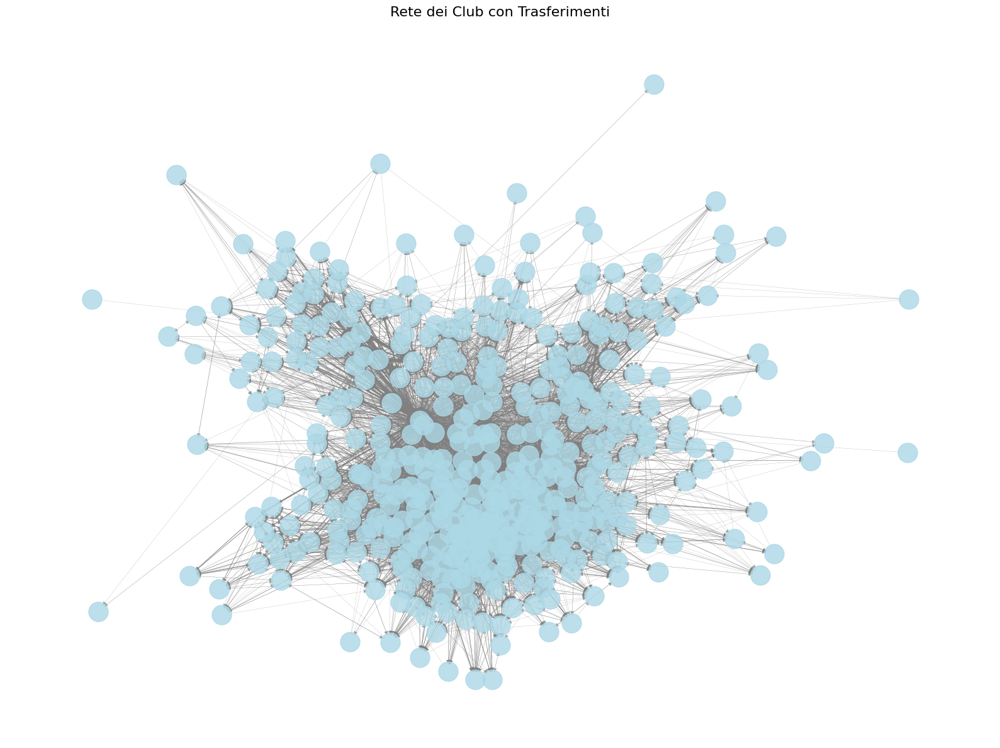


=== Fine della visualizzazione del grafo ===


In [46]:
# ------------------------------------------------------
# 6. VISUALIZZAZIONE DEL GRAFO
# ------------------------------------------------------
print("\n=== 6. Visualizzazione del grafo ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G, seed=42, k=0.5, iterations=200)

# Disegnare i nodi
nx.draw_networkx_nodes(G, pos, node_size=500, node_color='lightblue', alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G, 'weight').items())
nx.draw_networkx_edges(G, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)


# Titolo
plt.title("Rete dei Club con Trasferimenti", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo ===")

In [47]:
calculate_and_print_graph_metrics(G)


=== Metriche del grafo ===
Numero di nodi: 439
Numero di archi: 13183
Densità del grafo: 0.069
Clustering medio: 0.38
Raggio del grafo: None
Diametro del grafo: None
Grado dei nodi: {'Svincolati': 550, 'Verein für Bewegungsspiele Stuttgart 1893': 107, 'FC Bayern München': 97, '1. Fußball- und Sportverein Mainz 05': 103, 'Società Sportiva Lazio S.p.A.': 109, 'US Salernitana 1919': 81, 'APO Levadiakos Football Club': 25, 'Panathinaikos Athlitikos Omilos': 95, 'Inverness Caledonian Thistle FC': 21, 'Dundee United Football Club': 34, 'Sport Lisboa e Benfica': 201, 'Beşiktaş Jimnastik Kulübü': 128, 'Brøndby Idrætsforening': 56, 'FK Rostov': 86, 'Fußball-Club Augsburg 1907': 93, 'Stade brestois 29': 73, 'Associazione Calcio Fiorentina': 133, 'Fenerbahçe Spor Kulübü': 147, 'Associazione Calcio Monza': 52, 'Juventus Football Club': 138, 'Association sportive de Monaco Football Club': 152, 'Galatasaray Spor Kulübü': 160, 'Aalborg Boldspilklub': 42, 'Borussia Verein für Leibesübungen 1900 Mönch


=== 7. Filtraggio dei trasferimenti nel campionato italiano ===

Numero di club italiani: 38
ID dei club italiani: [  12 1025  410  458   46]

Numero di trasferimenti avvenuti tra club italiani: 2082
    player_id transfer_date transfer_season  from_club_id  to_club_id  \
2      626913    2026-06-30           25/26           398         380   
17     301238    2025-07-01           25/26          2919         506   
21     486031    2025-07-01           25/26           430         506   
31      88682    2025-06-30           24/25           749         506   
32      88706    2025-06-30           24/25          1038        8970   

   from_club_name to_club_name  transfer_fee  market_value_in_eur  \
2           Lazio  Salernitana           0.0           15000000.0   
17          Monza     Juventus    14300000.0           18000000.0   
21     Fiorentina     Juventus    28100000.0           35000000.0   
31      FC Empoli     Juventus           0.0            1000000.0   
32      Sampdor

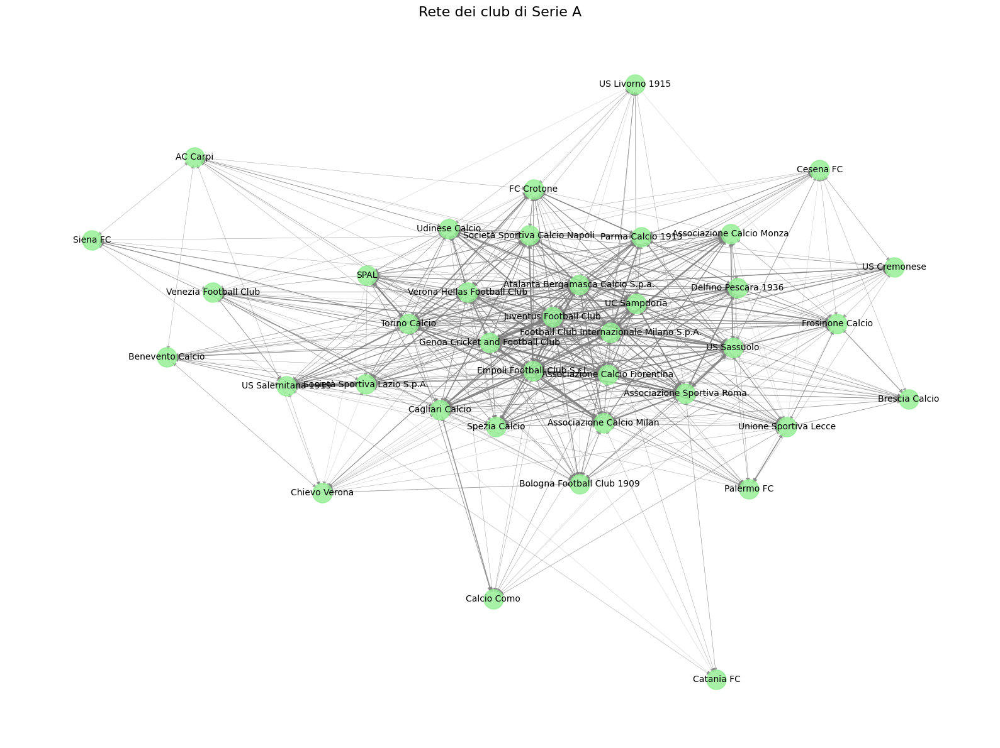


=== Fine della visualizzazione del grafo dei trasferimenti italiani ===

=== Metriche del grafo ===
Numero di nodi: 38
Numero di archi: 784
Densità del grafo: 0.558
Clustering medio: 0.719
Raggio del grafo: 2
Diametro del grafo: 2
Grado dei nodi: {'Società Sportiva Lazio S.p.A.': 46, 'US Salernitana 1919': 46, 'Associazione Calcio Monza': 41, 'Juventus Football Club': 62, 'Associazione Calcio Fiorentina': 54, 'Empoli Football Club S.r.l.': 56, 'UC Sampdoria': 51, 'Frosinone Calcio': 44, 'Calcio Como': 20, 'Genoa Cricket and Football Club': 58, 'Atalanta Bergamasca Calcio S.p.a.': 60, 'Unione Sportiva Lecce': 44, 'Bologna Football Club 1909': 40, 'Verona Hellas Football Club': 55, 'US Sassuolo': 52, 'Associazione Calcio Milan': 55, 'Associazione Sportiva Roma': 46, 'Cagliari Calcio': 44, 'Società Sportiva Calcio Napoli': 49, 'Torino Calcio': 57, 'Spezia Calcio': 40, 'Palermo FC': 28, 'Venezia Football Club': 33, 'Udinese Calcio': 49, 'Football Club Internazionale Milano S.p.A.': 65, 'P

In [48]:
# ------------------------------------------------------
# 7. FILTRARE I CLUB ITALIANI E I TRASFERIMENTI ITALIANI
# ------------------------------------------------------

print("\n=== 7. Filtraggio dei trasferimenti nel campionato italiano ===")

# Filtriamo i club italiani (domestic_competition_id == 'IT1')
italian_clubs = clubs[clubs["domestic_competition_id"] == "IT1"]
italian_club_ids = italian_clubs["club_id"].unique()

print(f"\nNumero di club italiani: {len(italian_clubs)}")
print(f"ID dei club italiani: {italian_club_ids[:5]}")  # Mostriamo i primi 5 club

# Filtriamo i trasferimenti che coinvolgono solo club italiani
italian_transfers = transfers[
    (transfers["from_club_id"].isin(italian_club_ids)) &
    (transfers["to_club_id"].isin(italian_club_ids))
]

print(f"\nNumero di trasferimenti avvenuti tra club italiani: {len(italian_transfers)}")
print(italian_transfers.head())

# ------------------------------------------------------
# 8. CREAZIONE DEL GRAFO CON I TRASFERIMENTI ITALIANI
# ------------------------------------------------------
print("\n=== 8. Creazione del grafo per i trasferimenti italiani ===")

# Creiamo un grafo per i trasferimenti italiani
G_italian = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti italiani
for idx, row in italian_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    if G_italian.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti)
        G_italian[from_club][to_club]["weight"] += 1
        G_italian[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
    else:
        # Aggiungi l'arco con peso 1
        G_italian.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))

print(f"\nNumero di nodi (club italiani) nel grafo: {G_italian.number_of_nodes()}")
print(f"Numero di archi (trasferimenti italiani) nel grafo: {G_italian.number_of_edges()}")

# ------------------------------------------------------
# 9. RILABEL DEI NODI CON I NOMI DEI CLUB ITALIANI
# ------------------------------------------------------
print("\n=== 9. Rilabel dei nodi con i nomi dei club italiani ===")

# Rilabel dei nodi nel grafo con i nomi dei club italiani
nx.relabel_nodes(G_italian, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_italian.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")

# ------------------------------------------------------
# 10. VISUALIZZAZIONE DEL GRAFO DEI TRASFERIMENTI ITALIANI
# ------------------------------------------------------
print("\n=== 10. Visualizzazione del grafo dei trasferimenti italiani ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_italian, seed=42, k=0.5, iterations=200)

# Disegnare i nodi
nx.draw_networkx_nodes(G_italian, pos, node_size=500, node_color='lightgreen', alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G_italian, 'weight').items())
nx.draw_networkx_edges(G_italian, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club italiani)
nx.draw_networkx_labels(G_italian, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei club di Serie A", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo dei trasferimenti italiani ===")

calculate_and_print_graph_metrics(G_italian)

In [49]:
# ------------------------------------------------------
# 7 FILTRARE I TRASFERIMENTI TRA CLUB ITALIANI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 7 Filtraggio dei trasferimenti tra club italiani e Svincolati ===")

# Filtriamo i club italiani (domestic_competition_id == 'IT1')
italian_clubs = clubs[clubs["domestic_competition_id"] == "IT1"]
italian_club_ids = italian_clubs["club_id"].unique()

print(f"\nNumero di club italiani: {len(italian_clubs)}")
print(f"ID dei club italiani: {italian_club_ids[:5]}")  # Mostriamo i primi 5 club

# Filtriamo i trasferimenti che coinvolgono:
# - trasferimenti tra club italiani
# - trasferimenti tra un club italiano e "Svincolati" (515)
italian_svincolati_transfers = transfers[
    ((transfers["from_club_id"].isin(italian_club_ids)) & (transfers["to_club_id"] == 515)) | 
    ((transfers["to_club_id"].isin(italian_club_ids)) & (transfers["from_club_id"] == 515)) |
    ((transfers["from_club_id"].isin(italian_club_ids)) & (transfers["to_club_id"].isin(italian_club_ids)))
]

print(f"\nNumero di trasferimenti che coinvolgono club italiani e svincolati: {len(italian_svincolati_transfers)}")
print(italian_svincolati_transfers.head())


=== 7 Filtraggio dei trasferimenti tra club italiani e Svincolati ===

Numero di club italiani: 38
ID dei club italiani: [  12 1025  410  458   46]

Numero di trasferimenti che coinvolgono club italiani e svincolati: 2162
    player_id transfer_date transfer_season  from_club_id  to_club_id  \
2      626913    2026-06-30           25/26           398         380   
17     301238    2025-07-01           25/26          2919         506   
21     486031    2025-07-01           25/26           430         506   
31      88682    2025-06-30           24/25           749         506   
32      88706    2025-06-30           24/25          1038        8970   

   from_club_name to_club_name  transfer_fee  market_value_in_eur  \
2           Lazio  Salernitana           0.0           15000000.0   
17          Monza     Juventus    14300000.0           18000000.0   
21     Fiorentina     Juventus    28100000.0           35000000.0   
31      FC Empoli     Juventus           0.0            100000

In [50]:
# ------------------------------------------------------
# 8. CREAZIONE DEL GRAFO CON I TRASFERIMENTI ITALIANI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 8. Creazione del grafo per i trasferimenti italiani e svincolati ===")

# Creiamo un grafo per i trasferimenti italiani e svincolati
G_italian_svincolati = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti italiani e svincolati
for idx, row in italian_svincolati_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    # Se il club di origine o destinazione è 515 (svincolati), lo sostituiamo con "Svincolati"
    if from_club == 515:
        from_club = "Svincolati"
    if to_club == 515:
        to_club = "Svincolati"

    if G_italian_svincolati.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti)
        G_italian_svincolati[from_club][to_club]["weight"] += 1
        G_italian_svincolati[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
    else:
        # Aggiungi l'arco con peso 1
        G_italian_svincolati.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))

print(f"\nNumero di nodi (club italiani e svincolati) nel grafo: {G_italian_svincolati.number_of_nodes()}")
print(f"Numero di archi (trasferimenti italiani e svincolati) nel grafo: {G_italian_svincolati.number_of_edges()}")


=== 8. Creazione del grafo per i trasferimenti italiani e svincolati ===

Numero di nodi (club italiani e svincolati) nel grafo: 39
Numero di archi (trasferimenti italiani e svincolati) nel grafo: 823


In [51]:
# ------------------------------------------------------
# 9. RILABEL DEI NODI CON I NOMI DEI CLUB ITALIANI
# ------------------------------------------------------

print("\n=== 9. Rilabel dei nodi con i nomi dei club italiani e svincolati ===")

# Rilabel dei nodi nel grafo con i nomi dei club italiani (compreso "Svincolati")
nx.relabel_nodes(G_italian_svincolati, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_italian_svincolati.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")


=== 9. Rilabel dei nodi con i nomi dei club italiani e svincolati ===

Esempio di nodi con nome (primi 5):
Svincolati -> {}
Società Sportiva Lazio S.p.A. -> {}
US Salernitana 1919 -> {}
Associazione Calcio Monza -> {}
Juventus Football Club -> {}



=== 10. Visualizzazione del grafo dei trasferimenti italiani e svincolati ===


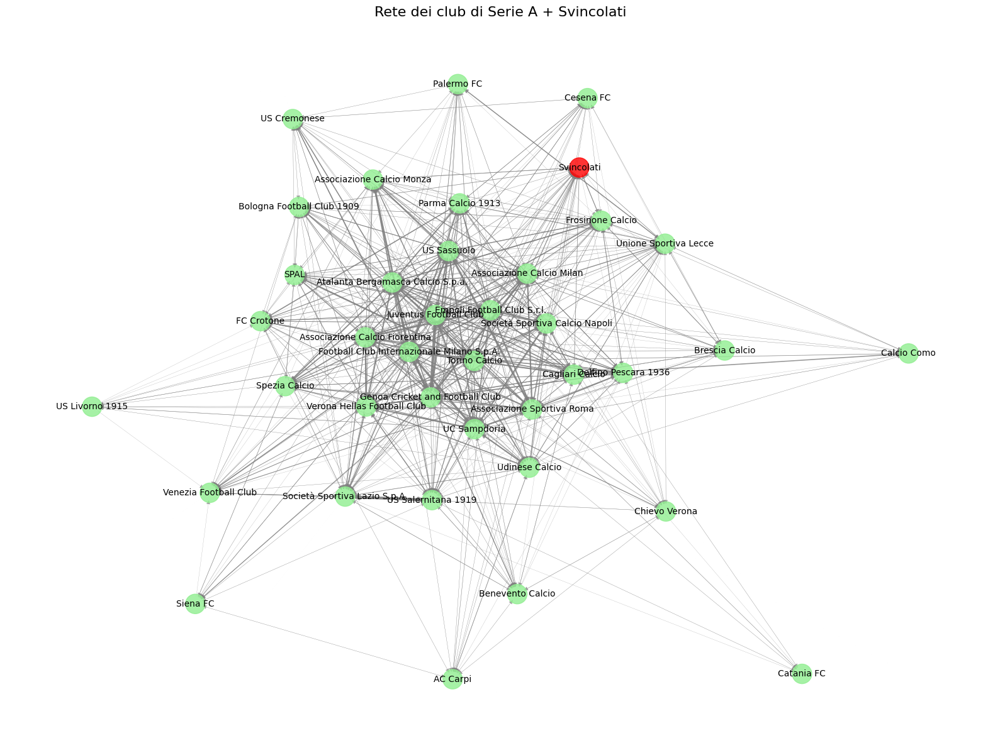


=== Fine della visualizzazione del grafo dei trasferimenti italiani e svincolati ===

=== Metriche del grafo ===
Numero di nodi: 39
Numero di archi: 823
Densità del grafo: 0.555
Clustering medio: 0.725
Raggio del grafo: 2
Diametro del grafo: 2
Grado dei nodi: {'Svincolati': 39, 'Società Sportiva Lazio S.p.A.': 47, 'US Salernitana 1919': 48, 'Associazione Calcio Monza': 43, 'Juventus Football Club': 63, 'Associazione Calcio Fiorentina': 56, 'Empoli Football Club S.r.l.': 57, 'UC Sampdoria': 53, 'Frosinone Calcio': 46, 'Calcio Como': 20, 'Genoa Cricket and Football Club': 60, 'Atalanta Bergamasca Calcio S.p.a.': 60, 'Unione Sportiva Lecce': 46, 'Bologna Football Club 1909': 42, 'Verona Hellas Football Club': 57, 'US Sassuolo': 53, 'Associazione Calcio Milan': 57, 'Associazione Sportiva Roma': 48, 'Cagliari Calcio': 46, 'Società Sportiva Calcio Napoli': 50, 'Torino Calcio': 58, 'Spezia Calcio': 41, 'Palermo FC': 28, 'Venezia Football Club': 33, 'Udinese Calcio': 51, 'Football Club Intern

In [52]:
# ------------------------------------------------------
# 10. VISUALIZZAZIONE DEL GRAFO DEI TRASFERIMENTI ITALIANI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 10. Visualizzazione del grafo dei trasferimenti italiani e svincolati ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_italian_svincolati, seed=42, k=0.5, iterations=200)

node_colors = ['lightgreen' if node != "Svincolati" else 'red' for node in G_italian_svincolati.nodes()]
# Disegnare i nodi
nx.draw_networkx_nodes(G_italian_svincolati, pos, node_size=500, node_color=node_colors, alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G_italian_svincolati, 'weight').items())
nx.draw_networkx_edges(G_italian_svincolati, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club italiani e svincolati)
nx.draw_networkx_labels(G_italian_svincolati, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei club di Serie A + Svincolati", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo dei trasferimenti italiani e svincolati ===")

calculate_and_print_graph_metrics(G_italian_svincolati)

In [53]:
# ------------------------------------------------------
# 7. FILTRARE I CLUB INGLESI E I TRASFERIMENTI INGLESI
# ------------------------------------------------------

print("\n=== 7. Filtraggio dei trasferimenti nel campionato inglese ===")

# Filtriamo i club inglesi (domestic_competition_id == 'GB1')
english_clubs = clubs[clubs["domestic_competition_id"] == "GB1"]
english_club_ids = english_clubs["club_id"].unique()

print(f"\nNumero di club inglesi: {len(english_clubs)}")
print(f"ID dei club inglesi: {english_club_ids[:5]}")  # Mostriamo i primi 5 club

# Filtriamo i trasferimenti che coinvolgono solo club inglesi
english_transfers = transfers[
    (transfers["from_club_id"].isin(english_club_ids)) &
    (transfers["to_club_id"].isin(english_club_ids))
]

print(f"\nNumero di trasferimenti avvenuti tra club inglesi: {len(english_transfers)}")
print(english_transfers.head())


=== 7. Filtraggio dei trasferimenti nel campionato inglese ===

Numero di club inglesi: 37
ID dei club inglesi: [ 148  603  989 3008   31]

Numero di trasferimenti avvenuti tra club inglesi: 1244
     player_id transfer_date transfer_season  from_club_id  to_club_id  \
33      111819    2025-06-30           24/25            11         989   
50      181579    2025-06-30           24/25           703         379   
65      234781    2025-06-30           24/25           180         379   
119     340325    2025-06-30           24/25           931          11   
124     344152    2025-06-30           24/25          1003         873   

    from_club_name    to_club_name  transfer_fee  market_value_in_eur  \
33         Arsenal     Bournemouth           0.0            2000000.0   
50    Nottm Forest        West Ham           0.0           16000000.0   
65     Southampton        West Ham           0.0            8000000.0   
119         Fulham         Arsenal           0.0           1800000

In [54]:
# ------------------------------------------------------
# 8. CREAZIONE DEL GRAFO CON I TRASFERIMENTI INGLESI
# ------------------------------------------------------
print("\n=== 8. Creazione del grafo per i trasferimenti inglesi ===")

# Creiamo un grafo per i trasferimenti inglesi
G_english = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti inglesi
for idx, row in english_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    if G_english.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti)
        G_english[from_club][to_club]["weight"] += 1
        G_english[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
    else:
        # Aggiungi l'arco con peso 1
        G_english.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))

print(f"\nNumero di nodi (club inglesi) nel grafo: {G_english.number_of_nodes()}")
print(f"Numero di archi (trasferimenti inglesi) nel grafo: {G_english.number_of_edges()}")


=== 8. Creazione del grafo per i trasferimenti inglesi ===

Numero di nodi (club inglesi) nel grafo: 37
Numero di archi (trasferimenti inglesi) nel grafo: 701


In [55]:
# ------------------------------------------------------
# 9. RILABEL DEI NODI CON I NOMI DEI CLUB INGLESI
# ------------------------------------------------------
print("\n=== 9. Rilabel dei nodi con i nomi dei club inglesi ===")

# Rilabel dei nodi nel grafo con i nomi dei club inglesi
nx.relabel_nodes(G_english, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_english.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")


=== 9. Rilabel dei nodi con i nomi dei club inglesi ===

Esempio di nodi con nome (primi 5):
Arsenal Football Club -> {}
Association Football Club Bournemouth -> {}
Nottingham Forest Football Club -> {}
West Ham United Football Club -> {}
Southampton Football Club -> {}



=== 10. Visualizzazione del grafo dei trasferimenti inglesi ===


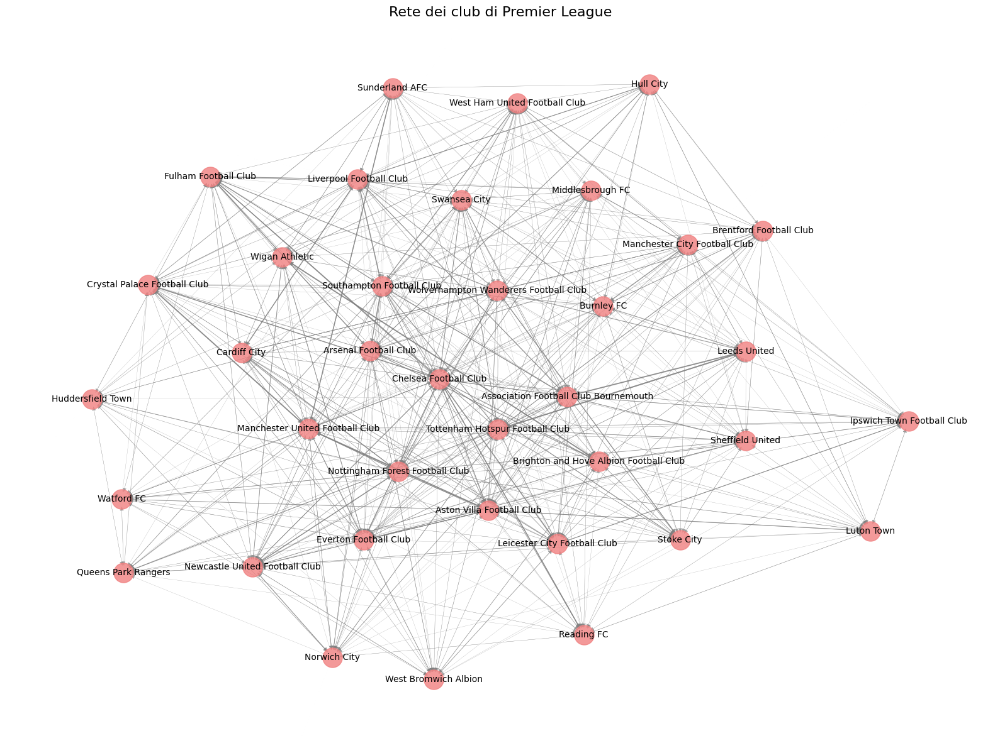


=== Fine della visualizzazione del grafo dei trasferimenti inglesi ===

=== Metriche del grafo ===
Numero di nodi: 37
Numero di archi: 701
Densità del grafo: 0.526
Clustering medio: 0.651
Raggio del grafo: 2
Diametro del grafo: 2
Grado dei nodi: {'Arsenal Football Club': 50, 'Association Football Club Bournemouth': 42, 'Nottingham Forest Football Club': 41, 'West Ham United Football Club': 43, 'Southampton Football Club': 41, 'Fulham Football Club': 39, 'Leicester City Football Club': 49, 'Crystal Palace Football Club': 37, 'Ipswich Town Football Club': 29, 'Manchester City Football Club': 38, 'Chelsea Football Club': 54, 'Manchester United Football Club': 46, 'Everton Football Club': 47, 'Leeds United': 32, 'Brighton and Hove Albion Football Club': 39, 'Aston Villa Football Club': 49, 'Wigan Athletic': 34, 'Liverpool Football Club': 42, 'Wolverhampton Wanderers Football Club': 46, 'Newcastle United Football Club': 43, 'Luton Town': 29, 'Burnley FC': 33, 'Sunderland AFC': 30, 'Queens 

In [56]:
# ------------------------------------------------------
# 10. VISUALIZZAZIONE DEL GRAFO DEI TRASFERIMENTI INGLESI
# ------------------------------------------------------
print("\n=== 10. Visualizzazione del grafo dei trasferimenti inglesi ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_english, seed=42, k=0.5, iterations=200)

# Disegnare i nodi
nx.draw_networkx_nodes(G_english, pos, node_size=500, node_color='lightcoral', alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G_english, 'weight').items())
nx.draw_networkx_edges(G_english, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club inglesi)
nx.draw_networkx_labels(G_english, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei club di Premier League", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo dei trasferimenti inglesi ===")

calculate_and_print_graph_metrics(G_english)


=== 7 Filtraggio dei trasferimenti tra club inglesi e Svincolati ===

Numero di club inglesi: 37
ID dei club inglesi: [ 148  603  989 3008   31]

Numero di trasferimenti che coinvolgono club inglesi e svincolati: 1336
     player_id transfer_date transfer_season  from_club_id  to_club_id  \
33      111819    2025-06-30           24/25            11         989   
50      181579    2025-06-30           24/25           703         379   
65      234781    2025-06-30           24/25           180         379   
119     340325    2025-06-30           24/25           931          11   
124     344152    2025-06-30           24/25          1003         873   

    from_club_name    to_club_name  transfer_fee  market_value_in_eur  \
33         Arsenal     Bournemouth           0.0            2000000.0   
50    Nottm Forest        West Ham           0.0           16000000.0   
65     Southampton        West Ham           0.0            8000000.0   
119         Fulham         Arsenal          

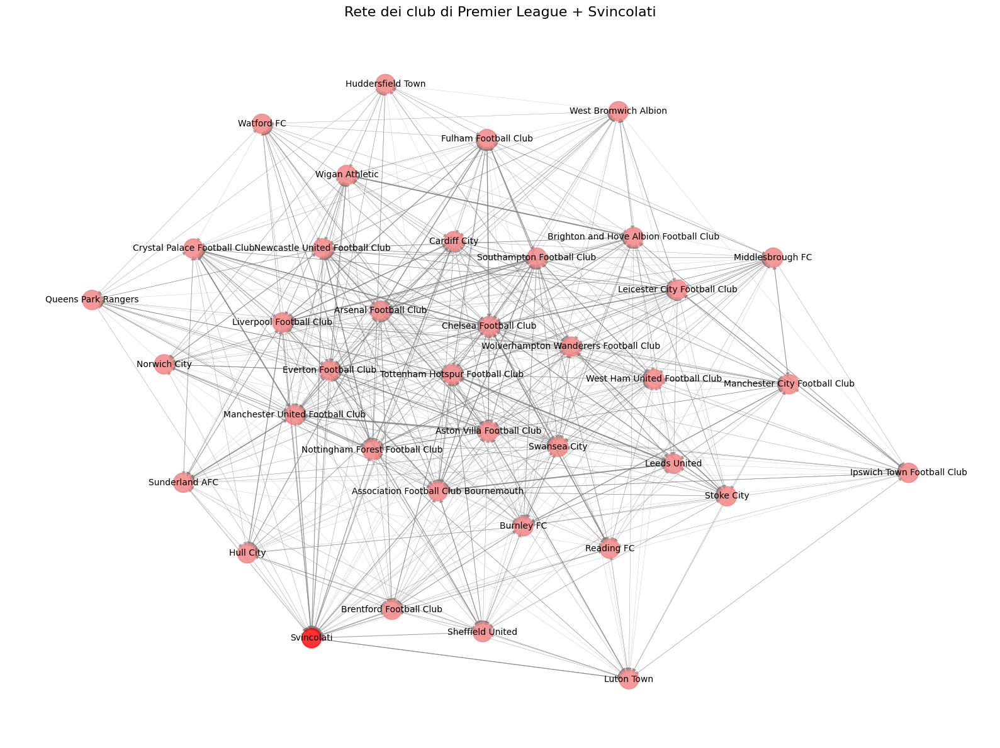


=== Fine della visualizzazione del grafo dei trasferimenti inglesi e svincolati ===

=== Metriche del grafo ===
Numero di nodi: 38
Numero di archi: 746
Densità del grafo: 0.531
Clustering medio: 0.672
Raggio del grafo: 2
Diametro del grafo: 2
Grado dei nodi: {'Svincolati': 45, 'Arsenal Football Club': 51, 'Association Football Club Bournemouth': 43, 'Nottingham Forest Football Club': 43, 'West Ham United Football Club': 44, 'Southampton Football Club': 42, 'Fulham Football Club': 40, 'Leicester City Football Club': 50, 'Crystal Palace Football Club': 38, 'Ipswich Town Football Club': 30, 'Manchester City Football Club': 38, 'Chelsea Football Club': 55, 'Manchester United Football Club': 47, 'Everton Football Club': 48, 'Leeds United': 33, 'Brighton and Hove Albion Football Club': 40, 'Aston Villa Football Club': 50, 'Wigan Athletic': 36, 'Liverpool Football Club': 43, 'Wolverhampton Wanderers Football Club': 47, 'Newcastle United Football Club': 45, 'Luton Town': 31, 'Burnley FC': 34,

In [57]:
# ------------------------------------------------------
# 7 FILTRARE I TRASFERIMENTI TRA CLUB INGLESI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 7 Filtraggio dei trasferimenti tra club inglesi e Svincolati ===")

# Filtriamo i club inglesi (domestic_competition_id == 'GB1')
english_clubs = clubs[clubs["domestic_competition_id"] == "GB1"]
english_club_ids = english_clubs["club_id"].unique()

print(f"\nNumero di club inglesi: {len(english_clubs)}")
print(f"ID dei club inglesi: {english_club_ids[:5]}")  # Mostriamo i primi 5 club

# Filtriamo i trasferimenti che coinvolgono:
# - trasferimenti tra club inglesi
# - trasferimenti tra un club inglese e "Svincolati" (515)
english_svincolati_transfers = transfers[
    ((transfers["from_club_id"].isin(english_club_ids)) & (transfers["to_club_id"] == 515)) | 
    ((transfers["to_club_id"].isin(english_club_ids)) & (transfers["from_club_id"] == 515)) |
    ((transfers["from_club_id"].isin(english_club_ids)) & (transfers["to_club_id"].isin(english_club_ids)))
]

print(f"\nNumero di trasferimenti che coinvolgono club inglesi e svincolati: {len(english_svincolati_transfers)}")
print(english_svincolati_transfers.head())

# ------------------------------------------------------
# 8. CREAZIONE DEL GRAFO CON I TRASFERIMENTI INGLESI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 8. Creazione del grafo per i trasferimenti inglesi e svincolati ===")

# Creiamo un grafo per i trasferimenti inglesi e svincolati
G_english_svincolati = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti inglesi e svincolati
for idx, row in english_svincolati_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    # Se il club di origine o destinazione è 515 (svincolati), lo sostituiamo con "Svincolati"
    if from_club == 515:
        from_club = "Svincolati"
    if to_club == 515:
        to_club = "Svincolati"

    if G_english_svincolati.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti)
        G_english_svincolati[from_club][to_club]["weight"] += 1
        G_english_svincolati[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
    else:
        # Aggiungi l'arco con peso 1
        G_english_svincolati.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))

print(f"\nNumero di nodi (club inglesi e svincolati) nel grafo: {G_english_svincolati.number_of_nodes()}")
print(f"Numero di archi (trasferimenti inglesi e svincolati) nel grafo: {G_english_svincolati.number_of_edges()}")

# ------------------------------------------------------
# 9. RILABEL DEI NODI CON I NOMI DEI CLUB INGLESI
# ------------------------------------------------------

print("\n=== 9. Rilabel dei nodi con i nomi dei club inglesi e svincolati ===")

# Rilabel dei nodi nel grafo con i nomi dei club inglesi (compreso "Svincolati")
nx.relabel_nodes(G_english_svincolati, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_english_svincolati.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")

# ------------------------------------------------------
# 10. VISUALIZZAZIONE DEL GRAFO DEI TRASFERIMENTI INGLESI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 10. Visualizzazione del grafo dei trasferimenti inglesi e svincolati ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_english_svincolati, seed=42, k=0.5, iterations=200)

# Disegnare i nodi, evidenziando il nodo "Svincolati"
# Nodo "Svincolati" in un colore specifico
node_colors = ['lightcoral' if node != "Svincolati" else 'red' for node in G_english_svincolati.nodes()]

# Disegnare i nodi
nx.draw_networkx_nodes(G_english_svincolati, pos, node_size=500, node_color=node_colors, alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G_english_svincolati, 'weight').items())
nx.draw_networkx_edges(G_english_svincolati, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club inglesi e svincolati)
nx.draw_networkx_labels(G_english_svincolati, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei club di Premier League + Svincolati", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo dei trasferimenti inglesi e svincolati ===")

calculate_and_print_graph_metrics(G_english_svincolati)

In [58]:
# ------------------------------------------------------
# 7. FILTRARE I CLUB SPAGNOLI E I TRASFERIMENTI SPAGNOLI
# ------------------------------------------------------

print("\n=== 7. Filtraggio dei trasferimenti nel campionato spagnolo ===")

# Filtriamo i club spagnoli (domestic_competition_id == 'ES1')
spanish_clubs = clubs[clubs["domestic_competition_id"] == "ES1"]
spanish_club_ids = spanish_clubs["club_id"].unique()

print(f"\nNumero di club spagnoli: {len(spanish_clubs)}")
print(f"ID dei club spagnoli: {spanish_club_ids[:5]}")  # Mostriamo i primi 5 club

# Filtriamo i trasferimenti che coinvolgono solo club spagnoli
spanish_transfers = transfers[
    (transfers["from_club_id"].isin(spanish_club_ids)) &
    (transfers["to_club_id"].isin(spanish_club_ids))
]

print(f"\nNumero di trasferimenti avvenuti tra club spagnoli: {len(spanish_transfers)}")
print(spanish_transfers.head())


=== 7. Filtraggio dei trasferimenti nel campionato spagnolo ===

Numero di club spagnoli: 32
ID dei club spagnoli: [5358  993 1108   13  131]

Numero di trasferimenti avvenuti tra club spagnoli: 1070
    player_id transfer_date transfer_season  from_club_id  to_club_id  \
28      66100    2025-06-30           24/25         12321         131   
39     148928    2025-06-30           24/25           368          13   
47     177847    2025-06-30           24/25           472         368   
51     182904    2025-06-30           24/25            13         131   
79     263727    2025-06-30           24/25          1108         368   

     from_club_name     to_club_name  transfer_fee  market_value_in_eur  \
28           Girona        Barcelona           0.0            2000000.0   
39       Sevilla FC  Atlético Madrid           0.0            5000000.0   
47    UD Las Palmas       Sevilla FC           0.0            2000000.0   
51  Atlético Madrid        Barcelona           0.0          

In [59]:
# ------------------------------------------------------
# 8. CREAZIONE DEL GRAFO CON I TRASFERIMENTI SPAGNOLI
# ------------------------------------------------------
print("\n=== 8. Creazione del grafo per i trasferimenti spagnoli ===")

# Creiamo un grafo per i trasferimenti spagnoli
G_spanish = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti spagnoli
for idx, row in spanish_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    if G_spanish.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti)
        G_spanish[from_club][to_club]["weight"] += 1
        G_spanish[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
    else:
        # Aggiungi l'arco con peso 1
        G_spanish.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))

print(f"\nNumero di nodi (club spagnoli) nel grafo: {G_spanish.number_of_nodes()}")
print(f"Numero di archi (trasferimenti spagnoli) nel grafo: {G_spanish.number_of_edges()}")



=== 8. Creazione del grafo per i trasferimenti spagnoli ===

Numero di nodi (club spagnoli) nel grafo: 32
Numero di archi (trasferimenti spagnoli) nel grafo: 519



=== 9. Rilabel dei nodi con i nomi dei club spagnoli ===

Esempio di nodi con nome (primi 5):
Girona Fútbol Club S. A. D. -> {}
Futbol Club Barcelona -> {}
Sevilla Fútbol Club S.A.D. -> {}
Club Atlético de Madrid S.A.D. -> {}
Unión Deportiva Las Palmas S.A.D. -> {}

=== 10. Visualizzazione del grafo dei trasferimenti spagnoli ===


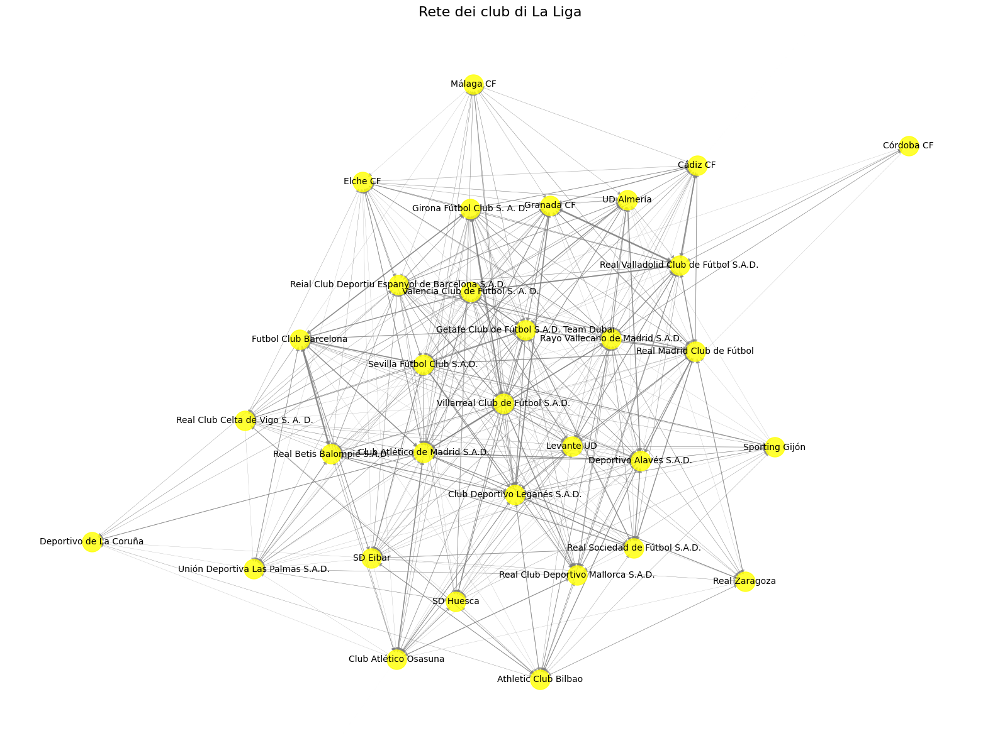


=== Fine della visualizzazione del grafo dei trasferimenti spagnoli ===

=== Metriche del grafo ===
Numero di nodi: 32
Numero di archi: 519
Densità del grafo: 0.523
Clustering medio: 0.668
Raggio del grafo: 2
Diametro del grafo: 3
Grado dei nodi: {'Girona Fútbol Club S. A. D.': 40, 'Futbol Club Barcelona': 31, 'Sevilla Fútbol Club S.A.D.': 42, 'Club Atlético de Madrid S.A.D.': 46, 'Unión Deportiva Las Palmas S.A.D.': 27, 'Deportivo Alavés S.A.D.': 41, 'Rayo Vallecano de Madrid S.A.D.': 41, 'Granada CF': 35, 'Real Club Celta de Vigo S. A. D.': 30, 'Real Betis Balompié S.A.D.': 30, 'Getafe Club de Fútbol S.A.D. Team Dubai': 42, 'UD Almería': 31, 'Real Valladolid Club de Fútbol S.A.D.': 30, 'Valencia Club de Fútbol S. A. D.': 37, 'Real Club Deportivo Mallorca S.A.D.': 34, 'Athletic Club Bilbao': 28, 'Villarreal Club de Fútbol S.A.D.': 44, 'Levante UD': 39, 'Club Deportivo Leganés S.A.D.': 41, 'SD Eibar': 32, 'Reial Club Deportiu Espanyol de Barcelona S.A.D.': 44, 'Real Madrid Club de Fút

In [60]:
# ------------------------------------------------------
# 9. RILABEL DEI NODI CON I NOMI DEI CLUB SPAGNOLI
# ------------------------------------------------------
print("\n=== 9. Rilabel dei nodi con i nomi dei club spagnoli ===")

# Rilabel dei nodi nel grafo con i nomi dei club spagnoli
nx.relabel_nodes(G_spanish, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_spanish.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")

# ------------------------------------------------------
# 10. VISUALIZZAZIONE DEL GRAFO DEI TRASFERIMENTI SPAGNOLI
# ------------------------------------------------------
print("\n=== 10. Visualizzazione del grafo dei trasferimenti spagnoli ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_spanish, seed=42, k=0.5, iterations=200)

# Disegnare i nodi
nx.draw_networkx_nodes(G_spanish, pos, node_size=500, node_color='yellow', alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G_spanish, 'weight').items())
nx.draw_networkx_edges(G_spanish, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club spagnoli)
nx.draw_networkx_labels(G_spanish, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei club di La Liga", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo dei trasferimenti spagnoli ===")

calculate_and_print_graph_metrics(G_spanish)


=== 7 Filtraggio dei trasferimenti tra club spagnoli e Svincolati ===

Numero di club spagnoli: 32
ID dei club spagnoli: [5358  993 1108   13  131]

Numero di trasferimenti che coinvolgono club spagnoli e svincolati: 1123
    player_id transfer_date transfer_season  from_club_id  to_club_id  \
28      66100    2025-06-30           24/25         12321         131   
39     148928    2025-06-30           24/25           368          13   
47     177847    2025-06-30           24/25           472         368   
51     182904    2025-06-30           24/25            13         131   
79     263727    2025-06-30           24/25          1108         368   

     from_club_name     to_club_name  transfer_fee  market_value_in_eur  \
28           Girona        Barcelona           0.0            2000000.0   
39       Sevilla FC  Atlético Madrid           0.0            5000000.0   
47    UD Las Palmas       Sevilla FC           0.0            2000000.0   
51  Atlético Madrid        Barcelona  

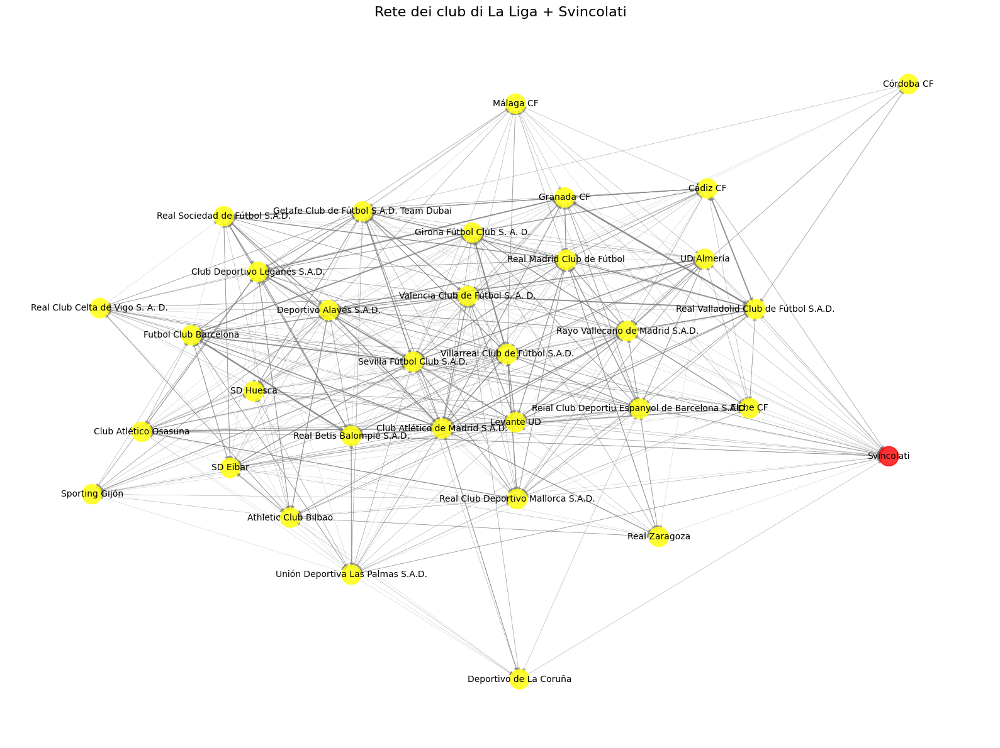


=== Fine della visualizzazione del grafo dei trasferimenti spagnoli e svincolati ===

=== Metriche del grafo ===
Numero di nodi: 33
Numero di archi: 552
Densità del grafo: 0.523
Clustering medio: 0.675
Raggio del grafo: 2
Diametro del grafo: 3
Grado dei nodi: {'Svincolati': 33, 'Girona Fútbol Club S. A. D.': 42, 'Futbol Club Barcelona': 31, 'Sevilla Fútbol Club S.A.D.': 43, 'Club Atlético de Madrid S.A.D.': 47, 'Unión Deportiva Las Palmas S.A.D.': 29, 'Deportivo Alavés S.A.D.': 41, 'Rayo Vallecano de Madrid S.A.D.': 43, 'Granada CF': 36, 'Real Club Celta de Vigo S. A. D.': 30, 'Real Betis Balompié S.A.D.': 32, 'Getafe Club de Fútbol S.A.D. Team Dubai': 43, 'UD Almería': 33, 'Real Valladolid Club de Fútbol S.A.D.': 32, 'Valencia Club de Fútbol S. A. D.': 38, 'Real Club Deportivo Mallorca S.A.D.': 35, 'Athletic Club Bilbao': 29, 'Villarreal Club de Fútbol S.A.D.': 46, 'Levante UD': 40, 'Club Deportivo Leganés S.A.D.': 42, 'SD Eibar': 32, 'Reial Club Deportiu Espanyol de Barcelona S.A.D.

In [61]:
# ------------------------------------------------------
# 7 FILTRARE I TRASFERIMENTI TRA CLUB SPAGNOLI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 7 Filtraggio dei trasferimenti tra club spagnoli e Svincolati ===")

# Filtriamo i club spagnoli (domestic_competition_id == 'ES1')
spanish_clubs = clubs[clubs["domestic_competition_id"] == "ES1"]
spanish_club_ids = spanish_clubs["club_id"].unique()

print(f"\nNumero di club spagnoli: {len(spanish_clubs)}")
print(f"ID dei club spagnoli: {spanish_club_ids[:5]}")  # Mostriamo i primi 5 club

# Filtriamo i trasferimenti che coinvolgono:
# - trasferimenti tra club spagnoli
# - trasferimenti tra un club spagnolo e "Svincolati" (515)
spanish_svincolati_transfers = transfers[
    ((transfers["from_club_id"].isin(spanish_club_ids)) & (transfers["to_club_id"] == 515)) | 
    ((transfers["to_club_id"].isin(spanish_club_ids)) & (transfers["from_club_id"] == 515)) |
    ((transfers["from_club_id"].isin(spanish_club_ids)) & (transfers["to_club_id"].isin(spanish_club_ids)))
]

print(f"\nNumero di trasferimenti che coinvolgono club spagnoli e svincolati: {len(spanish_svincolati_transfers)}")
print(spanish_svincolati_transfers.head())

# ------------------------------------------------------
# 8. CREAZIONE DEL GRAFO CON I TRASFERIMENTI SPAGNOLI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 8. Creazione del grafo per i trasferimenti spagnoli e svincolati ===")

# Creiamo un grafo per i trasferimenti spagnoli e svincolati
G_spanish_svincolati = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti spagnoli e svincolati
for idx, row in spanish_svincolati_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    # Se il club di origine o destinazione è 515 (svincolati), lo sostituiamo con "Svincolati"
    if from_club == 515:
        from_club = "Svincolati"
    if to_club == 515:
        to_club = "Svincolati"

    if G_spanish_svincolati.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti)
        G_spanish_svincolati[from_club][to_club]["weight"] += 1
        G_spanish_svincolati[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
    else:
        # Aggiungi l'arco con peso 1
        G_spanish_svincolati.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))

print(f"\nNumero di nodi (club spagnoli e svincolati) nel grafo: {G_spanish_svincolati.number_of_nodes()}")
print(f"Numero di archi (trasferimenti spagnoli e svincolati) nel grafo: {G_spanish_svincolati.number_of_edges()}")

# ------------------------------------------------------
# 9. RILABEL DEI NODI CON I NOMI DEI CLUB SPAGNOLI
# ------------------------------------------------------

print("\n=== 9. Rilabel dei nodi con i nomi dei club spagnoli e svincolati ===")

# Rilabel dei nodi nel grafo con i nomi dei club spagnoli (compreso "Svincolati")
nx.relabel_nodes(G_spanish_svincolati, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_spanish_svincolati.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")

# ------------------------------------------------------
# 10. VISUALIZZAZIONE DEL GRAFO DEI TRASFERIMENTI SPAGNOLI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 10. Visualizzazione del grafo dei trasferimenti spagnoli e svincolati ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_spanish_svincolati, seed=42, k=0.5, iterations=200)

# Disegnare i nodi, evidenziando il nodo "Svincolati"
# Nodo "Svincolati" in un colore specifico
node_colors = ['yellow' if node != "Svincolati" else 'red' for node in G_spanish_svincolati.nodes()]

# Disegnare i nodi
nx.draw_networkx_nodes(G_spanish_svincolati, pos, node_size=500, node_color=node_colors, alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G_spanish_svincolati, 'weight').items())
nx.draw_networkx_edges(G_spanish_svincolati, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club spagnoli e svincolati)
nx.draw_networkx_labels(G_spanish_svincolati, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei club di La Liga + Svincolati", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo dei trasferimenti spagnoli e svincolati ===")

calculate_and_print_graph_metrics(G_spanish_svincolati)

In [62]:
# ------------------------------------------------------
# 11. VISUALIZZARE I TRASFERIMENTI PIÙ COSTOSI
# ------------------------------------------------------

print("\n=== 11. Visualizzazione dei trasferimenti più costosi ===")

# Definiamo una soglia per i trasferimenti più costosi (ad esempio, top 1% dei trasferimenti più costosi)
cost_threshold = transfers["transfer_fee"].quantile(0.99)  # Prendiamo l'1% dei trasferimenti più costosi

# Filtriamo i trasferimenti con costo maggiore della soglia
expensive_transfers = transfers[transfers["transfer_fee"] >= cost_threshold]

print(f"\nNumero di trasferimenti più costosi (oltre il {cost_threshold} di valore): {len(expensive_transfers)}")
print(expensive_transfers.head())

# Creiamo il grafo per i trasferimenti più costosi
G_expensive = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti più costosi
for idx, row in expensive_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    if G_expensive.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti) e aggiungi il costo
        G_expensive[from_club][to_club]["weight"] += 1
        G_expensive[from_club][to_club]["cost"] += row["transfer_fee"]
    else:
        # Aggiungi l'arco con peso 1
        G_expensive.add_edge(from_club, to_club, weight=1, cost=row["transfer_fee"])

print(f"\nNumero di nodi (club) nel grafo dei trasferimenti costosi: {G_expensive.number_of_nodes()}")
print(f"Numero di archi (trasferimenti costosi) nel grafo: {G_expensive.number_of_edges()}")


=== 11. Visualizzazione dei trasferimenti più costosi ===

Numero di trasferimenti più costosi (oltre il 24198999.999999434 di valore): 509
      player_id transfer_date transfer_season  from_club_id  to_club_id  \
21       486031    2025-07-01           25/26           430         506   
1132     315969    2024-08-30           24/25           985        6195   
1140     340324    2024-08-30           24/25            11         873   
1174     476701    2024-08-30           24/25           583         985   
1236      96341    2024-08-29           24/25           631        6195   

     from_club_name    to_club_name  transfer_fee  market_value_in_eur  \
21       Fiorentina        Juventus    28100000.0           35000000.0   
1132        Man Utd          Napoli    30500000.0           32000000.0   
1140        Arsenal  Crystal Palace    29700000.0           30000000.0   
1174       Paris SG         Man Utd    50000000.0           45000000.0   
1236        Chelsea          Napoli   

In [63]:
# ------------------------------------------------------
# 12. FILTRARE E RILABEL DEI NODI CON I NOMI DEI CLUB PER I TRASFERIMENTI COSTOSI
# ------------------------------------------------------

print("\n=== 12. Filtraggio e rilabel dei nodi con i nomi dei club per i trasferimenti costosi ===")

# Verifica che tutti i club_id nei trasferimenti esistano nel dizionario
valid_transfers = expensive_transfers[
    expensive_transfers["from_club_id"].isin(club_id_to_name.keys()) &
    expensive_transfers["to_club_id"].isin(club_id_to_name.keys())
]

print(f"\nNumero di trasferimenti validi (con club esistenti nel dizionario): {len(valid_transfers)}")

# Creiamo il grafo per i trasferimenti validi (solo club validi)
G_expensive_valid = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti validi
for idx, row in valid_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    if G_expensive_valid.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti) e aggiungi il costo
        G_expensive_valid[from_club][to_club]["weight"] += 1
        G_expensive_valid[from_club][to_club]["cost"] += row["transfer_fee"]
    else:
        # Aggiungi l'arco con peso 1
        G_expensive_valid.add_edge(from_club, to_club, weight=1, cost=row["transfer_fee"])

print(f"\nNumero di nodi (club validi) nel grafo dei trasferimenti costosi: {G_expensive_valid.number_of_nodes()}")
print(f"Numero di archi (trasferimenti costosi) nel grafo: {G_expensive_valid.number_of_edges()}")



=== 12. Filtraggio e rilabel dei nodi con i nomi dei club per i trasferimenti costosi ===

Numero di trasferimenti validi (con club esistenti nel dizionario): 473

Numero di nodi (club validi) nel grafo dei trasferimenti costosi: 109
Numero di archi (trasferimenti costosi) nel grafo: 412


In [64]:
# ------------------------------------------------------
# 13. RILABEL DEI NODI CON I NOMI DEI CLUB
# ------------------------------------------------------
print("\n=== 13. Rilabel dei nodi con i nomi dei club per i trasferimenti costosi validi ===")

# Rilabel dei nodi nel grafo con i nomi dei club validi
nx.relabel_nodes(G_expensive_valid, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_expensive_valid.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")


=== 13. Rilabel dei nodi con i nomi dei club per i trasferimenti costosi validi ===

Esempio di nodi con nome (primi 5):
Associazione Calcio Fiorentina -> {}
Juventus Football Club -> {}
Manchester United Football Club -> {}
Società Sportiva Calcio Napoli -> {}
Arsenal Football Club -> {}



=== 14. Visualizzazione dei trasferimenti più costosi (solo club validi) ===


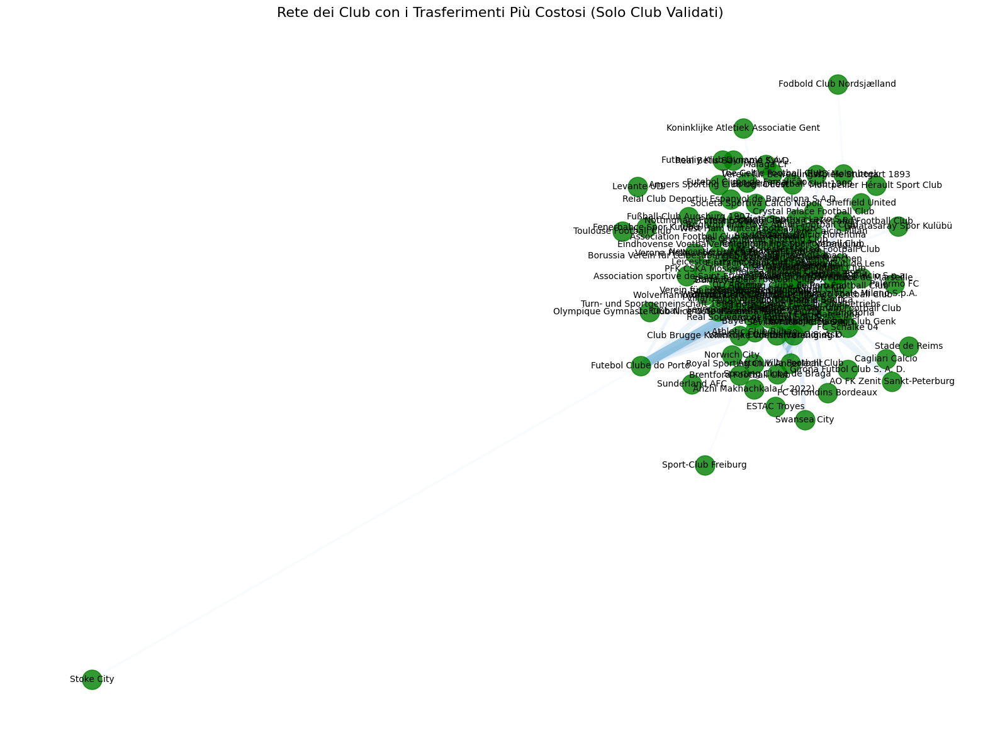


=== Fine della visualizzazione dei trasferimenti più costosi (solo club validi) ===

=== Metriche del grafo ===
Numero di nodi: 109
Numero di archi: 412
Densità del grafo: 0.035
Clustering medio: 0.22
Raggio del grafo: None
Diametro del grafo: None
Grado dei nodi: {'Associazione Calcio Fiorentina': 4, 'Juventus Football Club': 25, 'Manchester United Football Club': 29, 'Società Sportiva Calcio Napoli': 15, 'Arsenal Football Club': 29, 'Crystal Palace Football Club': 5, 'Paris Saint-Germain Football Club': 20, 'Chelsea Football Club': 40, 'Atalanta Bergamasca Calcio S.p.a.': 6, 'Real Sociedad de Fútbol S.A.D.': 5, 'Valencia Club de Fútbol S. A. D.': 8, 'Liverpool Football Club': 15, 'The Celtic Football Club': 2, 'Brighton and Hove Albion Football Club': 13, 'Fenerbahçe Spor Kulübü': 1, 'Fulham Football Club': 8, 'Club Atlético de Madrid S.A.D.': 20, 'Sport Lisboa e Benfica': 14, 'Leeds United': 8, 'Stade Rennais Football Club': 11, 'Futebol Clube do Porto': 12, 'Association Football C

In [65]:
# ------------------------------------------------------
# 14. VISUALIZZAZIONE DEI TRASFERIMENTI COSTOSI VALIDATI
# ------------------------------------------------------
print("\n=== 14. Visualizzazione dei trasferimenti più costosi (solo club validi) ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_expensive_valid, seed=42, k=0.5, iterations=200)

# Disegnare i nodi con colore giallo
nx.draw_networkx_nodes(G_expensive_valid, pos, node_size=500, node_color='green', alpha=0.8)

# Disegnare gli archi (pesati in base al costo del trasferimento)
edges, costs = zip(*nx.get_edge_attributes(G_expensive_valid, 'cost').items())
nx.draw_networkx_edges(
    G_expensive_valid,
    pos,
    edgelist=edges,
    width=[c / 1e7 for c in costs],  # Archi più larghi per i trasferimenti costosi
    edge_color=costs,  # Colore degli archi in base al costo
    edge_cmap=plt.cm.Blues,  # Cambiamo il colore a una mappa di colori (Blu per i trasferimenti più costosi)
    alpha=0.7
)

# Disegnare le etichette dei nodi (nomi dei club)
nx.draw_networkx_labels(G_expensive_valid, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei Club con i Trasferimenti Più Costosi (Solo Club Validati)", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione dei trasferimenti più costosi (solo club validi) ===")

calculate_and_print_graph_metrics(G_expensive_valid)

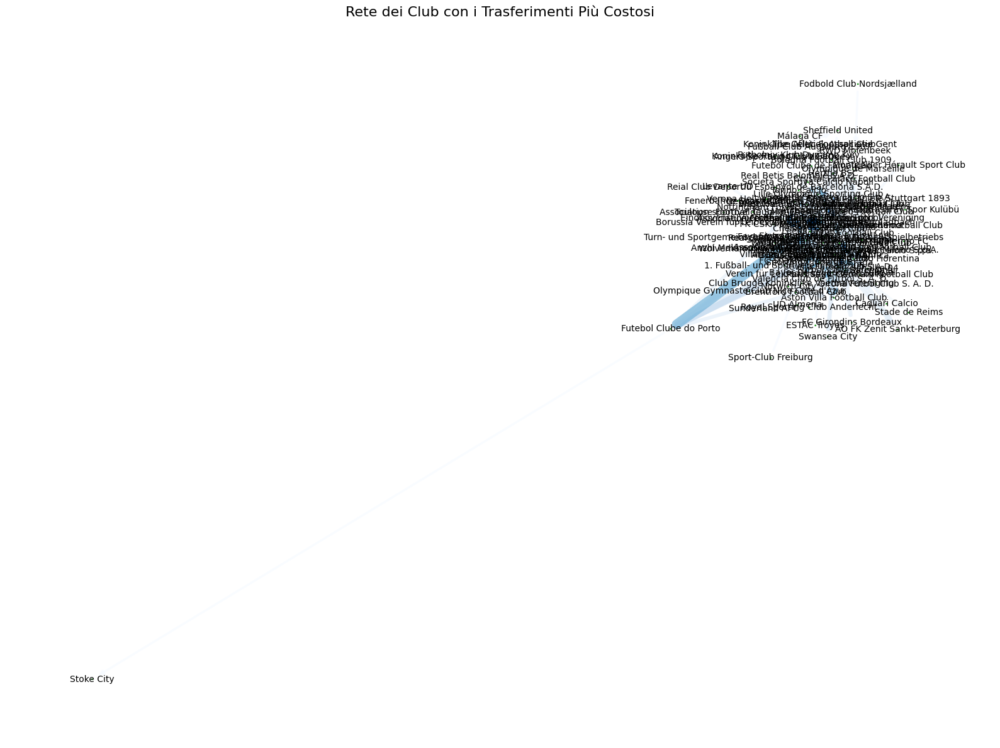

In [66]:
import networkx as nx
import matplotlib.pyplot as plt

# 1. Modifica del Layout
# Proviamo il layout Kamada-Kawai, che solitamente offre una disposizione più naturale
pos = nx.kamada_kawai_layout(G_expensive_valid)

# 2. Aumento delle iterazioni (per una disposizione migliore)
# Questo aiuterà a separare meglio i nodi e fare in modo che il grafo si stabilizzi
pos = nx.spring_layout(G_expensive_valid, seed=42, k=0.5, iterations=300)

# 3. Disegnare il grafo
plt.figure(figsize=(16, 12))

# Disegnare i nodi (dimensioni e colore)
node_sizes = [G_expensive_valid.nodes[node].get("market_value", 1000000) / 1000000 for node in G_expensive_valid.nodes()]
nx.draw_networkx_nodes(G_expensive_valid, pos, node_size=node_sizes, node_color='green', alpha=0.8)

# Disegnare gli archi (larghezza in base al costo dei trasferimenti)
edges, costs = zip(*nx.get_edge_attributes(G_expensive_valid, 'cost').items())
nx.draw_networkx_edges(
    G_expensive_valid,
    pos,
    edgelist=edges,
    width=[c / 1e7 for c in costs],
    edge_color=costs,
    edge_cmap=plt.cm.Blues,
    alpha=0.7
)

# Disegnare le etichette (nomi dei club)
nx.draw_networkx_labels(G_expensive_valid, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei Club con i Trasferimenti Più Costosi", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

In [67]:
# ------------------------------------------------------
# 11. VISUALIZZARE I TRASFERIMENTI PIÙ COSTOSI CON NOME DEL GIOCATORE
# ------------------------------------------------------

print("\n=== 11. Visualizzazione dei trasferimenti più costosi con il nome del giocatore ===")

# Definiamo una soglia per i trasferimenti più costosi (ad esempio, top 0.1% dei trasferimenti più costosi)
cost_threshold = transfers["transfer_fee"].quantile(0.999)  # Prendiamo lo 0.1% dei trasferimenti più costosi

# Filtriamo i trasferimenti con costo maggiore della soglia
expensive_transfers = transfers[transfers["transfer_fee"] >= cost_threshold]

print(f"\nNumero di trasferimenti più costosi (oltre il {cost_threshold} di valore): {len(expensive_transfers)}")
print(expensive_transfers.head(500))

# Creiamo il grafo per i trasferimenti più costosi
G_expensive = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti più costosi, includendo il nome del giocatore
for idx, row in expensive_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    player_name = row["player_name"]  # Nome del giocatore
    
    if G_expensive.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti) e aggiungi il costo
        G_expensive[from_club][to_club]["weight"] += 1
        G_expensive[from_club][to_club]["cost"] += row["transfer_fee"]
        G_expensive[from_club][to_club]["player_name"] = player_name  # Aggiungi nome del giocatore all'arco
    else:
        # Aggiungi l'arco con peso 1
        G_expensive.add_edge(from_club, to_club, weight=1, cost=row["transfer_fee"], player_name=player_name)

print(f"\nNumero di nodi (club) nel grafo dei trasferimenti costosi: {G_expensive.number_of_nodes()}")
print(f"Numero di archi (trasferimenti costosi) nel grafo: {G_expensive.number_of_edges()}")



=== 11. Visualizzazione dei trasferimenti più costosi con il nome del giocatore ===

Numero di trasferimenti più costosi (oltre il 65000000.0 di valore): 54
       player_id transfer_date transfer_season  from_club_id  to_club_id  \
1621      576024    2024-08-12           24/25           281          13   
8453      550550    2024-01-01           23/24           294         583   
9254      487969    2023-09-01           23/24            24         583   
10084     687626    2023-08-14           23/24          1237         631   
10097     132098    2023-08-12           23/24           148          27   
10335     475959    2023-08-05           23/24         23826         281   
10340     610442    2023-08-05           23/24           800         985   
11087     357662    2023-07-15           23/24           379          11   
11613     451276    2023-07-02           23/24         23826          31   
11902     309400    2023-07-01           23/24           631          11   
12240 


=== 13. Visualizzazione dei trasferimenti più costosi con nome del giocatore sugli archi (senza sfondo) ===


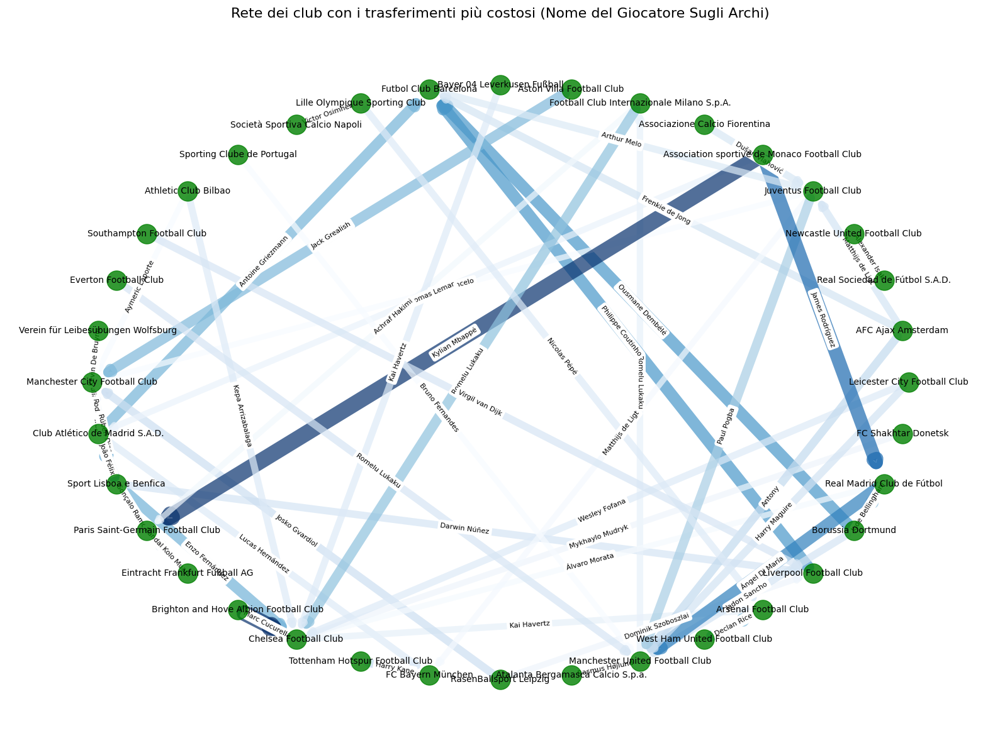


=== Fine della visualizzazione dei trasferimenti più costosi con nome del giocatore sugli archi (senza sfondo) ===

=== Metriche del grafo ===
Numero di nodi: 36
Numero di archi: 51
Densità del grafo: 0.04
Clustering medio: 0.047
Raggio del grafo: None
Diametro del grafo: None
Grado dei nodi: {'Manchester City Football Club': 8, 'Club Atlético de Madrid S.A.D.': 6, 'Sport Lisboa e Benfica': 5, 'Paris Saint-Germain Football Club': 4, 'Eintracht Frankfurt Fußball AG': 1, 'Brighton and Hove Albion Football Club': 1, 'Chelsea Football Club': 9, 'Tottenham Hotspur Football Club': 1, 'FC Bayern München': 3, 'RasenBallsport Leipzig': 2, 'Atalanta Bergamasca Calcio S.p.a.': 1, 'Manchester United Football Club': 9, 'West Ham United Football Club': 1, 'Arsenal Football Club': 3, 'Liverpool Football Club': 4, 'Borussia Dortmund': 3, 'Real Madrid Club de Fútbol': 4, 'FC Shakhtar Donetsk': 1, 'Leicester City Football Club': 2, 'AFC Ajax Amsterdam': 3, 'Real Sociedad de Fútbol S.A.D.': 1, 'Newcastl

In [68]:
# ------------------------------------------------------
# 12. RILABEL DEI NODI CON I NOMI DEI CLUB
# ------------------------------------------------------

# Rilabel dei nodi nel grafo con i nomi dei club
nx.relabel_nodes(G_expensive, club_id_to_name, copy=False)

# ------------------------------------------------------
# 13. VISUALIZZAZIONE DEI TRASFERIMENTI COSTOSI CON NOME DEL GIOCATORE SENZA SFONDO
# ------------------------------------------------------

print("\n=== 13. Visualizzazione dei trasferimenti più costosi con nome del giocatore sugli archi (senza sfondo) ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.shell_layout(G_expensive)

# Disegnare i nodi con colore giallo
nx.draw_networkx_nodes(G_expensive, pos, node_size=500, node_color='green', alpha=0.8)

# Disegnare gli archi (larghezza in base al costo del trasferimento)
edges, costs = zip(*nx.get_edge_attributes(G_expensive, 'cost').items())
nx.draw_networkx_edges(
    G_expensive,
    pos,
    edgelist=edges,
    width=[c / 1e7 for c in costs],
    edge_color=costs,
    edge_cmap=plt.cm.Blues,
    alpha=0.7
)

# Disegnare le etichette dei nodi (nomi dei club)
nx.draw_networkx_labels(G_expensive, pos, font_size=10, font_color='black')

# Disegnare le etichette degli archi (nome del giocatore)
edge_labels = nx.get_edge_attributes(G_expensive, 'player_name')

# Visualizzare le etichette degli archi senza sfondo
nx.draw_networkx_edge_labels(
    G_expensive, 
    pos, 
    edge_labels=edge_labels, 
    font_size=8, 
    font_color='black',  # Colore del testo
    font_weight='normal',  # Nessun bold
    verticalalignment='center',  # Allineamento verticale
    horizontalalignment='center',  # Allineamento orizzontale
    label_pos=0.5,  # Posizione dell'etichetta sugli archi
    ax=plt.gca()  # Usa l'asse corrente per disegnare
)

# Titolo
plt.title("Rete dei club con i trasferimenti più costosi (Nome del Giocatore Sugli Archi)", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione dei trasferimenti più costosi con nome del giocatore sugli archi (senza sfondo) ===")

calculate_and_print_graph_metrics(G_expensive)

## ANALISI DELLE CENTRALITÀ


In [50]:
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import random
import seaborn as sns
import pandas as pd
import numpy as np
from itertools import combinations
from operator import itemgetter

In [51]:
def draw(G, pos, measures, measure_name):
    
    nodes = nx.draw_networkx_nodes(G, pos, node_size=250, cmap=plt.cm.plasma, 
                                   node_color=list(measures.values()),
                                   nodelist=measures.keys())
    nodes.set_norm(mcolors.SymLogNorm(linthresh=0.01, linscale=1))
    
    # labels = nx.draw_networkx_labels(G, pos)
    edges = nx.draw_networkx_edges(G, pos)

    plt.title(measure_name)
    plt.colorbar(nodes)
    plt.axis('off')
    plt.show()

In [52]:
def barplot_nodes(graph,centrality, centrality_name, pos):
    fig, (ax1,ax2) = plt.subplots(1,2,figsize=(24,8))
    fig.suptitle(centrality_name + ' Centrality barplot and nodes highlights')

    #barplot
    x=[]
    y=[]
    cent_sorted = {}
    labels = {}

    centrality = sorted(centrality.items(), key=lambda x:x[1], reverse=True)
    for nodi in centrality:
        cent_sorted.update({nodi[0]: nodi[1]})
    centrality = cent_sorted
    for key, value in cent_sorted.items():
        if len(x) < 10:
            x.append(key)
            y.append(value)
            labels[key]=key
    plt.figure(figsize=(15,10))
    sns.barplot(x=x, y=y, ax=ax1)


    #ottenimento dei colori
    col = []
    x_values = ax1.get_xticklabels()
    x_values = [x.get_text() for x in x_values]
    for i in range(0, len(ax1.patches)):
        colori = []
        colori = list(ax1.patches[i].get_facecolor())
        colori.append(x_values[i])
        col.append(colori)
    
    dizionario_colori = {}
    for colori in col:
        color_HEX = "#" + hex(int(colori[0]*255))[2:].zfill(2) + hex(int(colori[1]*255))[2:].zfill(2) + hex(int(colori[2]*255))[2:].zfill(2)
        dizionario_colori.update({colori[4]: color_HEX})
    print(dizionario_colori)



    #aggiunta nodi colorati in base al barplot
    plt.figure(figsize=(12,8))
    #pos_sample = nx.kamada_kawai_layout(graph)
    pos_sample = pos
    nx.draw(graph, pos_sample, ax=ax2, with_labels = False)
    nx.draw_networkx_nodes(graph, pos_sample, ax=ax2, nodelist=list(dizionario_colori.keys()), node_color=list(dizionario_colori.values()))
    plt.show()

    return dizionario_colori

In [53]:
def important_node_centrality_plot(centrality, df_edge, dizionario_colori):
    x=[]
    y=[]
    cent_sorted = {}
    labels = {}

    centrality = sorted(centrality.items(), key=lambda x:x[1], reverse=True)
    for nodi in centrality:
        cent_sorted.update({nodi[0]: nodi[1]})
    centrality = cent_sorted
    for key, value in cent_sorted.items():
        if len(x) < 10:
            x.append(key)
            y.append(value)
            labels[key]=key
    
    nodes = labels
    edges = []

    for f,t in zip(df_edge["from"].to_list(), df_edge["to"].to_list()):
        if(f in nodes and t in nodes):
            edges.append((f,t))

    graph_deg = nx.DiGraph()
    graph_deg.add_edges_from(edges)
    graph_deg.add_nodes_from(nodes)
    pos_deg = nx.kamada_kawai_layout(graph_deg)

    plt.figure(figsize=(12,8))
    nx.draw(graph_deg, pos_deg, node_size=1000, nodelist=list(dizionario_colori.keys()), with_labels = False, node_color=list(dizionario_colori.values())) 
    nx.draw_networkx_labels(graph_deg, pos_deg, labels)
    plt.show()

In [ ]:
degree = nx.degree_centrality(G)
plt.figure(figsize=(15,10))
sns.displot(list(degree.values()), kde=False, aspect = 2)

In [ ]:
plt.figure(figsize=(12,12))
#pos = nx.kamada_kawai_layout(G)
draw(G, pos, degree, 'Degree Centrality')

In [ ]:
dizionario_colori = barplot_nodes(G, degree, "Degree", pos)

In [ ]:
important_node_centrality_plot(degree, G.nodes(), dizionario_colori)

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.colors as mcolors
import pandas as pd

# Funzione per normalizzare i valori di centralità per una palette coerente
def normalize_centrality_values(values):
    min_val = min(values)
    max_val = max(values)
    return [(val - min_val) / (max_val - min_val) for val in values]

def draw_graph_with_centrality(G, centrality, centrality_name, pos, color_palette):
    # Imposta uno sfondo grigio chiaro per il grafico
    plt.figure(figsize=(12, 8))
    plt.gcf().set_facecolor('lightgrey')

    # Nodo colorato in base alla centralità
    node_colors = [color_palette(centrality[node]) for node in G.nodes()]

    # Ridimensiona i nodi in base alla centralità
    node_sizes = [centrality[node] * 1000 for node in G.nodes()]  # Moltiplica per un fattore per esaltare la differenza

    # Disegnare il grafo
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, alpha=0.8)

    # Disegnare gli archi
    nx.draw_networkx_edges(G, pos, edge_color="gray", width=0.5, alpha=0.6)

    # Aggiungere la colorbar
    sm = plt.cm.ScalarMappable(cmap=color_palette, norm=plt.Normalize(vmin=min(centrality.values()), vmax=max(centrality.values())))
    sm.set_array([])

    # Creare l'asse per la colorbar
    cbar = plt.colorbar(sm, label=f'{centrality_name} Centrality', ax=plt.gca())

    # Aggiungere le etichette dei nodi
    nx.draw_networkx_labels(G, pos, font_size=8, font_color="black")  # Aggiungi i nomi dei nodi

    # Titolo
    plt.title(f"Graph of {centrality_name} Centrality", fontsize=16)
    plt.axis('off')  # Nascondi gli assi
    plt.show()

# Modifica per grafo senza etichette
def draw_graph_without_labels(G, pos, color_palette, centrality, centrality_name):
    # Imposta uno sfondo grigio chiaro per il grafico
    plt.figure(figsize=(12, 8))
    plt.gcf().set_facecolor('lightgrey')

    # Nodo colorato in base alla centralità
    node_colors = [color_palette(centrality[node]) for node in G.nodes()]

    # Ridimensiona i nodi in base alla centralità
    node_sizes = [centrality[node] * 1000 for node in G.nodes()]  # Moltiplica per un fattore per esaltare la differenza

    # Disegnare il grafo senza etichette
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, alpha=0.8)

    # Disegnare gli archi
    nx.draw_networkx_edges(G, pos, edge_color="gray", width=0.5, alpha=0.6)

    # Aggiungere la colorbar
    sm = plt.cm.ScalarMappable(cmap=color_palette, norm=plt.Normalize(vmin=min(centrality.values()), vmax=max(centrality.values())))
    sm.set_array([])

    # Creare l'asse per la colorbar
    cbar = plt.colorbar(sm, label=f'{centrality_name} Centrality', ax=plt.gca())

    # Titolo
    plt.title(f"Graph of {centrality_name} Centrality (No Labels)", fontsize=16)
    plt.axis('off')  # Nascondi gli assi
    plt.show()

# Funzione per il barplot della centralità
def centrality_barplot(G, centrality, centrality_name, color_palette):
    # Ordina i nodi in base alla centralità
    sorted_centrality = dict(sorted(centrality.items(), key=lambda item: item[1], reverse=True))

    # Prendi i primi 10 nodi
    top_nodes = list(sorted_centrality.keys())[:10]
    top_values = [sorted_centrality[node] for node in top_nodes]

    # Normalizziamo i valori di centralità
    normalized_values = normalize_centrality_values(top_values)

    # Assegna colori in base alla normalizzazione
    node_colors = [color_palette(norm_val) for norm_val in normalized_values]

    # Impostare uno sfondo grigio chiaro per il grafico
    plt.style.use('ggplot')  # Usa uno stile di Matplotlib con sfondo grigio chiaro

    # Crea il barplot con i colori mappati
    plt.figure(figsize=(12, 8))
    sns.barplot(x=top_nodes, y=top_values, palette=node_colors)

    # Ruotiamo le etichette sull'asse x
    plt.xticks(rotation=45, ha='right')

    # Titolo e etichette
    plt.title(f"Top 10 Nodes by {centrality_name} Centrality", fontsize=14)
    plt.xlabel("Nodes", fontsize=12)
    plt.ylabel(f"{centrality_name} Centrality", fontsize=12)

    # Miglioramento della visualizzazione
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.tight_layout()
    plt.show()
    
def centrality_distribution(centrality, centrality_name, color_palette):
    values = list(centrality.values())

    # Crea l'istogramma con la distribuzione della centralità
    plt.figure(figsize=(12, 8))
    
    # Aggiungi l'istogramma e la linea KDE con regolazione della larghezza della finestra
    sns.histplot(values, kde=True, color=color_palette(0.7), kde_kws={"bw_adjust": 0.5})

    # Impostiamo il titolo e le etichette
    plt.title(f"Distribution of {centrality_name} Centrality", fontsize=14)
    plt.xlabel(f"{centrality_name} Centrality", fontsize=12)
    plt.ylabel("Frequency", fontsize=12)
    
    # Regola i limiti dell'asse x se necessario
    plt.xlim(0, max(values) * 1.1)  # Aumenta i limiti dell'asse x per migliorare la visualizzazione
    plt.show()

# Funzione principale per eseguire l'analisi delle centralità
def centrality_analysis(G):
    # Calcolo delle diverse centralità
    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G)
    eigenvector_centrality = nx.eigenvector_centrality(G)
    pagerank_centrality = nx.pagerank(G)

    # Definizione delle palette per ogni centralità
    degree_palette = plt.cm.Reds
    betweenness_palette = plt.cm.Blues
    eigenvector_palette = plt.cm.Purples
    pagerank_palette = plt.cm.Greens

    # Posizione dei nodi con layout spring
    pos = nx.spring_layout(G)

    # Visualizzazione degli istogrammi e grafici per ogni centralità
    print("\n=== Degree Centrality ===")
    centrality_barplot(G, degree_centrality, "Degree", degree_palette)
    centrality_distribution(degree_centrality, "Degree", degree_palette)
    draw_graph_with_centrality(G, degree_centrality, "Degree", pos, degree_palette)
    draw_graph_without_labels(G, pos, degree_palette, degree_centrality, "Degree")

    print("\n=== Betweenness Centrality ===")
    centrality_barplot(G, betweenness_centrality, "Betweenness", betweenness_palette)
    centrality_distribution(betweenness_centrality, "Betweenness", betweenness_palette)
    draw_graph_with_centrality(G, betweenness_centrality, "Betweenness", pos, betweenness_palette)
    draw_graph_without_labels(G, pos, betweenness_palette, betweenness_centrality, "Betweenness")

    print("\n=== Eigenvector Centrality ===")
    centrality_barplot(G, eigenvector_centrality, "Eigenvector", eigenvector_palette)
    centrality_distribution(eigenvector_centrality, "Eigenvector", eigenvector_palette)
    draw_graph_with_centrality(G, eigenvector_centrality, "Eigenvector", pos, eigenvector_palette)
    draw_graph_without_labels(G, pos, eigenvector_palette, eigenvector_centrality, "Eigenvector")

    print("\n=== PageRank Centrality ===")
    centrality_barplot(G, pagerank_centrality, "PageRank", pagerank_palette)
    centrality_distribution(pagerank_centrality, "PageRank", pagerank_palette)
    draw_graph_with_centrality(G, pagerank_centrality, "PageRank", pos, pagerank_palette)
    draw_graph_without_labels(G, pos, pagerank_palette, pagerank_centrality, "PageRank")

# Esegui l'analisi delle centralità sul grafo G
centrality_analysis(G)

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.colors as mcolors
import os

# Funzione per normalizzare i valori di centralità per una palette coerente
def normalize_centrality_values(values):
    min_val = min(values)
    max_val = max(values)
    return [(val - min_val) / (max_val - min_val) for val in values]

def draw_graph_with_centrality(G, centrality, centrality_name, pos, color_palette, layout_name):
    # Imposta uno sfondo grigio chiaro per il grafico
    plt.figure(figsize=(12, 8))
    plt.gcf().set_facecolor('lightgrey')

    # Normalizzazione dei valori di centralità
    norm = plt.Normalize(vmin=min(centrality.values()), vmax=max(centrality.values()))
    node_colors = [color_palette(norm(centrality[node])) for node in G.nodes()]

    # Contorno rosso per il nodo "Svincolati", senza bordo per gli altri nodi
    node_edgecolors = ['red' if node == "Svincolati" else 'none' for node in G.nodes()]
    node_linewidths = [2 if node == "Svincolati" else 0 for node in G.nodes()]

    # Disegnare il grafo
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=200, alpha=0.8, edgecolors=node_edgecolors, linewidths=node_linewidths)
    nx.draw_networkx_edges(G, pos, edge_color="gray", width=0.5, alpha=0.6)

    # Aggiungere la colorbar
    sm = plt.cm.ScalarMappable(cmap=color_palette, norm=norm)
    sm.set_array([])

    # Creare l'asse per la colorbar
    cbar = plt.colorbar(sm, label=f'{centrality_name} Centrality', ax=plt.gca())

    # Aggiungere le etichette dei nodi
    nx.draw_networkx_labels(G, pos, font_size=8, font_color="black")

    # Titolo
    plt.title(f"Graph of {centrality_name} Centrality ({layout_name} Layout)", fontsize=16)
    plt.axis('off')  # Nascondi gli assi

    # Salva l'immagine
    plt.savefig(f"{centrality_name}_{layout_name}_with_labels.png")

    # Mostra l'immagine
    plt.show()

def draw_graph_without_labels(G, pos, color_palette, centrality, centrality_name, layout_name):
    # Normalizzazione dei valori di centralità
    norm = plt.Normalize(vmin=min(centrality.values()), vmax=max(centrality.values()))
    node_colors = [color_palette(norm(centrality[node])) for node in G.nodes()]

    # Contorno rosso per il nodo "Svincolati", senza bordo per gli altri nodi
    node_edgecolors = ['red' if node == "Svincolati" else 'none' for node in G.nodes()]
    node_linewidths = [2 if node == "Svincolati" else 0 for node in G.nodes()]

    # Disegnare il grafo senza etichette
    plt.figure(figsize=(12, 8))
    plt.gcf().set_facecolor('lightgrey')

    # Disegnare il grafo senza etichette
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=200, alpha=0.8, edgecolors=node_edgecolors, linewidths=node_linewidths)
    nx.draw_networkx_edges(G, pos, edge_color="gray", width=0.5, alpha=0.6)

    # Aggiungere la colorbar
    sm = plt.cm.ScalarMappable(cmap=color_palette, norm=norm)
    sm.set_array([])

    # Creare l'asse per la colorbar
    cbar = plt.colorbar(sm, label=f'{centrality_name} Centrality', ax=plt.gca())

    # Titolo
    plt.title(f"Graph of {centrality_name} Centrality (No Labels, {layout_name} Layout)", fontsize=16)
    plt.axis('off')  # Nascondi gli assi

    # Salva l'immagine
    plt.savefig(f"{centrality_name}_{layout_name}_no_labels.png")

    # Mostra l'immagine
    plt.show()

# Funzione per il barplot della centralità
def centrality_barplot(G, centrality, centrality_name, color_palette):
    sorted_centrality = dict(sorted(centrality.items(), key=lambda item: item[1], reverse=True))

    top_nodes = list(sorted_centrality.keys())[:10]
    top_values = [sorted_centrality[node] for node in top_nodes]

    # Normalizziamo i valori di centralità
    normalized_values = normalize_centrality_values(top_values)

    node_colors = [color_palette(norm_val) for norm_val in normalized_values]

    plt.style.use('ggplot')

    # Crea il barplot con i colori mappati
    plt.figure(figsize=(12, 8))
    sns.barplot(x=top_nodes, y=top_values, palette=node_colors)
    plt.title(f"Top 10 Nodes by {centrality_name} Centrality", fontsize=14)
    plt.xlabel("Nodes", fontsize=12)
    plt.ylabel(f"{centrality_name} Centrality", fontsize=12)

    plt.xticks(rotation=45, ha='right')
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.tight_layout()

    plt.savefig(f"{centrality_name}_barplot.png")
    plt.show()

def centrality_distribution(centrality, centrality_name, color_palette):
    values = list(centrality.values())

    plt.figure(figsize=(12, 8))
    sns.histplot(values, kde=True, color=color_palette(0.7), kde_kws={"bw_adjust": 0.5})

    plt.title(f"Distribution of {centrality_name} Centrality", fontsize=14)
    plt.xlabel(f"{centrality_name} Centrality", fontsize=12)
    plt.ylabel("Frequency", fontsize=12)

    plt.xlim(0, max(values) * 1.1)

    plt.savefig(f"{centrality_name}_distribution.png")
    plt.show()

def centrality_analysis(G):
    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G)
    eigenvector_centrality = nx.eigenvector_centrality(G)
    pagerank_centrality = nx.pagerank(G)

    degree_palette = plt.cm.Reds
    betweenness_palette = plt.cm.Blues
    eigenvector_palette = plt.cm.Purples
    pagerank_palette = plt.cm.Greens

    pos = nx.spring_layout(G, seed=42)

    layouts = {
        "Spring": nx.spring_layout(G, seed=42),
        "Shell": nx.shell_layout(G),
        "Kamada-Kawai": nx.kamada_kawai_layout(G),
        "Spiral": nx.spiral_layout(G)
    }

    for layout_name, layout_pos in layouts.items():
        print(f"\n=== Degree Centrality ({layout_name} Layout) ===")
        centrality_barplot(G, degree_centrality, "Degree", degree_palette)
        centrality_distribution(degree_centrality, "Degree", degree_palette)
        draw_graph_with_centrality(G, degree_centrality, "Degree", layout_pos, degree_palette, layout_name)
        draw_graph_without_labels(G, layout_pos, degree_palette, degree_centrality, "Degree", layout_name)

        print(f"\n=== Betweenness Centrality ({layout_name} Layout) ===")
        centrality_barplot(G, betweenness_centrality, "Betweenness", betweenness_palette)
        centrality_distribution(betweenness_centrality, "Betweenness", betweenness_palette)
        draw_graph_with_centrality(G, betweenness_centrality, "Betweenness", layout_pos, betweenness_palette, layout_name)
        draw_graph_without_labels(G, layout_pos, betweenness_palette, betweenness_centrality, "Betweenness", layout_name)

        print(f"\n=== Eigenvector Centrality ({layout_name} Layout) ===")
        centrality_barplot(G, eigenvector_centrality, "Eigenvector", eigenvector_palette)
        centrality_distribution(eigenvector_centrality, "Eigenvector", eigenvector_palette)
        draw_graph_with_centrality(G, eigenvector_centrality, "Eigenvector", layout_pos, eigenvector_palette, layout_name)
        draw_graph_without_labels(G, layout_pos, eigenvector_palette, eigenvector_centrality, "Eigenvector", layout_name)

        print(f"\n=== PageRank Centrality ({layout_name} Layout) ===")
        centrality_barplot(G, pagerank_centrality, "PageRank", pagerank_palette)
        centrality_distribution(pagerank_centrality, "PageRank", pagerank_palette)
        draw_graph_with_centrality(G, pagerank_centrality, "PageRank", layout_pos, pagerank_palette, layout_name)
        draw_graph_without_labels(G, layout_pos, pagerank_palette, pagerank_centrality, "PageRank", layout_name)

# Esegui l'analisi delle centralità sul grafo G
centrality_analysis(G)

In [ ]:
centrality_analysis(G_backup)

In [ ]:
centrality_analysis(G_italian)

In [ ]:
centrality_analysis(G_italian_svincolati)

In [ ]:
centrality_analysis(G_english)

In [ ]:
centrality_analysis(G_english_svincolati)

In [ ]:
centrality_analysis(G_spanish)

In [ ]:
centrality_analysis(G_spanish_svincolati)

In [ ]:
centrality_analysis(G_expensive)

# Analisi delle comunità

In [69]:
!pip install python-louvain

Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 24.1.1 -> 24.3.1
[notice] To update, run: /Applications/Xcode.app/Contents/Developer/usr/bin/python3 -m pip install --upgrade pip


{'Svincolati': 0, 'Verein für Bewegungsspiele Stuttgart 1893': 3, 'FC Bayern München': 3, '1. Fußball- und Sportverein Mainz 05': 3, 'Società Sportiva Lazio S.p.A.': 2, 'US Salernitana 1919': 2, 'APO Levadiakos Football Club': 0, 'Panathinaikos Athlitikos Omilos': 0, 'Inverness Caledonian Thistle FC': 1, 'Dundee United Football Club': 1, 'Sport Lisboa e Benfica': 4, 'Beşiktaş Jimnastik Kulübü': 0, 'Brøndby Idrætsforening': 3, 'FK Rostov': 6, 'Fußball-Club Augsburg 1907': 3, 'Stade brestois 29': 7, 'Associazione Calcio Fiorentina': 2, 'Fenerbahçe Spor Kulübü': 0, 'Associazione Calcio Monza': 2, 'Juventus Football Club': 2, 'Association sportive de Monaco Football Club': 7, 'Galatasaray Spor Kulübü': 0, 'Aalborg Boldspilklub': 3, 'Borussia Verein für Leibesübungen 1900 Mönchengladbach': 3, 'Associazione Sportiva Roma': 2, 'Girona Fútbol Club S. A. D.': 4, 'Futbol Club Barcelona': 4, 'Empoli Football Club S.r.l.': 2, 'UC Sampdoria': 2, 'Frosinone Calcio': 2, 'Arsenal Football Club': 1, 'A

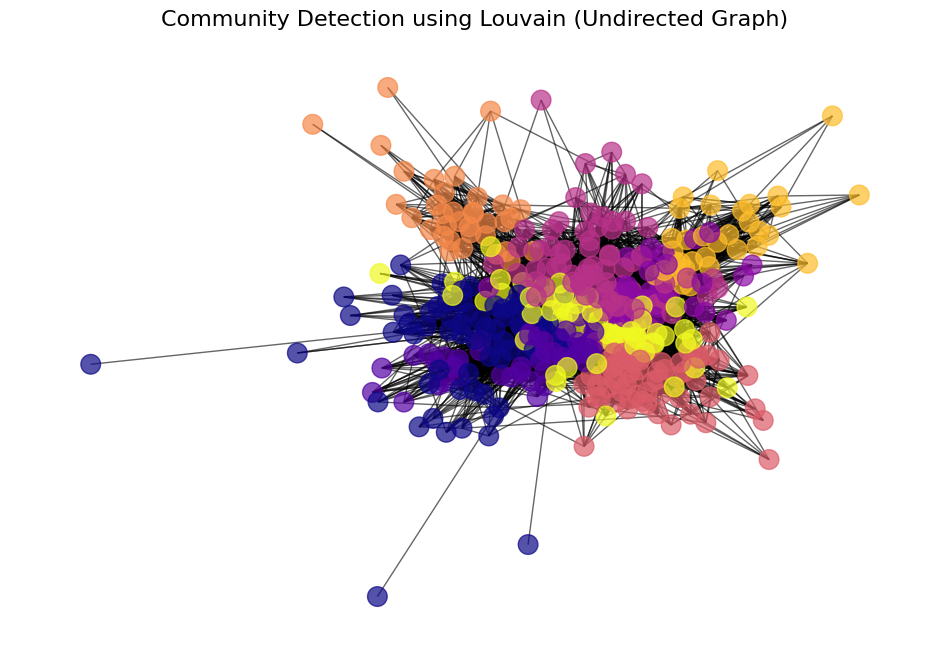

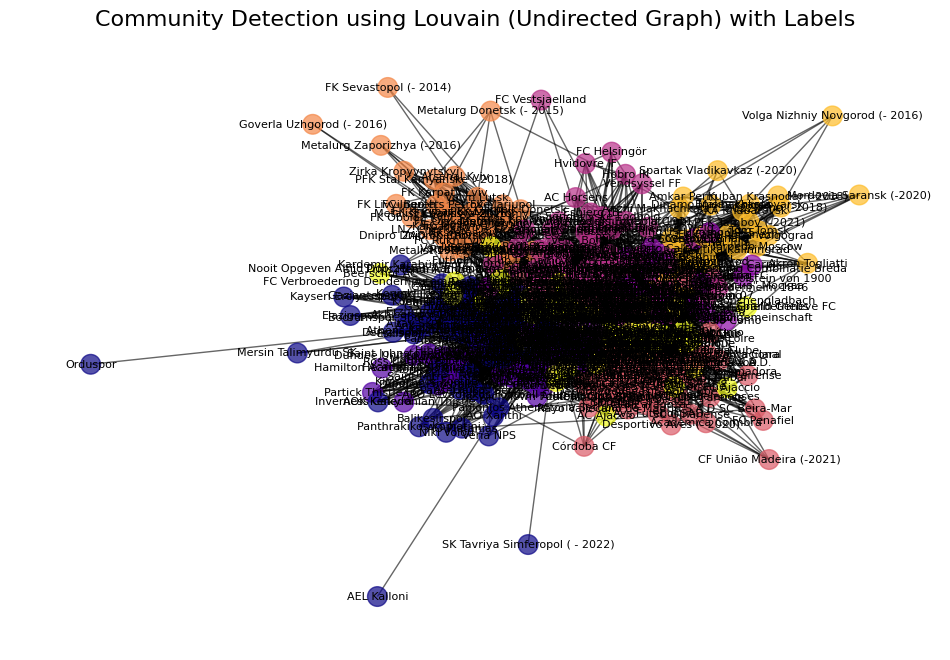

In [176]:
import networkx as nx
import community as community_louvain
import matplotlib.pyplot as plt
import numpy as np
from collections import defaultdict

# Converti il grafo in un grafo non diretto
G_undirected = G.to_undirected()

# Calcola la partizione delle comunità usando Louvain
partition = community_louvain.best_partition(G_undirected)

print(partition)

# Rileva il numero di comunità
num_communities = len(set(partition.values()))
print(f"Numero di comunità trovate: {num_communities}")

# Calcola la cardinalità di ogni comunità
community_sizes = {}
for community in partition.values():
    if community not in community_sizes:
        community_sizes[community] = 0
    community_sizes[community] += 1

# Stampa la cardinalità di ciascuna comunità
print("Cardinalità di ogni comunità:")
for community, size in community_sizes.items():
    print(f"Comunità {community + 1}: {size} membri")

# Aggiungi i colori dei nodi in base alla comunità
# Definiamo una palette di colori
num_communities = len(set(partition.values()))
colors = plt.cm.plasma(np.linspace(0, 1, num_communities))  # Usa la palette 'tab20c'

# Assegna il colore giusto per ogni comunità
node_colors = [colors[partition[node] % num_communities] for node in G_undirected.nodes()]

# Impostiamo il layout consistente
pos = nx.spring_layout(G_undirected, seed=42)  # Lo stesso seme per garantire le stesse posizioni

# Disegnare il grafo con le comunità colorate (senza etichette)
plt.figure(figsize=(12, 8))
nx.draw_networkx_nodes(G_undirected, pos, node_color=node_colors, node_size=200, alpha=0.7)
nx.draw_networkx_edges(G_undirected, pos, alpha=0.6)

# Non disegnare le etichette dei nodi
plt.title("Community Detection using Louvain (Undirected Graph)", fontsize=16)
plt.axis('off')
plt.show()

# Ora anche nel grafico con etichette
plt.figure(figsize=(12, 8))
nx.draw_networkx_nodes(G_undirected, pos, node_color=node_colors, node_size=200, alpha=0.7)
nx.draw_networkx_edges(G_undirected, pos, alpha=0.6)
nx.draw_networkx_labels(G_undirected, pos, font_size=8, font_color="black")

plt.title("Community Detection using Louvain (Undirected Graph) with Labels", fontsize=16)
plt.axis('off')
plt.show()


Comunità 1:
Distribuzione dei campionati:
Svincolati: 1 squadre
GR1: 29 squadre
TR1: 42 squadre
UKR1: 1 squadre


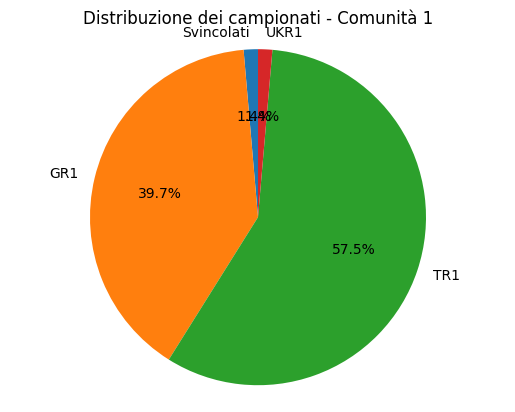


Comunità 4:
Distribuzione dei campionati:
L1: 31 squadre
DK1: 20 squadre
NL1: 28 squadre


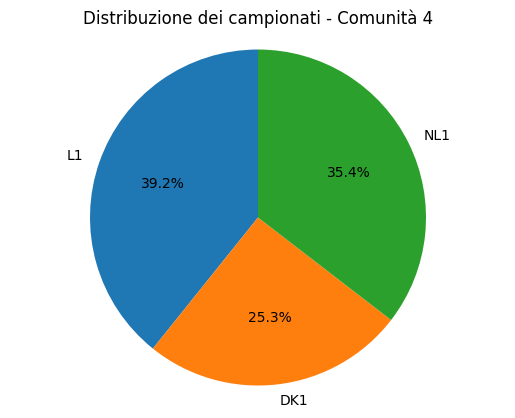


Comunità 3:
Distribuzione dei campionati:
IT1: 38 squadre


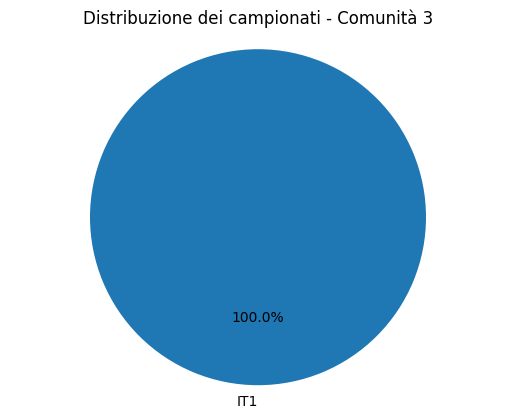


Comunità 2:
Distribuzione dei campionati:
SC1: 16 squadre
GB1: 36 squadre


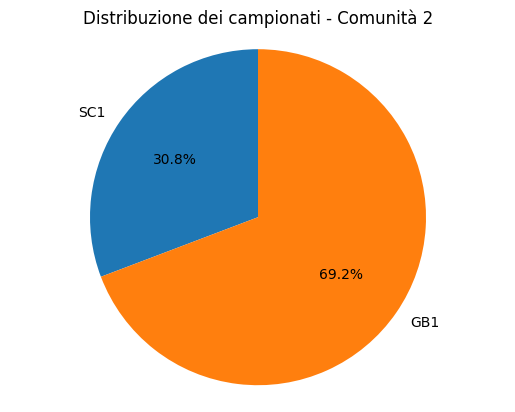


Comunità 5:
Distribuzione dei campionati:
PO1: 34 squadre
ES1: 32 squadre
GB1: 1 squadre


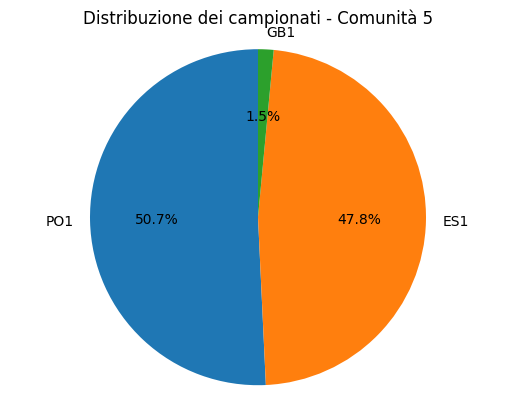


Comunità 7:
Distribuzione dei campionati:
RU1: 34 squadre


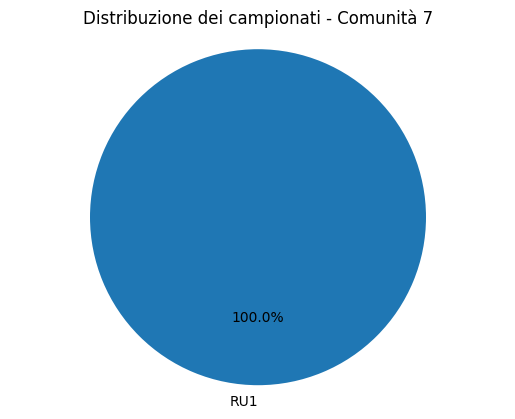


Comunità 8:
Distribuzione dei campionati:
FR1: 35 squadre
BE1: 26 squadre


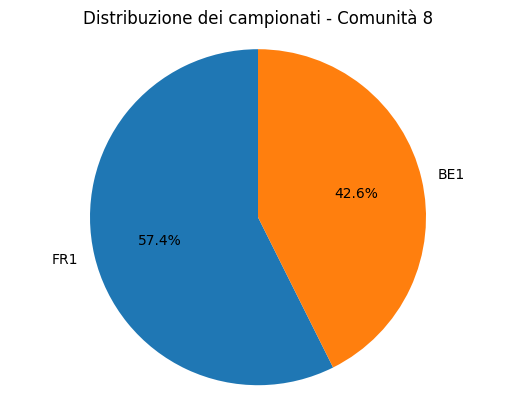


Comunità 6:
Distribuzione dei campionati:
UKR1: 35 squadre


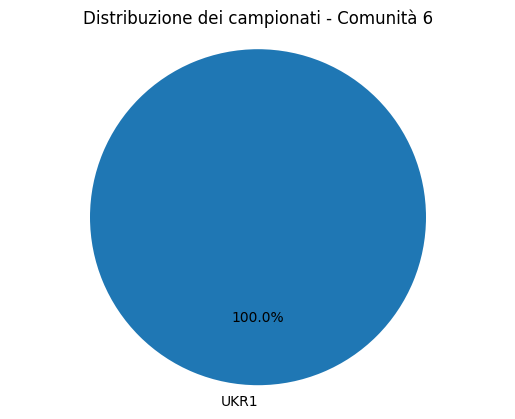

In [177]:
# Raggruppiamo i nodi per comunità, aggiungendo 1 agli ID delle comunità
community_nodes = defaultdict(list)
for node, community in partition.items():
    community_nodes[community + 1].append(node)  # Aggiungi 1 all'ID della comunità

# Per ogni comunità, calcoliamo la distribuzione dei campionati
for community, nodes in community_nodes.items():
    print(f"\nComunità {community}:")
    
    # Estraiamo il campionato per ciascun club della comunità
    campionati = [G.nodes[node].get('campionato', 'Sconosciuto') for node in nodes]
    
    # Conta la frequenza di ciascun campionato
    campionato_freq = defaultdict(int)
    for campionato in campionati:
        campionato_freq[campionato] += 1
    
    # Stampa la distribuzione dei campionati
    print("Distribuzione dei campionati:")
    for campionato, freq in campionato_freq.items():
        print(f"{campionato}: {freq} squadre")
    
    # Crea un grafico ad anello per visualizzare la distribuzione
    labels = campionato_freq.keys()
    sizes = campionato_freq.values()

    fig, ax = plt.subplots()
    ax.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)
    ax.axis('equal')  # Per fare in modo che il grafico sia un cerchio (ad anello)
    plt.title(f"Distribuzione dei campionati - Comunità {community}")
    plt.show()

In [178]:
print(club_id_to_competition)

{105: 'L1', 11127: 'RU1', 114: 'TR1', 12: 'IT1', 148: 'GB1', 157: 'BE1', 1894: 'DK1', 190: 'DK1', 192: 'NL1', 19789: 'TR1', 2079: 'GR1', 21957: 'GR1', 2414: 'DK1', 2457: 'PO1', 2578: 'SC1', 269: 'L1', 2727: 'BE1', 28643: 'BE1', 2990: 'PO1', 3057: 'BE1', 3690: 'RU1', 4795: 'L1', 511: 'SC1', 5358: 'ES1', 603: 'GB1', 60551: 'UKR1', 6996: 'UKR1', 8024: 'PO1', 868: 'TR1', 903: 'SC1', 969: 'FR1', 989: 'GB1', 993: 'ES1', 1025: 'IT1', 1082: 'FR1', 1160: 'FR1', 11688: 'TR1', 124: 'SC1', 1465: 'PO1', 2477: 'UKR1', 2553: 'SC1', 2672: 'GR1', 2740: 'UKR1', 3008: 'GB1', 31: 'GB1', 336: 'PO1', 3911: 'FR1', 4: 'L1', 410: 'IT1', 41231: 'RU1', 4128: 'RU1', 449: 'TR1', 4603: 'GR1', 55686: 'UKR1', 566: 'BE1', 595: 'FR1', 6890: 'TR1', 7185: 'GR1', 83678: 'UKR1', 932: 'RU1', 1010: 'GB1', 1108: 'ES1', 1124: 'RU1', 1158: 'FR1', 1177: 'DK1', 13: 'ES1', 131: 'ES1', 133: 'NL1', 141: 'TR1', 1411: 'BE1', 169: 'GR1', 18: 'L1', 18105: 'UKR1', 2036: 'L1', 273: 'FR1', 3325: 'PO1', 3327: 'PO1', 366: 'ES1', 4294: 'PO1',

In [179]:
# Supponiamo che il dataset "clubs" contenga le colonne "club_id" e "domestic_competition_id"
# che rappresentano l'ID del club e il campionato a cui appartiene.

club_id_to_competition = dict(zip(clubs["club_id"], clubs["domestic_competition_id"]))

# Ora puoi usare il dizionario per ottenere il campionato di un club specifico
club_id = 12  # Esempio di ID di un club

# Verifica se il club_id esiste nel dizionario, altrimenti assegna "Sconosciuto"
campionato = club_id_to_competition.get(club_id, "Sconosciuto")
print(f"Il club con ID {club_id} appartiene al campionato: {campionato}")

Il club con ID 12 appartiene al campionato: IT1



Comunità 0: Top 10 trasferimenti più costosi:
Fenerbahçe Spor Kulübü: 371911000.0 EUR
Galatasaray Spor Kulübü: 349482000.0 EUR
Olympiakos Syndesmos Filathlon Peiraios: 165500000.0 EUR
Beşiktaş Jimnastik Kulübü: 132315000.0 EUR
Trabzonspor Kulübü: 128228000.0 EUR
Panthessalonikios Athlitikos Omilos Konstantinoupoliton: 92500000.0 EUR
İstanbul Başakşehir Futbol Kulübü: 57567000.0 EUR
Panathinaikos Athlitikos Omilos: 55490000.0 EUR
Athlitiki Enosi Konstantinoupoleos: 44350000.0 EUR
Bursaspor: 43784000.0 EUR


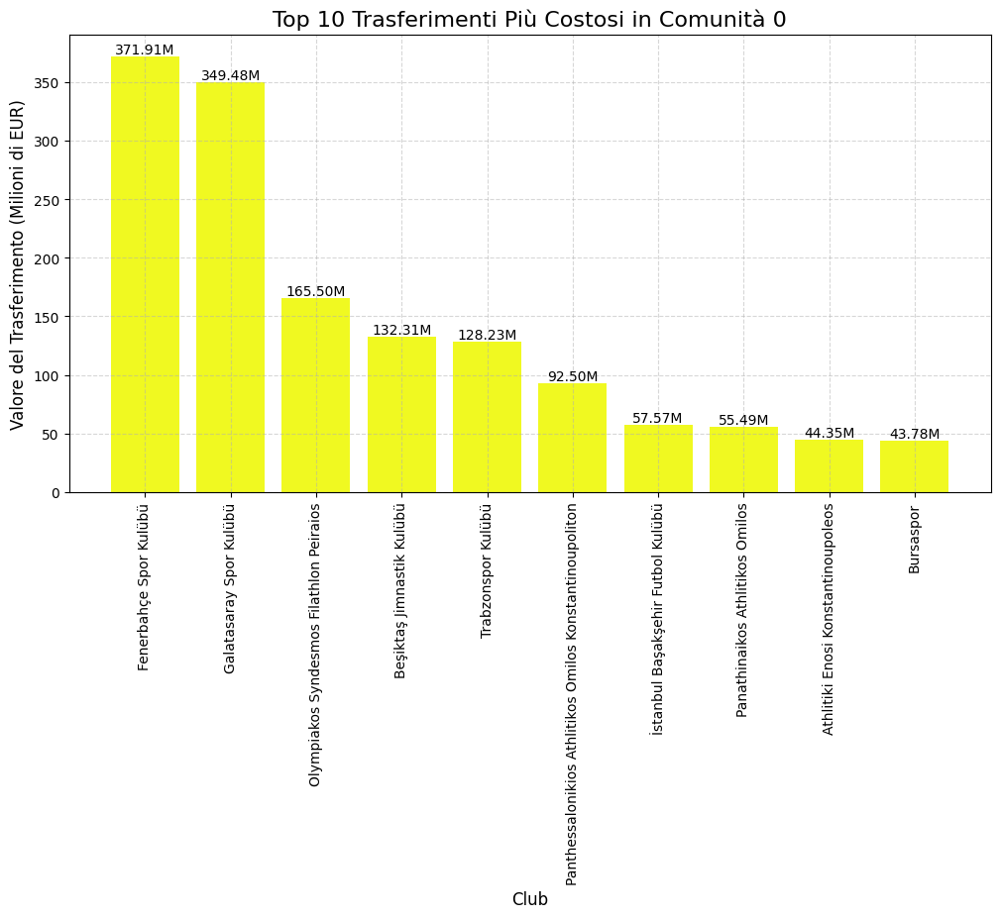


Comunità 3: Top 10 trasferimenti più costosi:
Borussia Dortmund: 1628600000.0 EUR
FC Bayern München: 1475320000.0 EUR
AFC Ajax Amsterdam: 1334140000.0 EUR
RasenBallsport Leipzig: 1180270000.0 EUR
Bayer 04 Leverkusen Fußball: 888400000.0 EUR
Verein für Leibesübungen Wolfsburg: 669250000.0 EUR
Eindhovense Voetbalvereniging Philips Sport Vereniging: 608180000.0 EUR
Eintracht Frankfurt Fußball AG: 601430000.0 EUR
Verein für Bewegungsspiele Stuttgart 1893: 504340000.0 EUR
Turn- und Sportgemeinschaft 1899 Hoffenheim Fußball-Spielbetriebs: 503650000.0 EUR


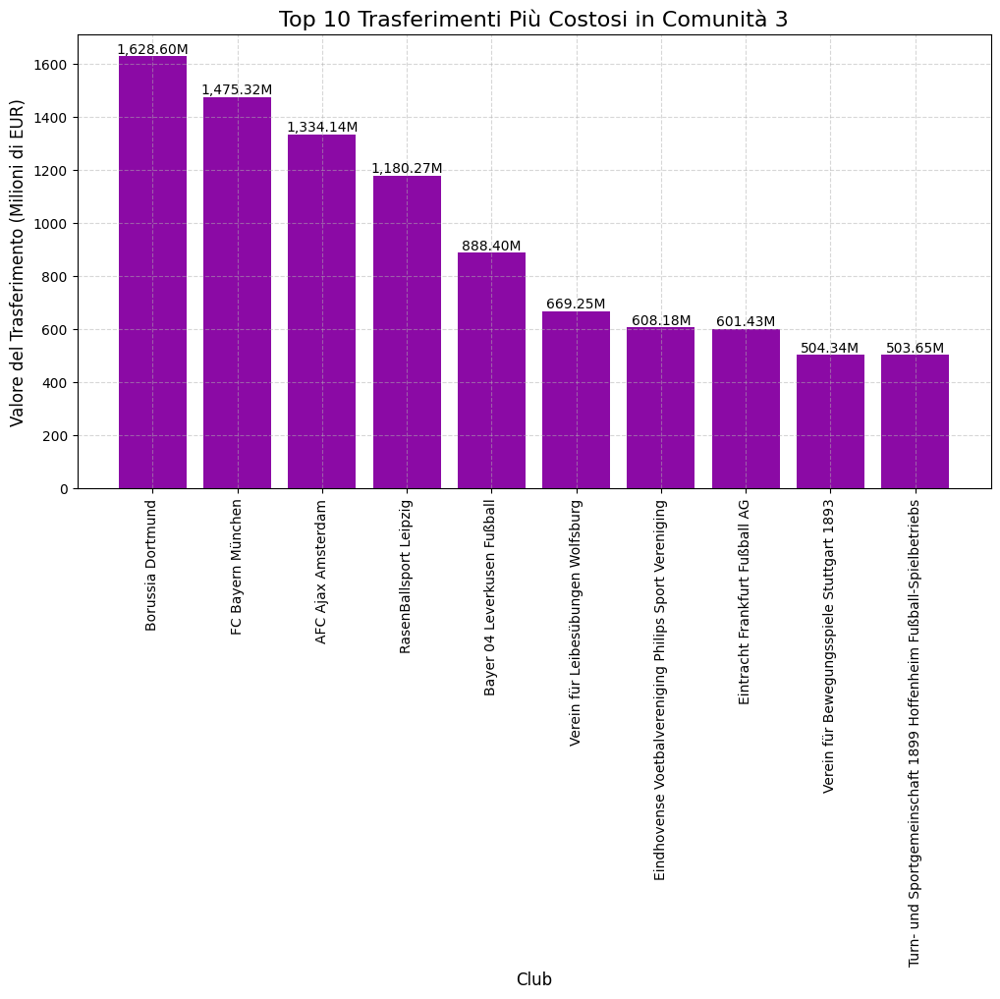


Comunità 2: Top 10 trasferimenti più costosi:
Juventus Football Club: 2113620000.0 EUR
Football Club Internazionale Milano S.p.A.: 1470960000.0 EUR
Associazione Sportiva Roma: 1369070000.0 EUR
Società Sportiva Calcio Napoli: 1216610000.0 EUR
Associazione Calcio Milan: 1151160000.0 EUR
Atalanta Bergamasca Calcio S.p.a.: 1078225000.0 EUR
Associazione Calcio Fiorentina: 783090000.0 EUR
US Sassuolo: 644541000.0 EUR
Genoa Cricket and Football Club: 644000000.0 EUR
Udinese Calcio: 551360500.0 EUR


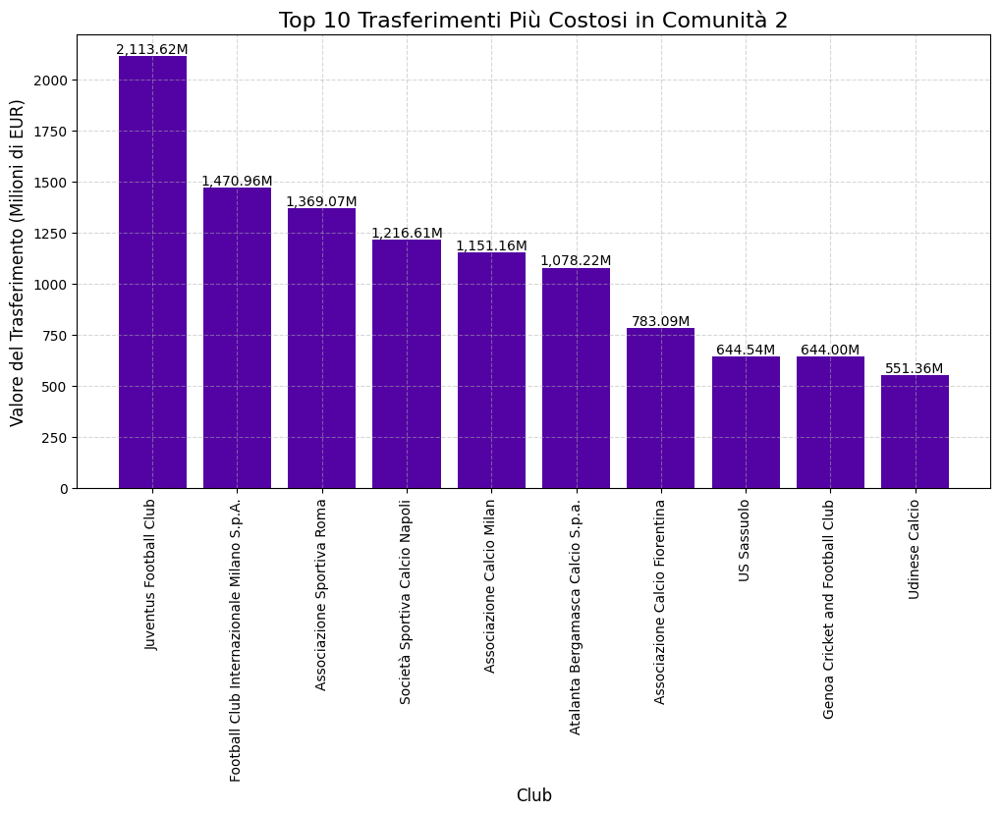


Comunità 1: Top 10 trasferimenti più costosi:
Chelsea Football Club: 3171210000.0 EUR
Manchester United Football Club: 2394640000.0 EUR
Tottenham Hotspur Football Club: 1696500000.0 EUR
Arsenal Football Club: 1692280000.0 EUR
Liverpool Football Club: 1555180000.0 EUR
Everton Football Club: 1254910000.0 EUR
Aston Villa Football Club: 1200750000.0 EUR
West Ham United Football Club: 1177850000.0 EUR
Southampton Football Club: 1088370000.0 EUR
Newcastle United Football Club: 1083400000.0 EUR


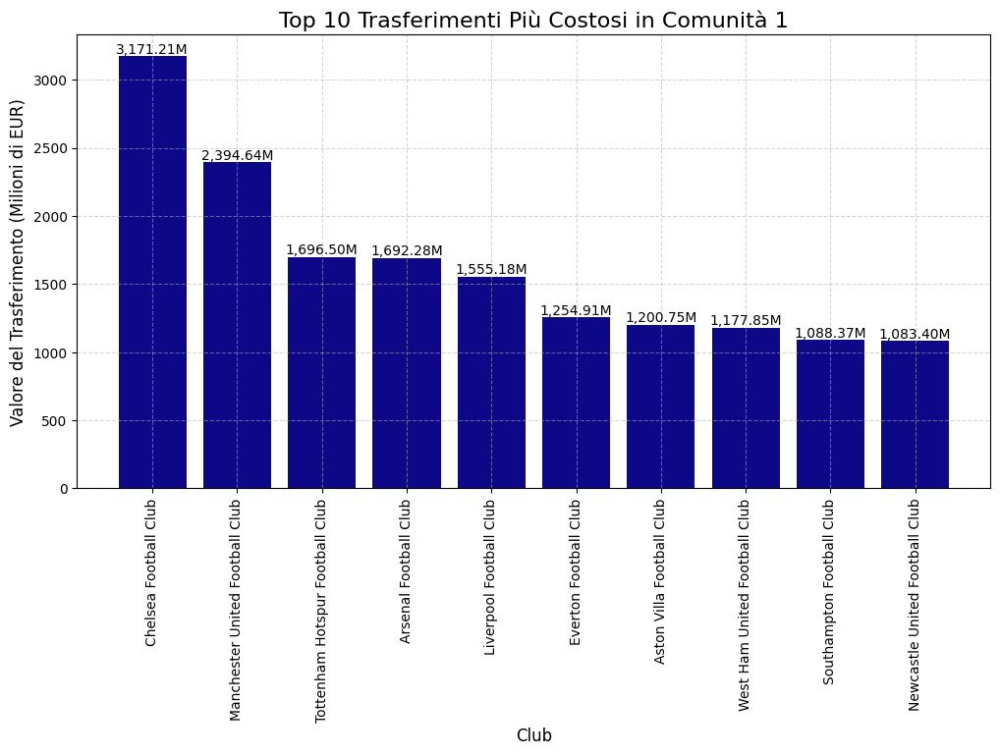


Comunità 4: Top 10 trasferimenti più costosi:
Manchester City Football Club: 2468020000.0 EUR
Futbol Club Barcelona: 1940430000.0 EUR
Club Atlético de Madrid S.A.D.: 1783900000.0 EUR
Real Madrid Club de Fútbol: 1701100000.0 EUR
Sport Lisboa e Benfica: 1592270000.0 EUR
Futebol Clube do Porto: 1086310000.0 EUR
Sevilla Fútbol Club S.A.D.: 1061230000.0 EUR
Sporting Clube de Portugal: 942790000.0 EUR
Valencia Club de Fútbol S. A. D.: 742650000.0 EUR
Villarreal Club de Fútbol S.A.D.: 652125000.0 EUR


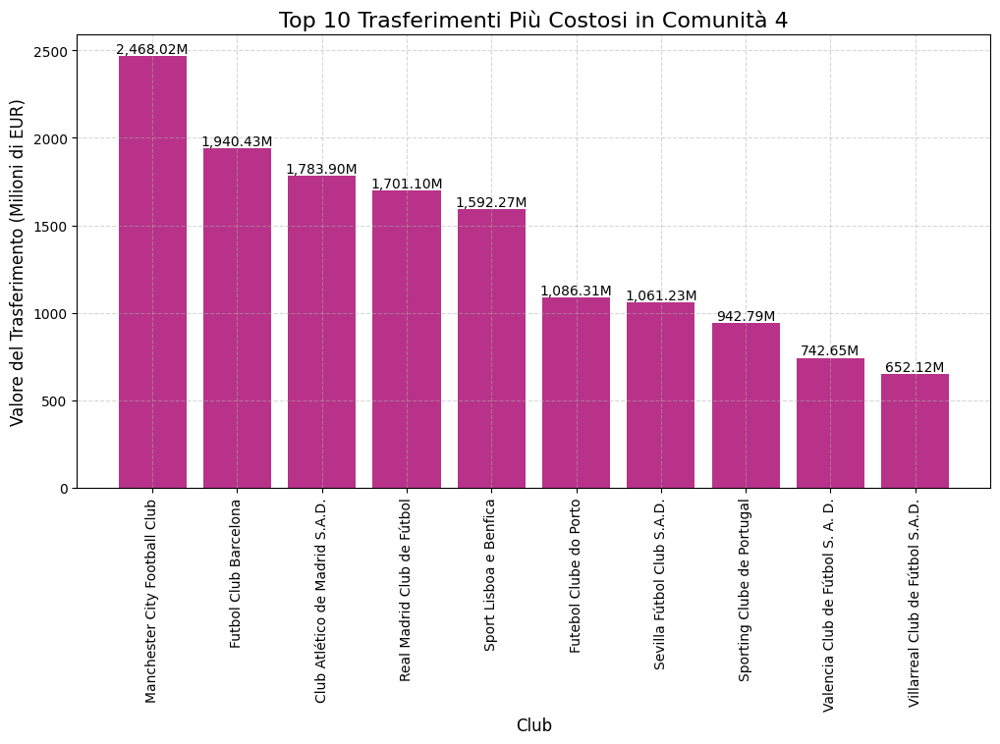


Comunità 6: Top 10 trasferimenti più costosi:
AO FK Zenit Sankt-Peterburg: 323895000.0 EUR
FK Spartak Moskva: 215064000.0 EUR
PFK CSKA Moskva: 187955000.0 EUR
FK Dinamo Moskva: 163765000.0 EUR
FK Krasnodar: 154010000.0 EUR
Футбольный клуб "Локомотив" Москва: 128788000.0 EUR
Anzhi Makhachkala ( -2022): 121590000.0 EUR
FC Rubin Kazan: 101110000.0 EUR
FK Rostov: 57908000.0 EUR
PFK Krylya Sovetov Samara: 33303000.0 EUR


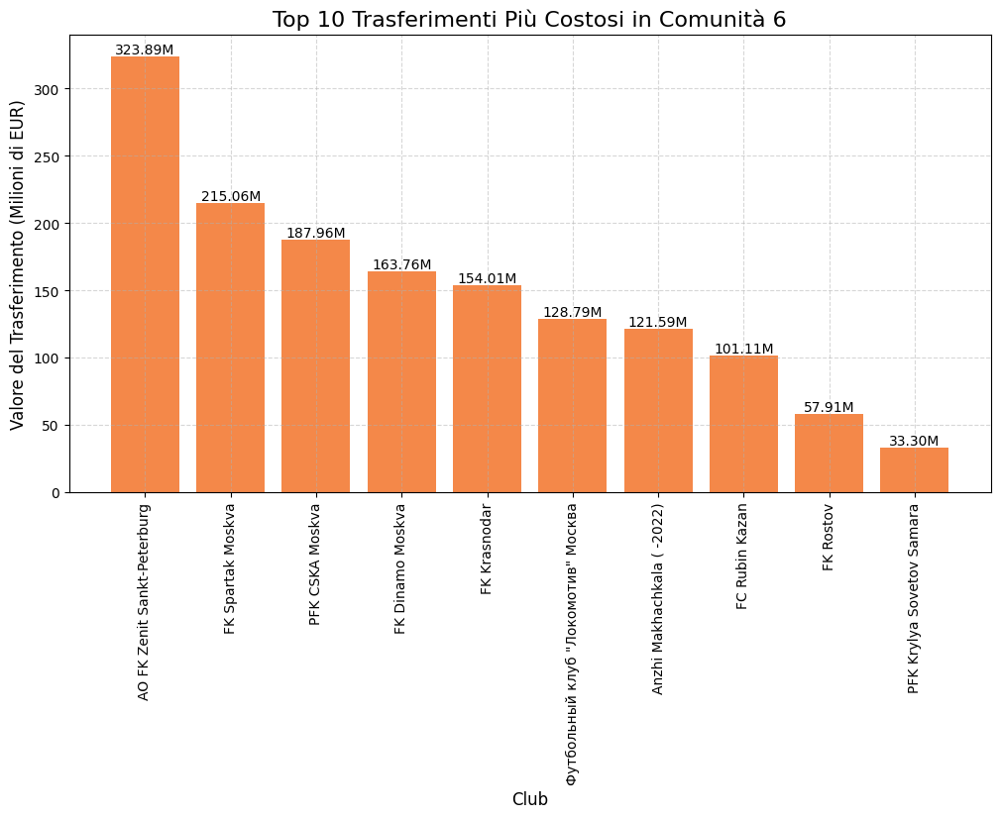


Comunità 7: Top 10 trasferimenti più costosi:
Paris Saint-Germain Football Club: 1891220000.0 EUR
Association sportive de Monaco Football Club: 1888950000.0 EUR
Olympique Lyonnais: 1166440000.0 EUR
Lille Olympique Sporting Club: 977270000.0 EUR
Stade Rennais Football Club: 969450000.0 EUR
Olympique de Marseille: 797030000.0 EUR
Olympique Gymnaste Club Nice Côte d'Azur: 505780000.0 EUR
Club Brugge Koninklijke Voetbalvereniging: 443650000.0 EUR
Koninklijke Racing Club Genk: 393482000.0 EUR
Royal Sporting Club Anderlecht: 365400000.0 EUR


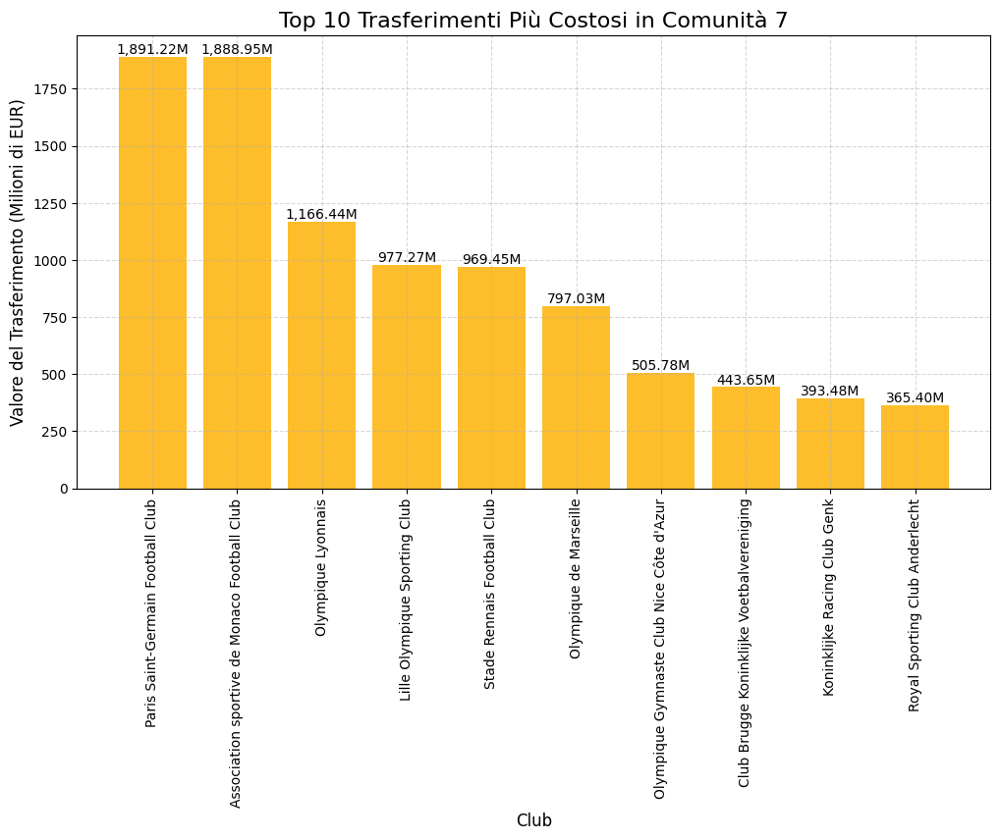


Comunità 5: Top 10 trasferimenti più costosi:
FC Shakhtar Donetsk: 384170000.0 EUR
Futbolniy Klub Dynamo Kyiv: 131726000.0 EUR
Metalist Kharkiv (- 2016): 34860000.0 EUR
SC Dnipro-1: 29585000.0 EUR
FK Zarya Lugansk: 23150000.0 EUR
Dnipro Dnipropetrovsk (-2020): 11800000.0 EUR
Vorskla Poltava: 8300000.0 EUR
Metalurg Donetsk (- 2015): 5850000.0 EUR
FK Kolos Kovalivka: 4026000.0 EUR
FK Polissya Zhytomyr: 3450000.0 EUR


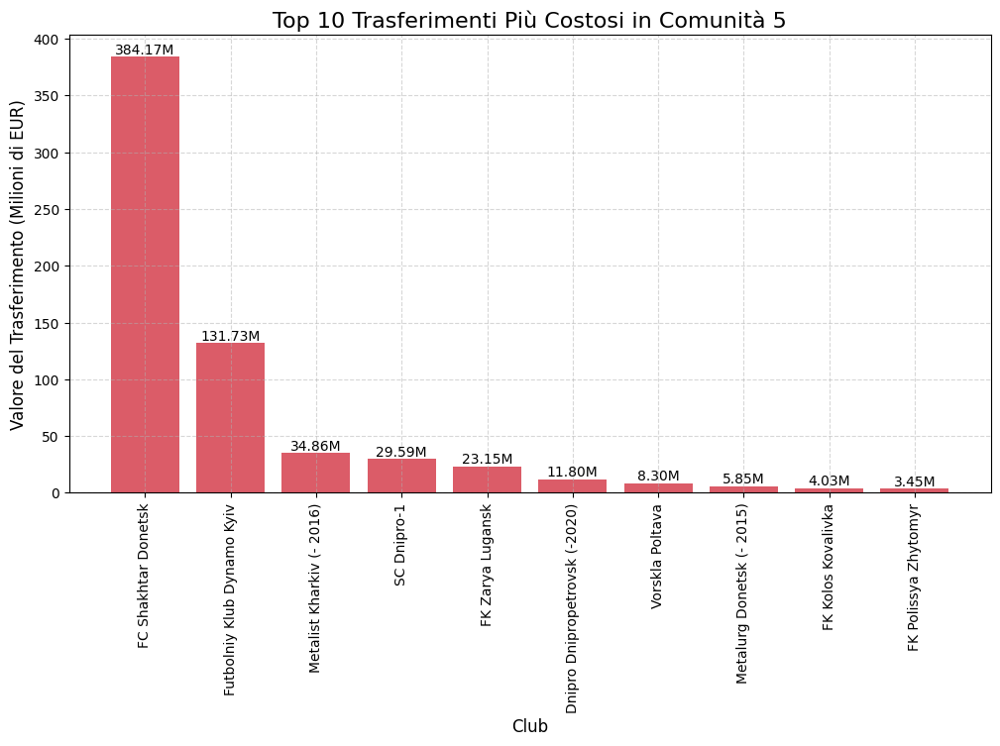

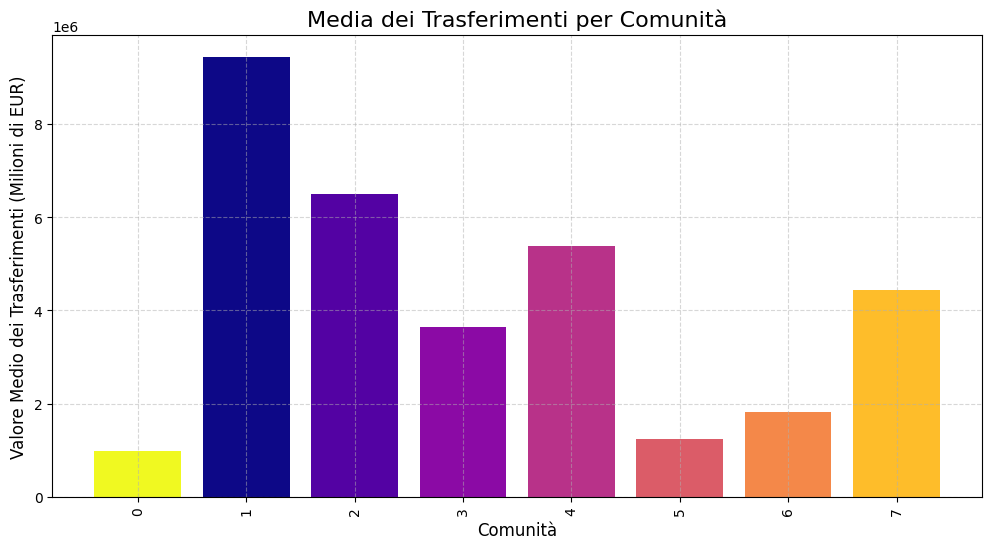

In [180]:
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import community as community_louvain
import numpy as np
from collections import defaultdict

# Carica i dati relativi ai trasferimenti
transfers = pd.read_csv("../Datasets/SNA/transfers.csv")

# Carica i dati dei club (Assumendo che 'clubs.csv' contenga 'id' e 'name')
clubs = pd.read_csv("../Datasets/SNA/clubs.csv")

# Crea una mappatura tra ID e nome del club
id_to_club_name = dict(zip(clubs['club_id'], clubs['name']))

# 1. Verifica e pulizia dei dati
transfers['transfer_fee'] = pd.to_numeric(transfers['transfer_fee'], errors='coerce')  # Coerce per convertire a NaN se non è numerico
transfers = transfers.dropna(subset=['transfer_fee'])  # Rimuove righe con NaN
transfers = transfers[transfers['transfer_fee'] > 0]  # Rimuove righe con valori di transfer_fee <= 0

# 2. Trasferimenti più costosi per comunità
def plot_most_expensive_transfers_per_community(G):
    # Aggiungi l'attributo "total_transfer_fee" al grafo G se non è già presente
    for node in G.nodes():
        G.nodes[node]['total_transfer_fee'] = 0

    for idx, row in transfers.iterrows():
        from_club_id = row['from_club_id']
        to_club_id = row['to_club_id']
        transfer_fee = row['transfer_fee']

        # Ottieni i nomi dei club utilizzando la mappatura
        from_club_name = id_to_club_name.get(from_club_id)
        to_club_name = id_to_club_name.get(to_club_id)

        # Verifica che i club siano presenti nel grafo
        if from_club_name and to_club_name:
            if from_club_name in G.nodes() and to_club_name in G.nodes():
                # Considera solo i trasferimenti con fee maggiore di 0
                if transfer_fee > 0:
                    # Aggiorna il totale del trasferimento per i club coinvolti
                    G.nodes[from_club_name]['total_transfer_fee'] += transfer_fee
                    G.nodes[to_club_name]['total_transfer_fee'] += transfer_fee

    # Modifica la numerazione delle comunità per partire da 1
    # partition = {node: community + 1 for node, community in partition.items()}  # Aggiungiamo 1 a ogni valore

    # Raggruppiamo i nodi per comunità
    community_nodes = defaultdict(list)
    for node, community in partition.items():
        community_nodes[community].append(node)

    # Crea una palette di colori per le comunità
    num_communities = len(community_nodes)
    colors = plt.cm.plasma(np.linspace(0, 1, num_communities))  # Usa la palette 'plasma'

    # Analisi dei trasferimenti più costosi per comunità
    for community, nodes in community_nodes.items():
        community_transfer_fees = [(node, G.nodes[node].get('total_transfer_fee', 0)) for node in nodes]
        
        # Ordina i trasferimenti in base al valore della fee
        community_transfer_fees.sort(key=lambda x: x[1], reverse=True)
        
        # Seleziona i top 10 trasferimenti
        top_transfers = community_transfer_fees[:10]
        
        # Stampa i top 10 trasferimenti
        print(f"\nComunità {community}: Top 10 trasferimenti più costosi:")
        for club, fee in top_transfers:
            print(f"{club}: {fee} EUR")

        # Visualizzazione dei top 10 trasferimenti più costosi della comunità
        top_clubs = [item[0] for item in top_transfers]
        top_fees = [item[1] / 1_000_000 for item in top_transfers]  # Converte i valori in milioni

        # Ottieni il colore per questa comunità
        community_color = colors[community - 1]  # I colori partono da 0

        plt.figure(figsize=(12, 6))
        bars = plt.bar(top_clubs, top_fees, color=community_color)  # Colorazione con il colore della comunità
        plt.title(f"Top 10 Trasferimenti Più Costosi in Comunità {community}", fontsize=16)
        plt.xlabel('Club', fontsize=12)
        plt.ylabel('Valore del Trasferimento (Milioni di EUR)', fontsize=12)
        plt.xticks(rotation=90)  # Ruota le etichette sull'asse delle ascisse per maggiore chiarezza

        # Formattazione dell'asse delle ordinate con valori in milioni
        for bar in bars:
            height = bar.get_height()
            bar.set_height(height)
            plt.text(bar.get_x() + bar.get_width() / 2, height, f'{height:,.2f}M', ha='center', va='bottom', fontsize=10)
        plt.grid(True, linestyle='--', alpha=0.5)

        plt.show()

# 4. Media dei trasferimenti per comunità
def plot_average_transfer_fee_per_community(G):
    # Aggiungi l'attributo "transfer_fee" al grafo G se non è già presente
    for node in G.nodes():
        G.nodes[node]['total_transfer_fee'] = 0
        G.nodes[node]['num_transfers'] = 0

    for idx, row in transfers.iterrows():
        from_club_id = row['from_club_id']
        to_club_id = row['to_club_id']
        transfer_fee = row['transfer_fee']

        # Ottieni i nomi dei club utilizzando la mappatura
        from_club_name = id_to_club_name.get(from_club_id)
        to_club_name = id_to_club_name.get(to_club_id)

        # Verifica che i club siano presenti nel grafo
        if from_club_name and to_club_name:
            if from_club_name in G.nodes() and to_club_name in G.nodes():
                # Considera solo i trasferimenti con fee maggiore di 0
                if transfer_fee > 0:
                    # Aggiorna il totale del trasferimento e il numero di trasferimenti per i club coinvolti
                    G.nodes[from_club_name]['total_transfer_fee'] += transfer_fee
                    G.nodes[from_club_name]['num_transfers'] += 1
                    G.nodes[to_club_name]['total_transfer_fee'] += transfer_fee
                    G.nodes[to_club_name]['num_transfers'] += 1

    # Modifica la numerazione delle comunità per partire da 1
    #partition = {node: community + 1 for node, community in partition.items()}  # Aggiungiamo 1 a ogni valore

    # Raggruppiamo i nodi per comunità
    community_nodes = defaultdict(list)
    for node, community in partition.items():
        community_nodes[community].append(node)

    # Analisi della media dei trasferimenti per comunità
    avg_transfer_fees_per_community = {}
    for community, nodes in community_nodes.items():
        community_avg_fee = 0
        for node in nodes:
            if G.nodes[node]['num_transfers'] > 0:
                community_avg_fee += G.nodes[node]['total_transfer_fee'] / G.nodes[node]['num_transfers']
        avg_transfer_fees_per_community[community] = community_avg_fee / len(nodes)

    # Visualizzazione della media dei trasferimenti per comunità
    communities = list(avg_transfer_fees_per_community.keys())
    avg_fees = list(avg_transfer_fees_per_community.values())

    # Ottieni i colori per le comunità
    num_communities = len(community_nodes)
    community_colors = plt.cm.plasma(np.linspace(0, 1, num_communities))  # Usa la colormap plasma

    plt.figure(figsize=(12, 6))
    # Correzione: usa l'indicizzazione per accedere ai colori
    color_mapping = [community_colors[community - 1] for community in communities]  # Mapping dei colori per le comunità
    plt.bar(communities, avg_fees, color=color_mapping)  # Colorazione delle barre per comunità
    plt.title("Media dei Trasferimenti per Comunità", fontsize=16)
    plt.xlabel('Comunità', fontsize=12)
    plt.ylabel('Valore Medio dei Trasferimenti (Milioni di EUR)', fontsize=12)
    plt.xticks(rotation=90)

    # Aggiungi la griglia come sfondo
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.show()

# Invoca le funzioni per eseguire le analisi
plot_most_expensive_transfers_per_community(G)  # Visualizza i top 10 trasferimenti più costosi per comunità
plot_average_transfer_fee_per_community(G)  # Visualizza la media dei trasferimenti per comunità

In [195]:
import pandas as pd
import matplotlib.pyplot as plt
from collections import defaultdict
import community as community_louvain
import networkx as nx

# Carica i dati relativi ai trasferimenti
transfers = pd.read_csv("../Datasets/SNA/transfers.csv")

# Carica i dati dei club (Assumiamo che 'clubs.csv' contenga 'id' e 'name')
clubs = pd.read_csv("../Datasets/SNA/clubs.csv")

# Crea una mappatura tra ID e nome del club
id_to_club_name = dict(zip(clubs['club_id'], clubs['name']))

# Aggiungi l'attributo "balance" e "balance_last_year" per ogni nodo nel grafo (inizializzato a 0)
for node in G.nodes():
    G.nodes[node]['balance'] = 0.0
    G.nodes[node]['balance_last_year'] = 0.0
    
print(f"Bilancio Inter (Ultimo Anno): {G.nodes['Football Club Internazionale Milano S.p.A.']['balance_last_year']} EUR")


# Funzione per calcolare i bilanci globali
def calculate_balance():
    for idx, row in transfers.iterrows():
        from_club_id = row['from_club_id']
        to_club_id = row['to_club_id']
        transfer_fee = row['transfer_fee']

        # Sostituisci valori NaN con 0
        transfer_fee = transfer_fee if pd.notna(transfer_fee) else 0

        # Ottieni i nomi dei club utilizzando la mappatura
        from_club_name = id_to_club_name.get(from_club_id)
        to_club_name = id_to_club_name.get(to_club_id)

        # Verifica che i club siano presenti nel grafo
        if from_club_name and to_club_name:
            if from_club_name in G.nodes() and to_club_name in G.nodes():
                # Bilancio globale: il club cede il giocatore (incassa), il club acquista (paga)
                G.nodes[from_club_name]['balance'] += transfer_fee
                G.nodes[to_club_name]['balance'] -= transfer_fee

# Funzione per calcolare il bilancio dell'ultimo anno (2023/24)
def calculate_balance_last_year(year):
    last_year_transfers = transfers[transfers['transfer_season'] == year]

    # Itera sui trasferimenti
    for idx, row in last_year_transfers.iterrows():
        from_club_id = row['from_club_id']
        to_club_id = row['to_club_id']
        transfer_fee = row['transfer_fee']

        transfer_fee = transfer_fee if pd.notna(transfer_fee) else 0

        from_club_name = id_to_club_name.get(from_club_id)
        to_club_name = id_to_club_name.get(to_club_id)

        # Verifica che i club siano presenti nel grafo
        if from_club_name and to_club_name:
            if from_club_name in G.nodes() and to_club_name in G.nodes():
                # Bilancio dell'anno
                G.nodes[from_club_name]['balance_last_year'] += transfer_fee
                G.nodes[to_club_name]['balance_last_year'] -= transfer_fee

                # Debugging per Monza
                if from_club_name == "Football Club Internazionale Milano S.p.A.":
                    print(f"Monza ha incassato {transfer_fee} EUR")
                elif to_club_name == "Football Club Internazionale Milano S.p.A.":
                    print(f"Monza ha pagato {transfer_fee} EUR")
                
    print(f"Bilancio Monza (Ultimo Anno): {G.nodes['Football Club Internazionale Milano S.p.A.']['balance_last_year']} EUR")

# Chiamate alla funzione per calcolare i bilanci
calculate_balance()  # Calcola il bilancio globale
calculate_balance_last_year('23/24')  # Calcola il bilancio per l'anno 2023/24

Bilancio Inter (Ultimo Anno): 0.0 EUR
Monza ha incassato 0.0 EUR
Monza ha pagato 0.0 EUR
Monza ha incassato 0.0 EUR
Monza ha pagato 0.0 EUR
Monza ha pagato 0.0 EUR
Monza ha incassato 0.0 EUR
Monza ha pagato 0.0 EUR
Monza ha pagato 0.0 EUR
Monza ha pagato 0.0 EUR
Monza ha incassato 0.0 EUR
Monza ha pagato 0.0 EUR
Monza ha pagato 0.0 EUR
Monza ha pagato 0.0 EUR
Monza ha incassato 0.0 EUR
Monza ha pagato 0.0 EUR
Monza ha pagato 7300000.0 EUR
Monza ha pagato 0.0 EUR
Monza ha pagato 31400000.0 EUR
Monza ha pagato 0.0 EUR
Monza ha incassato 0.0 EUR
Monza ha incassato 3400000.0 EUR
Monza ha incassato 0.0 EUR
Monza ha incassato 5370000.0 EUR
Monza ha pagato 0.0 EUR
Monza ha incassato 13000000.0 EUR
Monza ha pagato 0.0 EUR
Monza ha incassato 0.0 EUR
Monza ha pagato 0.0 EUR
Monza ha pagato 6900000.0 EUR
Monza ha incassato 0.0 EUR
Monza ha incassato 0.0 EUR
Monza ha incassato 50200000.0 EUR
Monza ha incassato 0.0 EUR
Monza ha pagato 0.0 EUR
Monza ha incassato 0.0 EUR
Monza ha incassato 0.0 EUR
Mo


Comunità 1: Top 5 club con bilancio maggiore:
Olympiakos Syndesmos Filathlon Peiraios: 59.50 milioni di EUR
Panthessalonikios Athlitikos Omilos Konstantinoupoliton: 39.94 milioni di EUR
Bursaspor: 30.02 milioni di EUR
İstanbul Başakşehir Futbol Kulübü: 20.04 milioni di EUR
Kayserispor Kulübü: 19.57 milioni di EUR

Comunità 1: Top 5 club con bilancio minore:
Panathinaikos Athlitikos Omilos: -22.47 milioni di EUR
Fenerbahçe Spor Kulübü: -26.85 milioni di EUR
Trabzonspor Kulübü: -27.06 milioni di EUR
Beşiktaş Jimnastik Kulübü: -65.36 milioni di EUR
Galatasaray Spor Kulübü: -74.60 milioni di EUR
Immagine salvata come charts/bilanci_comunita_1_globale.png


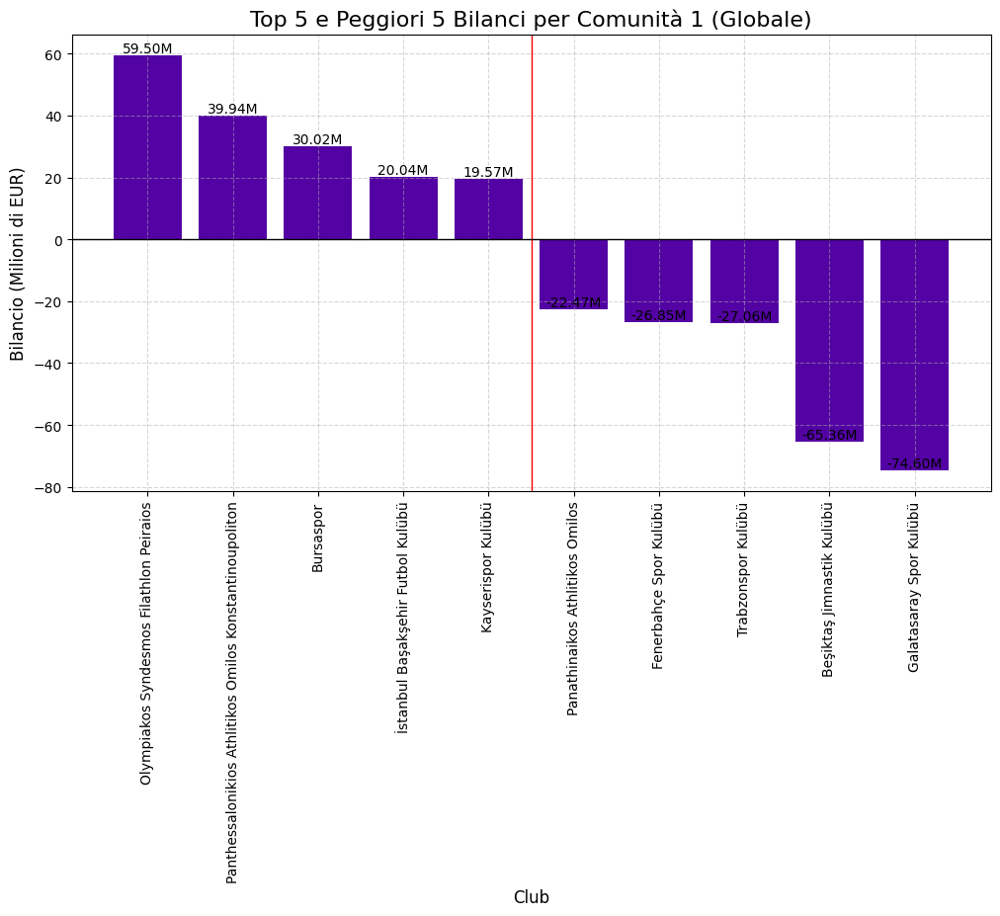


Comunità 4: Top 5 club con bilancio maggiore:
AFC Ajax Amsterdam: 629.08 milioni di EUR
Borussia Dortmund: 276.70 milioni di EUR
Eindhovense Voetbalvereniging Philips Sport Vereniging: 231.08 milioni di EUR
Alkmaar Zaanstreek: 219.49 milioni di EUR
Verein für Bewegungsspiele Stuttgart 1893: 175.74 milioni di EUR

Comunità 4: Top 5 club con bilancio minore:
SV Darmstadt 98: -1.30 milioni di EUR
Bayer 04 Leverkusen Fußball: -3.10 milioni di EUR
1. Fußballclub Union Berlin: -17.77 milioni di EUR
Verein für Leibesübungen Wolfsburg: -36.65 milioni di EUR
FC Bayern München: -462.08 milioni di EUR
Immagine salvata come charts/bilanci_comunita_4_globale.png


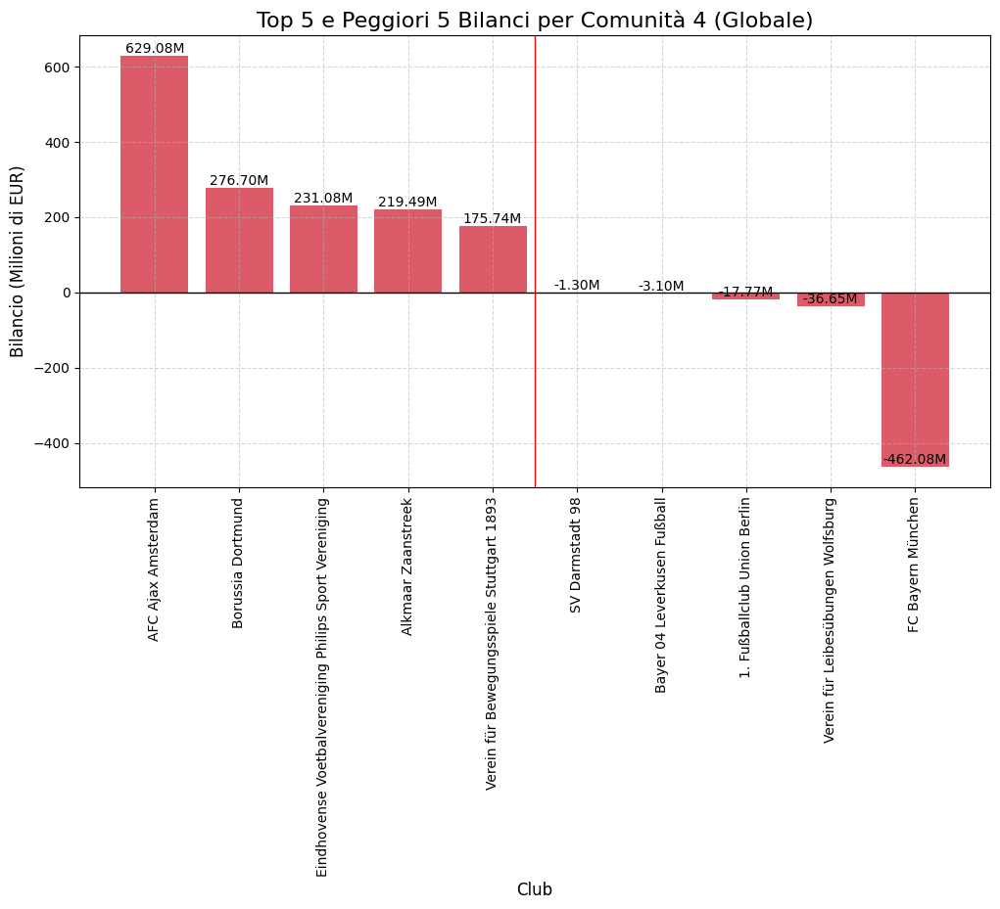


Comunità 3: Top 5 club con bilancio maggiore:
Genoa Cricket and Football Club: 227.90 milioni di EUR
UC Sampdoria: 181.94 milioni di EUR
Empoli Football Club S.r.l.: 167.25 milioni di EUR
Udinese Calcio: 157.96 milioni di EUR
Atalanta Bergamasca Calcio S.p.a.: 154.12 milioni di EUR

Comunità 3: Top 5 club con bilancio minore:
Parma Calcio 1913: -78.84 milioni di EUR
Football Club Internazionale Milano S.p.A.: -151.28 milioni di EUR
Juventus Football Club: -320.98 milioni di EUR
Associazione Calcio Milan: -372.26 milioni di EUR
Società Sportiva Calcio Napoli: -542.55 milioni di EUR
Immagine salvata come charts/bilanci_comunita_3_globale.png


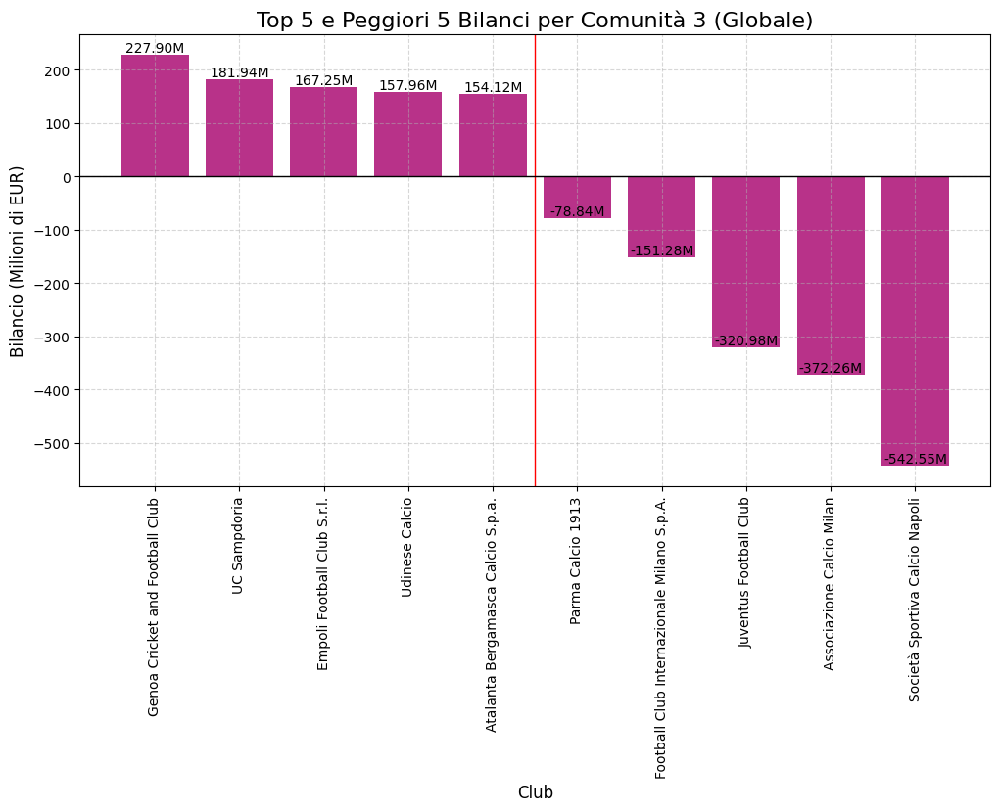


Comunità 2: Top 5 club con bilancio maggiore:
Norwich City: 149.96 milioni di EUR
Leeds United: 137.22 milioni di EUR
Southampton Football Club: 125.17 milioni di EUR
Watford FC: 118.33 milioni di EUR
Swansea City: 111.64 milioni di EUR

Comunità 2: Top 5 club con bilancio minore:
Liverpool Football Club: -628.38 milioni di EUR
Tottenham Hotspur Football Club: -730.60 milioni di EUR
Arsenal Football Club: -901.98 milioni di EUR
Chelsea Football Club: -1339.81 milioni di EUR
Manchester United Football Club: -1431.00 milioni di EUR
Immagine salvata come charts/bilanci_comunita_2_globale.png


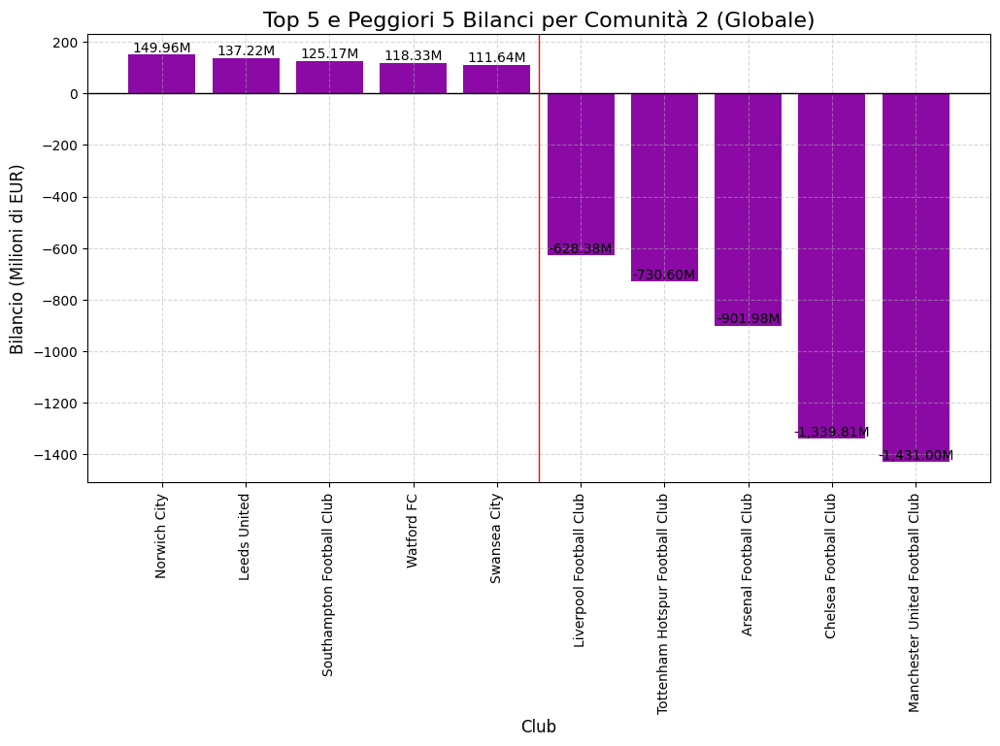


Comunità 5: Top 5 club con bilancio maggiore:
Sport Lisboa e Benfica: 812.75 milioni di EUR
Futebol Clube do Porto: 478.35 milioni di EUR
Sporting Clube de Portugal: 422.55 milioni di EUR
Sporting Clube de Braga: 207.81 milioni di EUR
Real Sociedad de Fútbol S.A.D.: 127.65 milioni di EUR

Comunità 5: Top 5 club con bilancio minore:
Getafe Club de Fútbol S.A.D. Team Dubai: -19.65 milioni di EUR
Club Atlético de Madrid S.A.D.: -167.10 milioni di EUR
Real Madrid Club de Fútbol: -311.20 milioni di EUR
Futbol Club Barcelona: -534.35 milioni di EUR
Manchester City Football Club: -992.28 milioni di EUR
Immagine salvata come charts/bilanci_comunita_5_globale.png


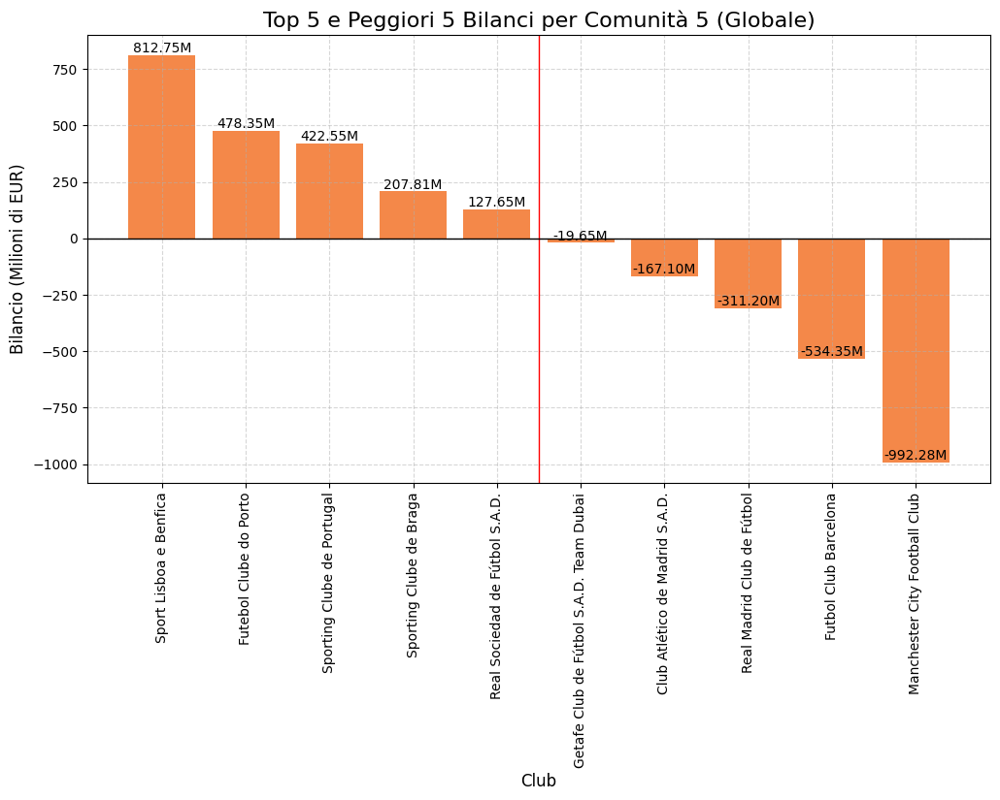


Comunità 7: Top 5 club con bilancio maggiore:
PFK CSKA Moskva: 66.25 milioni di EUR
FC Rubin Kazan: 27.83 milioni di EUR
FK Ufa: 25.54 milioni di EUR
FK Rostov: 20.72 milioni di EUR
PFK Krylya Sovetov Samara: 10.86 milioni di EUR

Comunità 7: Top 5 club con bilancio minore:
FK Krasnodar: -21.39 milioni di EUR
FK Dinamo Moskva: -27.55 milioni di EUR
Футбольный клуб "Локомотив" Москва: -33.71 milioni di EUR
FK Spartak Moskva: -86.76 milioni di EUR
AO FK Zenit Sankt-Peterburg: -201.38 milioni di EUR
Immagine salvata come charts/bilanci_comunita_7_globale.png


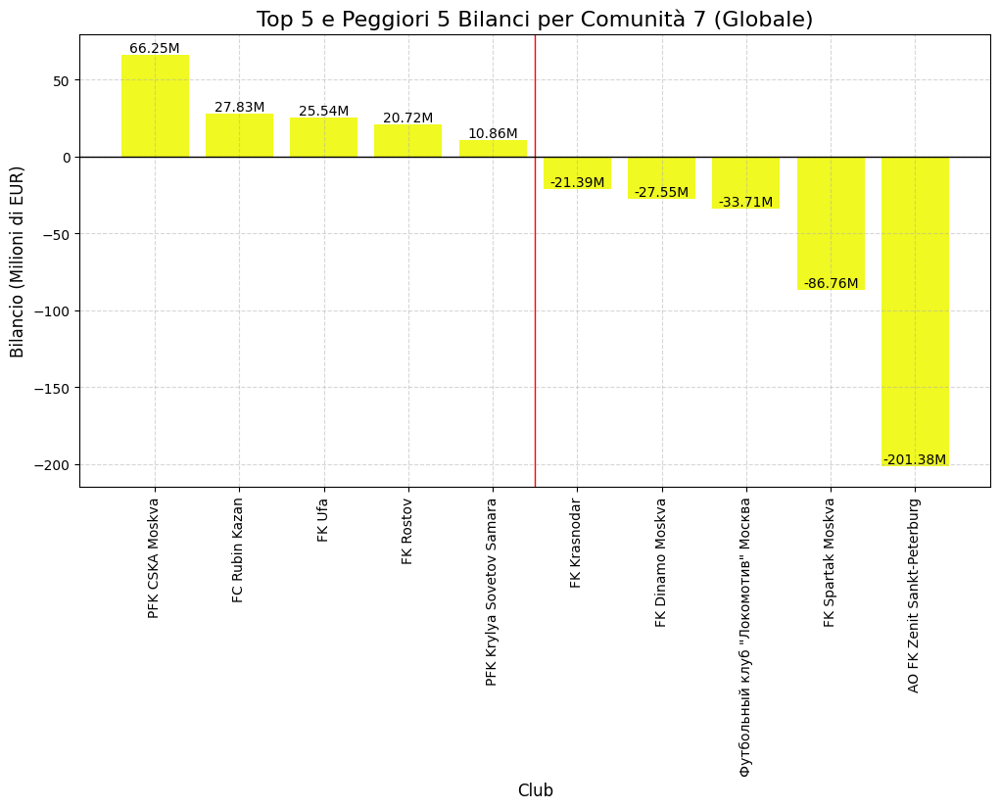


Comunità 8: Top 5 club con bilancio maggiore:
Lille Olympique Sporting Club: 392.63 milioni di EUR
Olympique Lyonnais: 309.36 milioni di EUR
Koninklijke Racing Club Genk: 251.98 milioni di EUR
Association sportive de Monaco Football Club: 218.05 milioni di EUR
Royal Sporting Club Anderlecht: 184.82 milioni di EUR

Comunità 8: Top 5 club con bilancio minore:
Stade brestois 29: -3.00 milioni di EUR
Racing Club de Strasbourg Alsace: -24.35 milioni di EUR
Olympique Gymnaste Club Nice Côte d'Azur: -84.28 milioni di EUR
Olympique de Marseille: -118.07 milioni di EUR
Paris Saint-Germain Football Club: -1044.42 milioni di EUR
Immagine salvata come charts/bilanci_comunita_8_globale.png


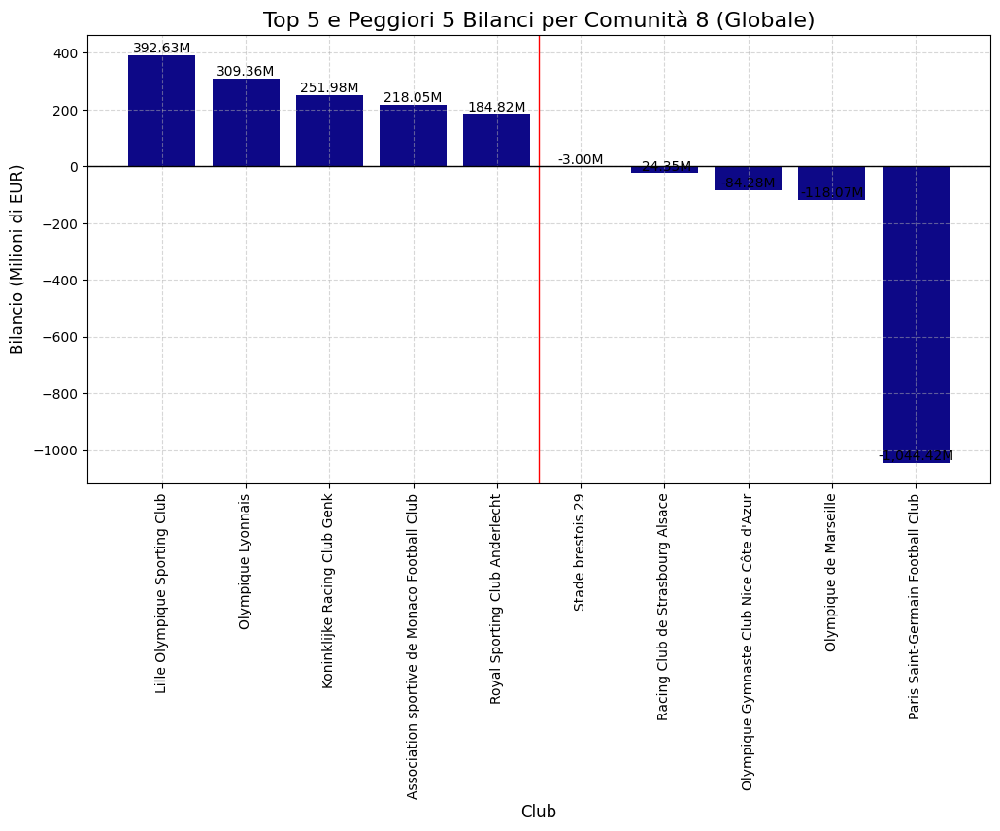


Comunità 6: Top 5 club con bilancio maggiore:
FC Shakhtar Donetsk: 199.19 milioni di EUR
Futbolniy Klub Dynamo Kyiv: 51.91 milioni di EUR
FK Zarya Lugansk: 20.41 milioni di EUR
Metalist Kharkiv (- 2016): 18.56 milioni di EUR
SC Dnipro-1: 13.12 milioni di EUR

Comunità 6: Top 5 club con bilancio minore:
LNZ Cherkasy: -0.15 milioni di EUR
Metalist Kharkiv: -0.32 milioni di EUR
FK Karpaty Lviv: -1.36 milioni di EUR
Dnipro Dnipropetrovsk (-2020): -2.20 milioni di EUR
FK Polissya Zhytomyr: -3.45 milioni di EUR
Immagine salvata come charts/bilanci_comunita_6_globale.png


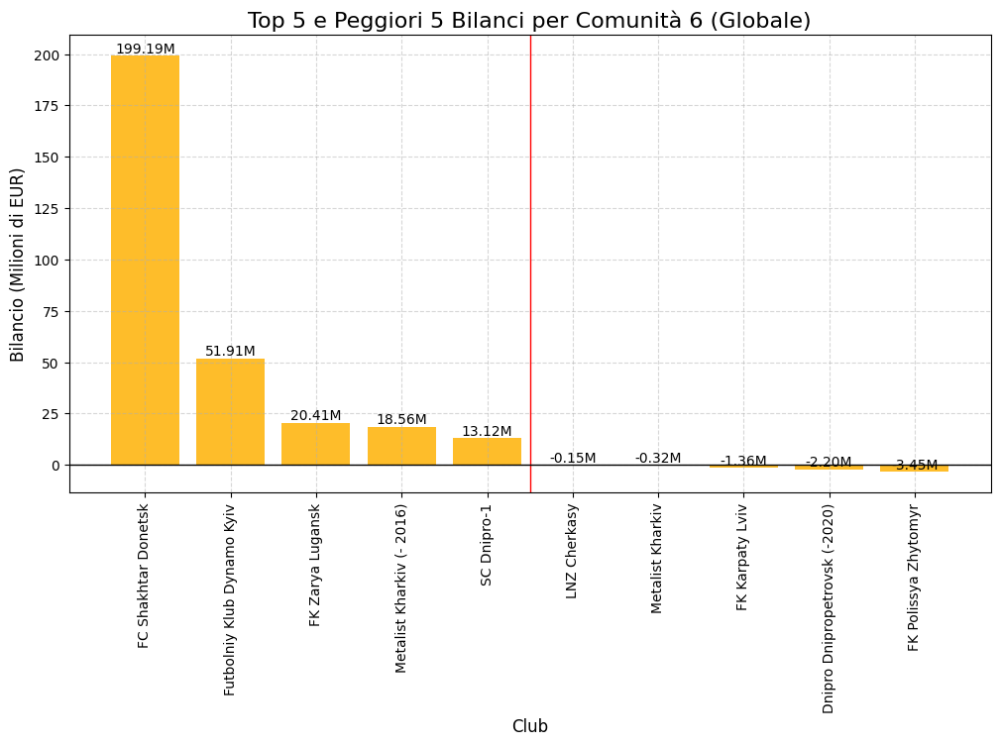


Comunità 1: Top 5 club con bilancio maggiore (2023/24):
Galatasaray Spor Kulübü: 14.05 milioni di EUR
Panthessalonikios Athlitikos Omilos Konstantinoupoliton: 8.35 milioni di EUR
Olympiakos Syndesmos Filathlon Peiraios: 6.50 milioni di EUR
Aris Thessalonikis: 5.80 milioni di EUR
Hatayspor Futbol Kulübü: 5.29 milioni di EUR

Comunità 1: Top 5 club con bilancio minore (2023/24):
Pendikspor: -4.70 milioni di EUR
Trabzonspor Kulübü: -6.95 milioni di EUR
Panathinaikos Athlitikos Omilos: -8.00 milioni di EUR
Athlitiki Enosi Konstantinoupoleos: -10.80 milioni di EUR
Beşiktaş Jimnastik Kulübü: -16.79 milioni di EUR
Immagine salvata come charts/bilanci_comunita_1_ultimo_anno.png


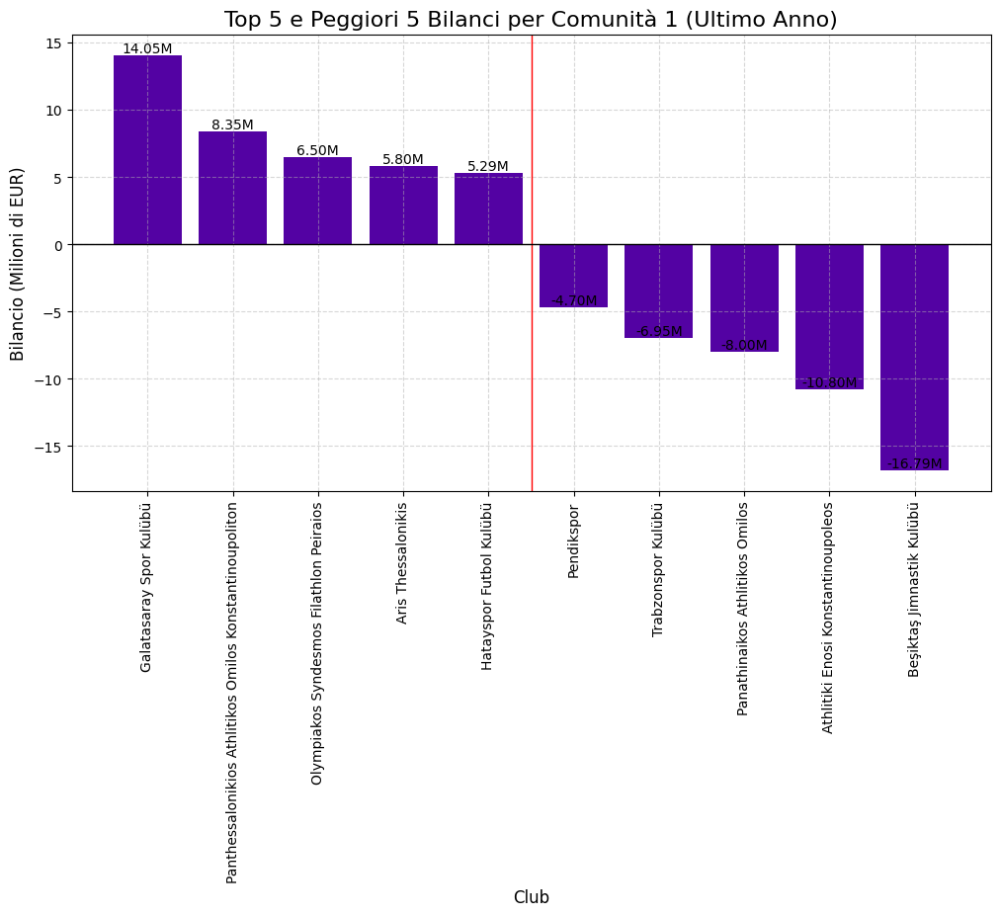


Comunità 4: Top 5 club con bilancio maggiore (2023/24):
RasenBallsport Leipzig: 103.00 milioni di EUR
AFC Ajax Amsterdam: 88.60 milioni di EUR
Eintracht Frankfurt Fußball AG: 81.30 milioni di EUR
Borussia Dortmund: 55.75 milioni di EUR
Alkmaar Zaanstreek: 55.10 milioni di EUR

Comunità 4: Top 5 club con bilancio minore (2023/24):
Eindhovense Voetbalvereniging Philips Sport Vereniging: -4.10 milioni di EUR
Bayer 04 Leverkusen Fußball: -5.80 milioni di EUR
Turn- und Sportgemeinschaft 1899 Hoffenheim Fußball-Spielbetriebs: -6.30 milioni di EUR
1. Fußballclub Union Berlin: -28.10 milioni di EUR
FC Bayern München: -32.08 milioni di EUR
Immagine salvata come charts/bilanci_comunita_4_ultimo_anno.png


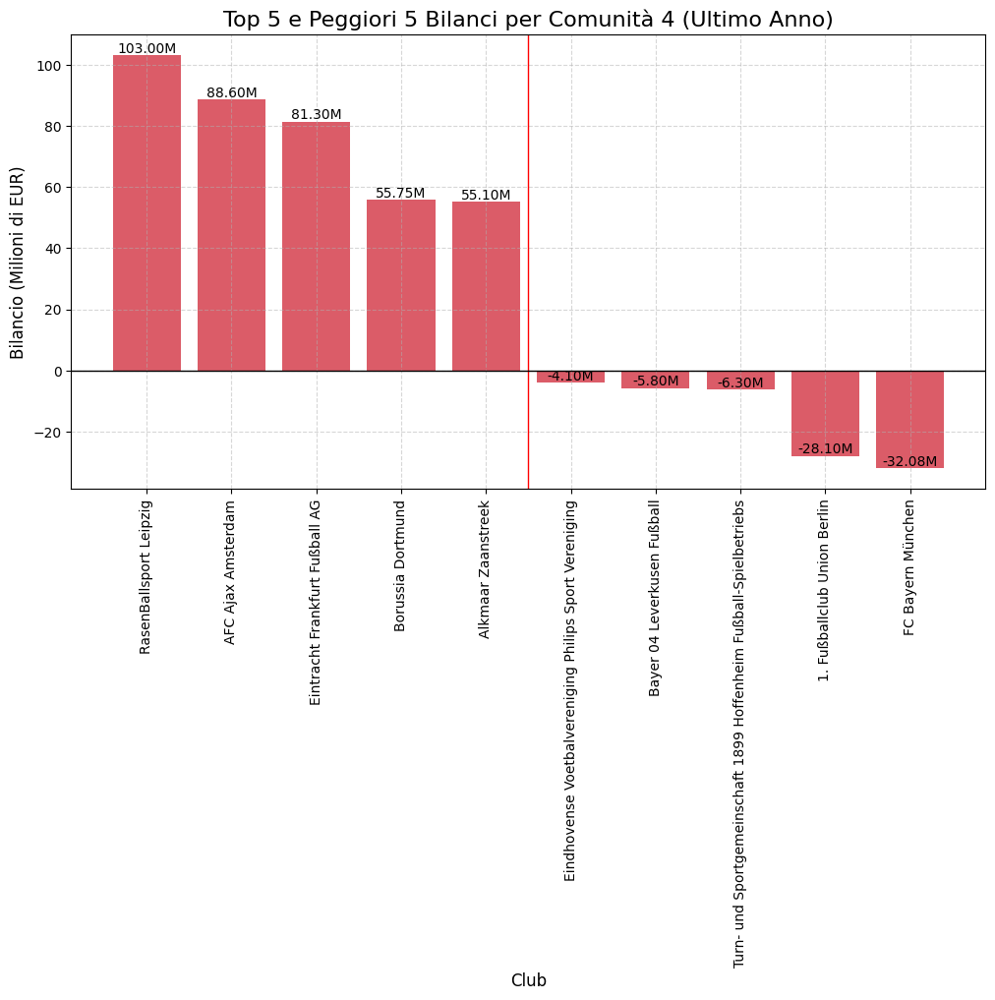


Comunità 3: Top 5 club con bilancio maggiore (2023/24):
Verona Hellas Football Club: 83.50 milioni di EUR
Atalanta Bergamasca Calcio S.p.a.: 56.50 milioni di EUR
Empoli Football Club S.r.l.: 49.45 milioni di EUR
US Sassuolo: 43.12 milioni di EUR
Football Club Internazionale Milano S.p.A.: 30.47 milioni di EUR

Comunità 3: Top 5 club con bilancio minore (2023/24):
US Salernitana 1919: -20.15 milioni di EUR
Juventus Football Club: -26.22 milioni di EUR
Torino Calcio: -32.65 milioni di EUR
Associazione Calcio Monza: -44.80 milioni di EUR
Associazione Calcio Milan: -46.00 milioni di EUR
Immagine salvata come charts/bilanci_comunita_3_ultimo_anno.png


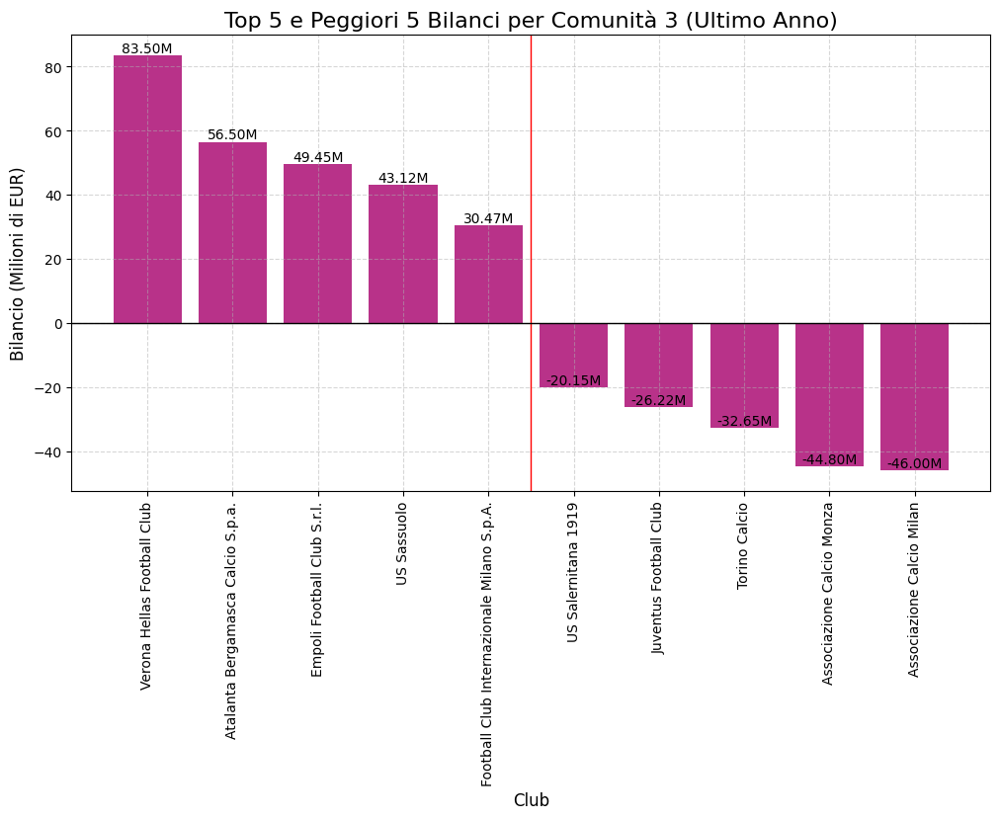


Comunità 2: Top 5 club con bilancio maggiore (2023/24):
Southampton Football Club: 169.00 milioni di EUR
Brighton and Hove Albion Football Club: 88.30 milioni di EUR
Leicester City Football Club: 60.75 milioni di EUR
Watford FC: 60.70 milioni di EUR
Everton Football Club: 29.00 milioni di EUR

Comunità 2: Top 5 club con bilancio minore (2023/24):
Tottenham Hotspur Football Club: -138.70 milioni di EUR
Manchester United Football Club: -142.56 milioni di EUR
Arsenal Football Club: -165.25 milioni di EUR
Liverpool Football Club: -172.00 milioni di EUR
Chelsea Football Club: -206.00 milioni di EUR
Immagine salvata come charts/bilanci_comunita_2_ultimo_anno.png


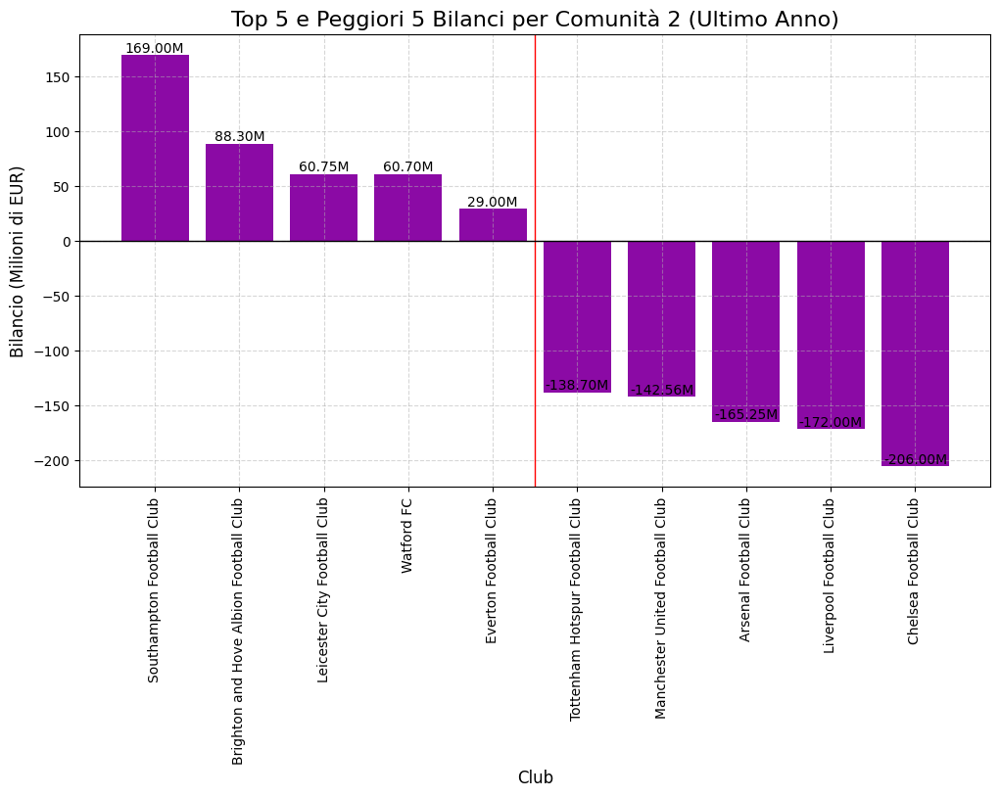


Comunità 5: Top 5 club con bilancio maggiore (2023/24):
Villarreal Club de Fútbol S.A.D.: 97.50 milioni di EUR
Futbol Club Barcelona: 91.54 milioni di EUR
Sporting Clube de Portugal: 80.75 milioni di EUR
Club Atlético de Madrid S.A.D.: 35.10 milioni di EUR
Futebol Clube de Famalicão: 24.91 milioni di EUR

Comunità 5: Top 5 club con bilancio minore (2023/24):
Sporting Clube de Braga: -13.95 milioni di EUR
Futebol Clube do Porto: -30.75 milioni di EUR
Sevilla Fútbol Club S.A.D.: -32.00 milioni di EUR
Real Madrid Club de Fútbol: -131.00 milioni di EUR
Manchester City Football Club: -189.10 milioni di EUR
Immagine salvata come charts/bilanci_comunita_5_ultimo_anno.png


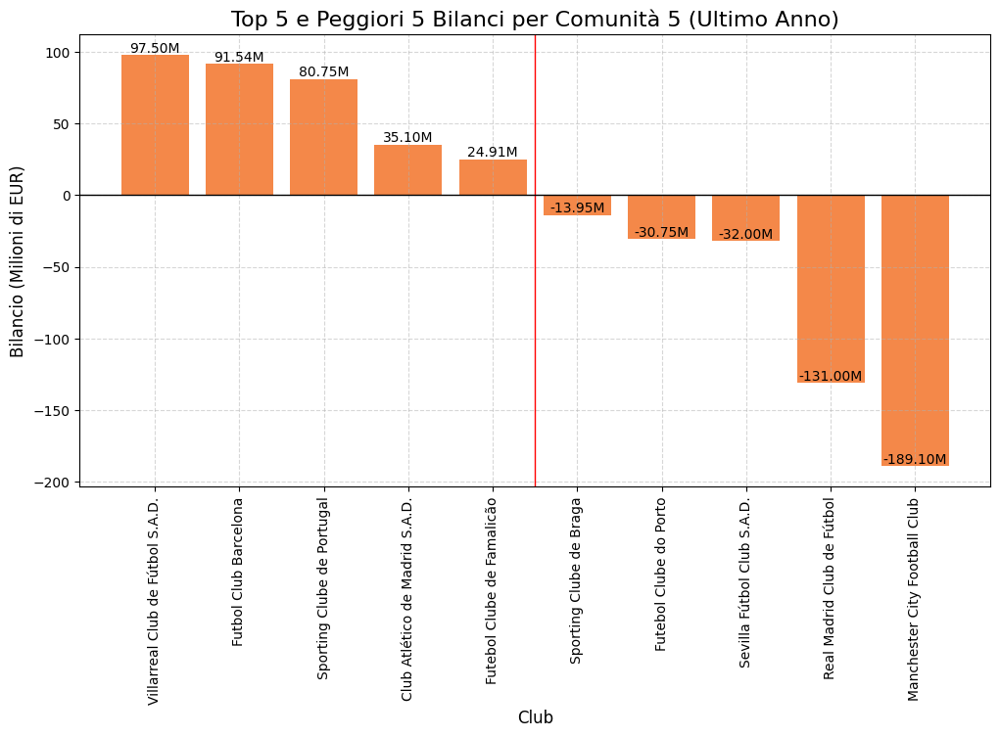


Comunità 7: Top 5 club con bilancio maggiore (2023/24):
FK Dinamo Moskva: 24.50 milioni di EUR
PFK CSKA Moskva: 13.90 milioni di EUR
FC Sochi: 3.00 milioni di EUR
FC Orenburg: 1.90 milioni di EUR
FK Nizhny Novgorod: 1.10 milioni di EUR

Comunità 7: Top 5 club con bilancio minore (2023/24):
Baltika Kaliningrad: -1.25 milioni di EUR
FK Krasnodar: -3.90 milioni di EUR
Футбольный клуб "Локомотив" Москва: -4.35 milioni di EUR
AO FK Zenit Sankt-Peterburg: -5.22 milioni di EUR
FK Spartak Moskva: -33.50 milioni di EUR
Immagine salvata come charts/bilanci_comunita_7_ultimo_anno.png


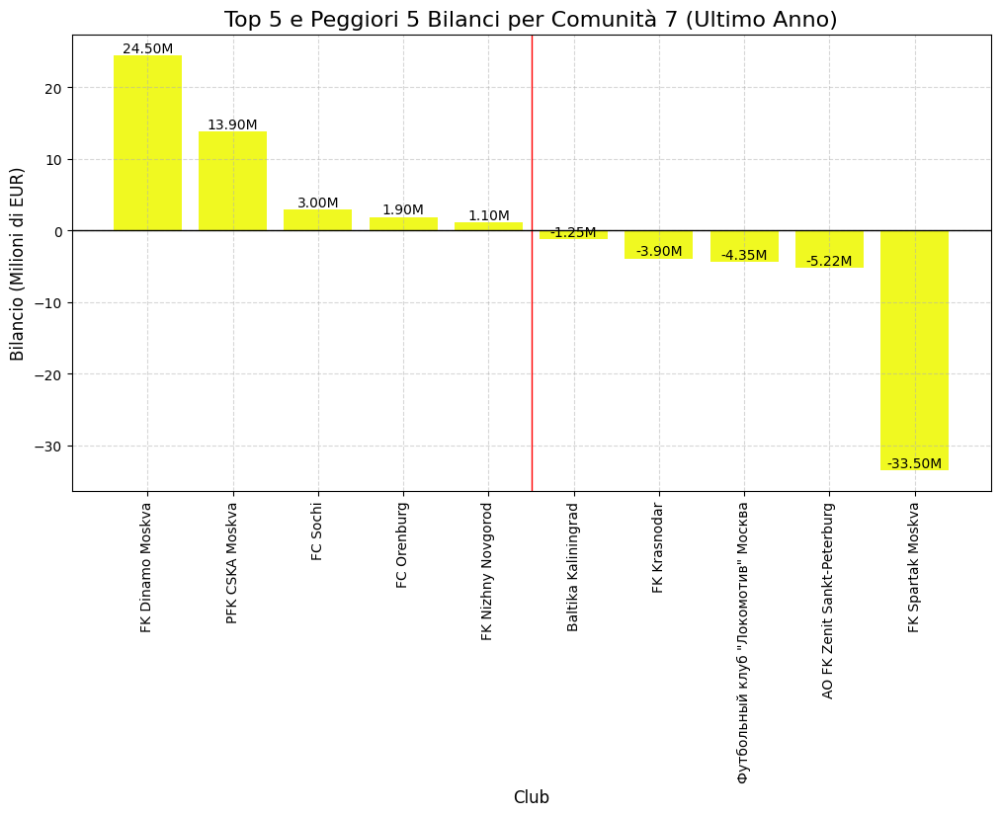


Comunità 8: Top 5 club con bilancio maggiore (2023/24):
Stade Rennais Football Club: 71.60 milioni di EUR
Olympique Lyonnais: 52.40 milioni di EUR
Club Brugge Koninklijke Voetbalvereniging: 45.80 milioni di EUR
FC Lorient: 42.70 milioni di EUR
Royal Antwerp Football Club: 40.50 milioni di EUR

Comunità 8: Top 5 club con bilancio minore (2023/24):
Association sportive de Monaco Football Club: -20.10 milioni di EUR
RWD Molenbeek: -26.35 milioni di EUR
Olympique Gymnaste Club Nice Côte d'Azur: -37.60 milioni di EUR
Olympique de Marseille: -39.20 milioni di EUR
Paris Saint-Germain Football Club: -379.50 milioni di EUR
Immagine salvata come charts/bilanci_comunita_8_ultimo_anno.png


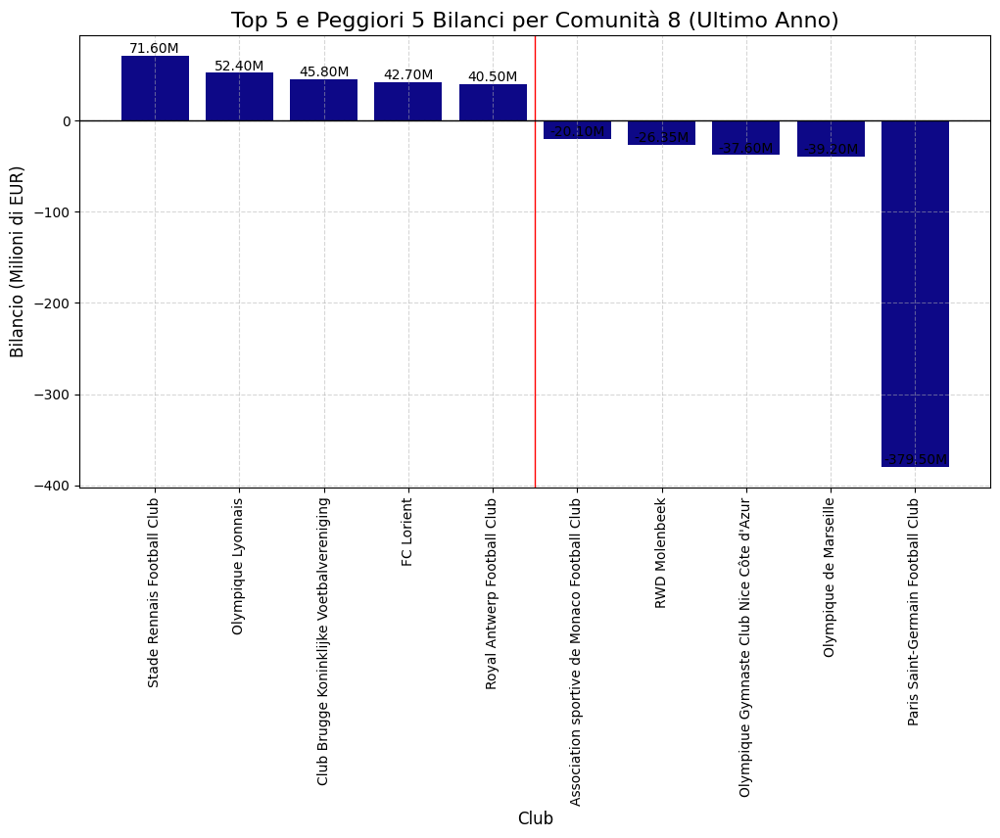


Comunità 6: Top 5 club con bilancio maggiore (2023/24):
FC Shakhtar Donetsk: 12.20 milioni di EUR
SC Dnipro-1: 6.12 milioni di EUR
FK Zarya Lugansk: 2.45 milioni di EUR
FC Oleksandriya: 1.31 milioni di EUR
Futbolniy Klub Dynamo Kyiv: 1.20 milioni di EUR

Comunità 6: Top 5 club con bilancio minore (2023/24):
NK Veres Rivne: -0.05 milioni di EUR
LNZ Cherkasy: -0.15 milioni di EUR
FK Kryvbas Kryvyi Rig: -0.24 milioni di EUR
FK Karpaty Lviv: -0.58 milioni di EUR
FK Polissya Zhytomyr: -1.25 milioni di EUR
Immagine salvata come charts/bilanci_comunita_6_ultimo_anno.png


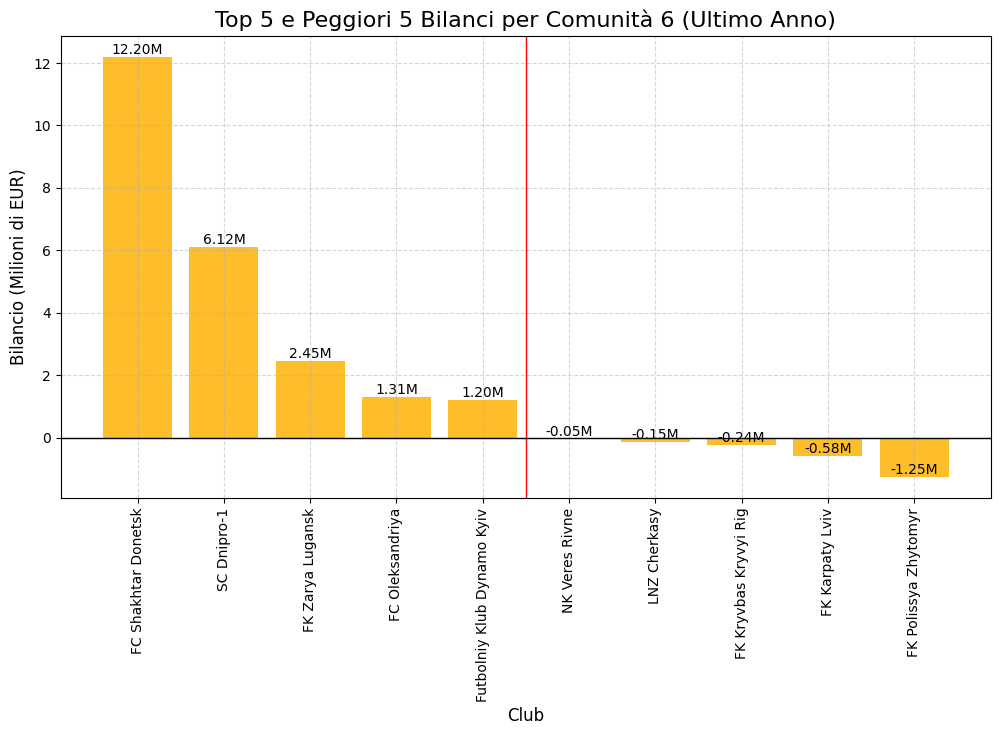

Immagine salvata come charts/bilanci_comunita_globale_media.png


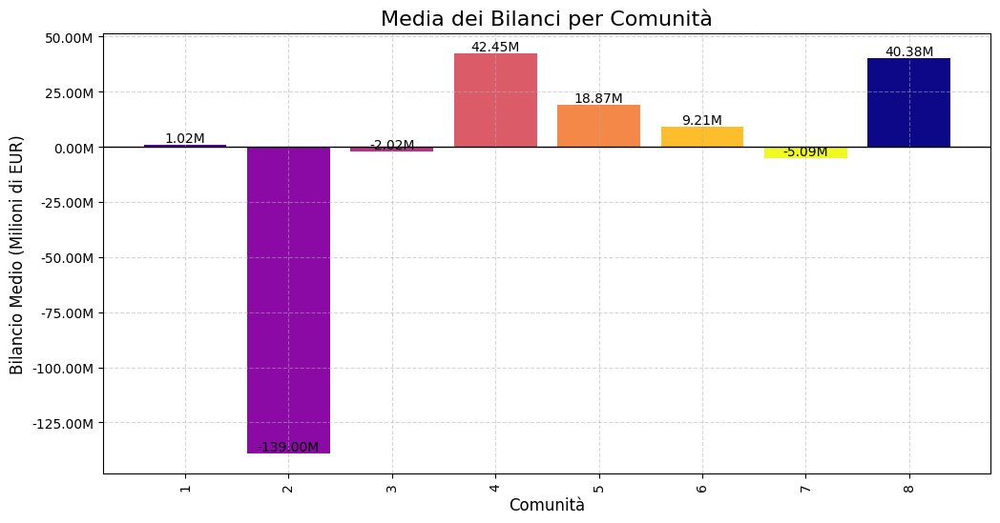

Immagine salvata come charts/bilanci_comunita_ultimo_anno_media.png


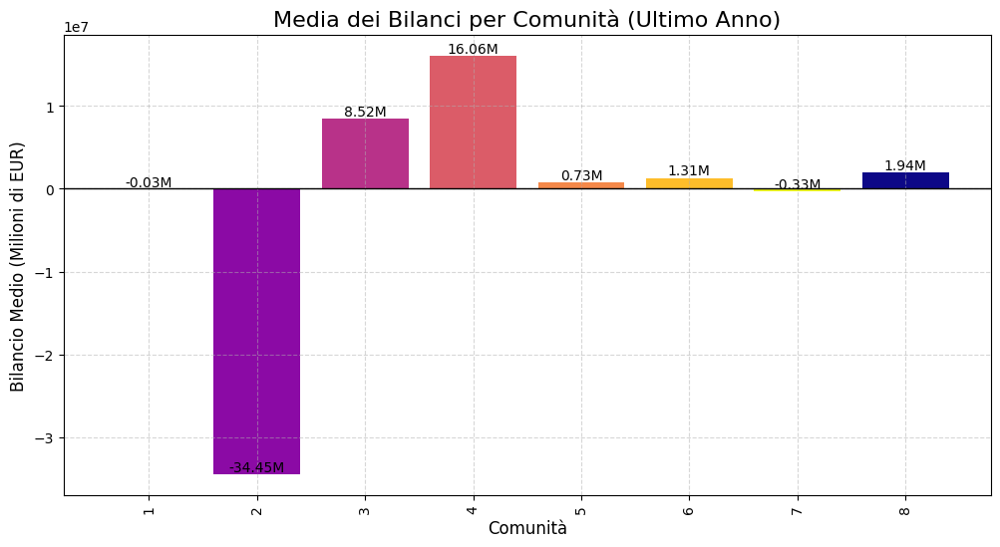

In [215]:
import os

# Funzione per creare una cartella per salvare le immagini
def create_output_dir():
    output_dir = "charts"
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    return output_dir

# 1. Grafico dei 5 club con bilancio maggiore e minore per comunità (Bilancio globale)
def plot_top_5_balance_per_community():
    output_dir = create_output_dir()  # Ottieni il percorso della cartella di output
    for community, nodes in community_nodes.items():
        community_balances = [(node, G.nodes[node]['balance']) for node in nodes]
        
        # Ordina i club per bilancio
        community_balances.sort(key=lambda x: x[1], reverse=True)

        # Top 5 positivi e top 5 negativi
        top_5_positive = community_balances[:5]
        top_5_negative = community_balances[-5:]

        print(f"\nComunità {community}: Top 5 club con bilancio maggiore:")
        for club, balance in top_5_positive:
            print(f"{club}: {balance / 1_000_000:.2f} milioni di EUR")
        
        print(f"\nComunità {community}: Top 5 club con bilancio minore:")
        for club, balance in top_5_negative:
            print(f"{club}: {balance / 1_000_000:.2f} milioni di EUR")

        # Visualizzazione dei top 5 club per bilancio
        top_clubs = [item[0] for item in top_5_positive + top_5_negative]
        top_balances = [item[1] / 1_000_000 for item in top_5_positive + top_5_negative]  # In milioni di EUR

        plt.figure(figsize=(12, 6))
        community_color = colors[community % num_communities]  # Usa il colore della comunità
        bars = plt.bar(top_clubs, top_balances, color=community_color)

        # Aggiungi una linea verticale di separazione tra i top 5 e i peggiori 5
        plt.axvline(x=4.5, color='red', linewidth=1)  # Linea verticale tra top 5 e peggiori 5
        plt.axhline(0, color='black', linewidth=1)   # Linea orizzontale sullo 0

        plt.title(f"Top 5 e Peggiori 5 Bilanci per Comunità {community} (Globale)", fontsize=16)
        plt.xlabel('Club', fontsize=12)
        plt.ylabel('Bilancio (Milioni di EUR)', fontsize=12)
        plt.xticks(rotation=90)

        # Aggiungi il valore sui barre in milioni
        for bar in bars:
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width() / 2, height, f'{height:,.2f}M', ha='center', va='bottom', fontsize=10)

        # Aggiungi la griglia come sfondo
        plt.grid(True, linestyle='--', alpha=0.5)

        # Salva l'immagine
        save_path = os.path.join(output_dir, f"bilanci_comunita_{community}_globale.png")
        plt.savefig(save_path)
        print(f"Immagine salvata come {save_path}")
        
        plt.show()

# 2. Grafico dei 5 club con bilancio maggiore e minore per comunità (Bilancio dell'ultimo anno)
def plot_top_5_balance_last_year_per_community():
    output_dir = create_output_dir()  # Ottieni il percorso della cartella di output
    # Filtra i trasferimenti dalla stagione 2023/24 in poi
    transfers_last_year = transfers[transfers['transfer_season'] == '23/24']

    # Calcola i bilanci per ogni comunità
    for community, nodes in community_nodes.items():
        community_balances = [(node, G.nodes[node]['balance_last_year']) for node in nodes]
        
        # Ordina i club per bilancio
        community_balances.sort(key=lambda x: x[1], reverse=True)

        top_5_positive = community_balances[:5]
        top_5_negative = community_balances[-5:]

        print(f"\nComunità {community}: Top 5 club con bilancio maggiore (2023/24):")
        for club, balance in top_5_positive:
            print(f"{club}: {balance / 1_000_000:.2f} milioni di EUR")
        
        print(f"\nComunità {community}: Top 5 club con bilancio minore (2023/24):")
        for club, balance in top_5_negative:
            print(f"{club}: {balance / 1_000_000:.2f} milioni di EUR")

        # Visualizzazione dei top 5 club per bilancio
        top_clubs = [item[0] for item in top_5_positive + top_5_negative]
        top_balances = [item[1] / 1_000_000 for item in top_5_positive + top_5_negative]  # In milioni di EUR

        plt.figure(figsize=(12, 6))
        community_color = colors[community % num_communities]  # Usa il colore della comunità
        bars = plt.bar(top_clubs, top_balances, color=community_color)

        # Aggiungi una linea verticale di separazione tra i top 5 e i peggiori 5
        plt.axvline(x=4.5, color='red', linewidth=1)  # Linea verticale tra top 5 e peggiori 5
        plt.axhline(0, color='black', linewidth=1)   # Linea orizzontale sullo 0

        plt.title(f"Top 5 e Peggiori 5 Bilanci per Comunità {community} (Ultimo Anno)", fontsize=16)
        plt.xlabel('Club', fontsize=12)
        plt.ylabel('Bilancio (Milioni di EUR)', fontsize=12)
        plt.xticks(rotation=90)

        # Aggiungi il valore sui barre in milioni
        for bar in bars:
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width() / 2, height, f'{height:,.2f}M', ha='center', va='bottom', fontsize=10)

        # Aggiungi la griglia come sfondo
        plt.grid(True, linestyle='--', alpha=0.5)

        # Salva l'immagine
        save_path = os.path.join(output_dir, f"bilanci_comunita_{community}_ultimo_anno.png")
        plt.savefig(save_path)
        print(f"Immagine salvata come {save_path}")

        plt.show()

# 3. Media dei bilanci per comunità (Bilancio globale)
def plot_average_balance_per_community():
    output_dir = create_output_dir()  # Ottieni il percorso della cartella di output
    avg_balance_per_community = defaultdict(float)  # Media dei bilanci per comunità
    for community, nodes in community_nodes.items():
        total_balance = sum(G.nodes[node]['balance'] for node in nodes)
        avg_balance_per_community[community] = total_balance / len(nodes)

    # Ordinamento delle comunità per bilancio medio in ordine decrescente
    sorted_communities = sorted(avg_balance_per_community.items(), key=lambda x: x[1], reverse=True)

    # Estrazione delle comunità e bilanci medi
    communities = [community for community, _ in sorted_communities]
    balances = [balance for _, balance in sorted_communities]

    # Visualizzazione della media dei bilanci per comunità
    plt.figure(figsize=(12, 6))
    color_mapping = [colors[community % num_communities] for community in communities]  # Colori per comunità
    bars = plt.bar(communities, balances, color=color_mapping)
    plt.title("Media dei Bilanci per Comunità", fontsize=16)
    plt.xlabel("Comunità", fontsize=12)
    plt.ylabel("Bilancio Medio (Milioni di EUR)", fontsize=12)
    plt.xticks(rotation=90)

    # Aggiungi il valore sui barre in milioni
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, height, f'{height / 1_000_000:,.2f}M', ha='center', va='bottom', fontsize=10)

    # Modifica l'asse delle ordinate per visualizzare i valori in milioni
    plt.gca().get_yaxis().set_major_formatter(plt.FuncFormatter(lambda x, loc: f'{x/1_000_000:.2f}M'))

    plt.axhline(0, color='black', linewidth=1)   # Linea orizzontale sullo 0

    # Aggiungi la griglia come sfondo
    plt.grid(True, linestyle='--', alpha=0.5)

    # Salva l'immagine
    save_path = os.path.join(output_dir, "bilanci_comunita_globale_media.png")
    plt.savefig(save_path)
    print(f"Immagine salvata come {save_path}")

    plt.show()

# 4. Media dei bilanci per comunità (Bilancio dell'ultimo anno)
def plot_average_balance_last_year_per_community():
    output_dir = create_output_dir()  # Ottieni il percorso della cartella di output
    # Filtra i trasferimenti dalla stagione 2023/24 in poi
    transfers_last_year = transfers[transfers['transfer_season'] == '23/24']
    
    # Ricalcola i bilanci per ogni club basato sui trasferimenti dell'ultimo anno
    for idx, row in transfers_last_year.iterrows():
        from_club_id = row['from_club_id']
        to_club_id = row['to_club_id']
        transfer_fee = row['transfer_fee']

        # Sostituisci valori NaN con 0
        transfer_fee = transfer_fee if pd.notna(transfer_fee) else 0

        # Ottieni i nomi dei club utilizzando la mappatura
        from_club_name = id_to_club_name.get(from_club_id)
        to_club_name = id_to_club_name.get(to_club_id)

        # Verifica che i club siano presenti nel grafo
        if from_club_name and to_club_name:
            if from_club_name in G.nodes() and to_club_name in G.nodes():
                # Bilancio dell'ultimo anno
                G.nodes[from_club_name]['balance_last_year'] += transfer_fee
                G.nodes[to_club_name]['balance_last_year'] -= transfer_fee

    # Calcola i bilanci medi per ogni comunità
    avg_balance_last_year_per_community = defaultdict(float)
    for community, nodes in community_nodes.items():
        total_balance = sum(G.nodes[node]['balance_last_year'] for node in nodes)
        avg_balance_last_year_per_community[community] = total_balance / len(nodes)

    # Ordinamento delle comunità per bilancio medio in ordine decrescente
    sorted_communities = sorted(avg_balance_last_year_per_community.items(), key=lambda x: x[1], reverse=True)

    # Estrazione delle comunità e bilanci medi
    communities = [community for community, _ in sorted_communities]
    balances = [balance for _, balance in sorted_communities]

    # Visualizzazione della media dei bilanci per comunità
    plt.figure(figsize=(12, 6))
    color_mapping = [colors[community % num_communities] for community in communities]  # Colori per comunità
    bars = plt.bar(communities, balances, color=color_mapping)
    plt.title("Media dei Bilanci per Comunità (Ultimo Anno)", fontsize=16)
    plt.xlabel("Comunità", fontsize=12)
    plt.ylabel("Bilancio Medio (Milioni di EUR)", fontsize=12)
    plt.xticks(rotation=90)

    # Aggiungi il valore sui barre in milioni
    for bar in bars:
        height = bar.get_height() 
        plt.text(bar.get_x() + bar.get_width() / 2, height, f'{height / 1_000_000:,.2f}M', ha='center', va='bottom', fontsize=10)    

    plt.axhline(0, color='black', linewidth=1)   # Linea orizzontale sullo 0

    # Aggiungi la griglia come sfondo
    plt.grid(True, linestyle='--', alpha=0.5)

    # Salva l'immagine
    save_path = os.path.join(output_dir, "bilanci_comunita_ultimo_anno_media.png")
    plt.savefig(save_path)
    print(f"Immagine salvata come {save_path}")

    plt.show()

# Invoca le funzioni per eseguire le analisi
plot_top_5_balance_per_community()  # Visualizza il bilancio globale per comunità
plot_top_5_balance_last_year_per_community()  # Visualizza il bilancio per l'ultimo anno per comunità
plot_average_balance_per_community()  # Visualizza la media dei bilanci per comunità (globale)
plot_average_balance_last_year_per_community()  # Visualizza la media dei bilanci per comunità (ultimo anno)

In [208]:
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
from collections import defaultdict

# Carica i dati relativi ai trasferimenti
transfers = pd.read_csv("../Datasets/SNA/transfers.csv")

# Carica i dati dei club (Assumiamo che 'clubs.csv' contenga 'id' e 'name')
clubs = pd.read_csv("../Datasets/SNA/clubs.csv")

# Crea una mappatura tra ID e nome del club
id_to_club_name = dict(zip(clubs['club_id'], clubs['name']))

# Funzione per calcolare e stampare i bilanci per una squadra in un anno specifico
def print_transfers_and_balance_for_team_from_graph(team_name, year):
    # Filtra i trasferimenti per l'anno specificato
    transfers_year = transfers[transfers['transfer_season'] == year]
    
    # Trova i trasferimenti in uscita (da 'team_name' a un altro club)
    outgoing_transfers = transfers_year[transfers_year['from_club_name'] == team_name]
    
    # Trova i trasferimenti in entrata (da un altro club a 'team_name')
    incoming_transfers = transfers_year[transfers_year['to_club_name'] == team_name]

    # Calcolo del bilancio in uscita e in entrata
    outgoing_balance = outgoing_transfers['transfer_fee'].sum()
    incoming_balance = incoming_transfers['transfer_fee'].sum()
    total_balance = outgoing_balance - incoming_balance  # Bilancio totale (entrata - uscita)
    
    print(outgoing_balance)

    # Stampa dei trasferimenti in uscita
    print(f"Trasferimenti in uscita per {team_name} nel {year}:")
    if not outgoing_transfers.empty:
        for idx, row in outgoing_transfers.iterrows():
            print(f"{row['player_name']} -> {row['to_club_name']} | Fee: {row['transfer_fee']} EUR")
    else:
        print("Nessun trasferimento in uscita.")
    
    print("\n")  # Aggiungi una linea vuota tra i trasferimenti in entrata e in uscita
    
    # Stampa dei trasferimenti in entrata
    print(f"Trasferimenti in entrata per {team_name} nel {year}:")
    if not incoming_transfers.empty:
        for idx, row in incoming_transfers.iterrows():
            print(f"{row['player_name']} <- {row['from_club_name']} | Fee: {row['transfer_fee']} EUR")
    else:
        print("Nessun trasferimento in entrata.")
    
    # Stampa il bilancio
    print("\nBilancio per la stagione:")
    print(f"Entrate: {incoming_balance / 1_000_000:.2f} milioni di EUR")
    print(f"Uscite: {outgoing_balance / 1_000_000:.2f} milioni di EUR")
    print(f"Bilancio totale: {total_balance / 1_000_000:.2f} milioni di EUR")

# Esempio di utilizzo della funzione
team_name = "Inter"  # Cambia con il nome della squadra
year = "23/24"  # Cambia con l'anno desiderato

print_transfers_and_balance_for_team_from_graph(team_name, year)

102970000.0
Trasferimenti in uscita per Inter nel 23/24:
Marko Arnautovic -> Bologna | Fee: 0.0 EUR
Emil Audero -> Sampdoria | Fee: 0.0 EUR
Davide Frattesi -> Sassuolo | Fee: 0.0 EUR
Carlos Augusto -> Monza | Fee: 0.0 EUR
Eddie Salcedo -> Lecco | Fee: 0.0 EUR
Lucien Agoumé -> Sevilla FC | Fee: 0.0 EUR
Franco Carboni -> Ternana | Fee: 0.0 EUR
Joaquín Correa -> Marseille | Fee: 0.0 EUR
Eddie Salcedo -> Eldense | Fee: 0.0 EUR
Valentino Lazaro -> Torino | Fee: 3400000.0 EUR
Sebastiano Esposito -> Sampdoria | Fee: 0.0 EUR
Giovanni Fabbian -> Bologna | Fee: 5370000.0 EUR
Robin Gosens -> Union Berlin | Fee: 13000000.0 EUR
Filip Stankovic -> Sampdoria | Fee: 0.0 EUR
Danilo D'Ambrosio -> Monza | Fee: 0.0 EUR
Andrei Radu -> Bournemouth | Fee: 0.0 EUR
André Onana -> Man Utd | Fee: 50200000.0 EUR
Gaetano Oristanio -> Cagliari Calcio | Fee: 0.0 EUR
Valentín Carboni -> Monza | Fee: 0.0 EUR
Martín Satriano -> Stade Brestois | Fee: 0.0 EUR
Zinho Vanheusden -> Standard Liège | Fee: 0.0 EUR
Roberto Gagl

In [ ]:
# Verifica i nomi delle colonne nel dataset clubs
print(id_to_club_name)

NameError: name 'last_year_transfers' is not defined

In [140]:
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
from collections import defaultdict

# Carica i dati relativi ai trasferimenti
transfers = pd.read_csv("../Datasets/SNA/transfers.csv")

# Carica i dati dei club (Assumiamo che 'clubs.csv' contenga 'id' e 'name')
clubs = pd.read_csv("../Datasets/SNA/clubs.csv")

# Crea una mappatura tra ID e nome del club
id_to_club_name = dict(zip(clubs['club_id'], clubs['name']))

# Funzione per calcolare e stampare i bilanci per una squadra in un anno specifico
def print_transfers_and_balance_for_all_teams_from_graph(year):
    # Filtra i trasferimenti per l'anno specificato
    transfers_year = transfers[transfers['transfer_season'] == year]
    
    # Itera su tutti gli ID dei club
    for team_id in id_to_club_name.keys():
        team_name = id_to_club_name[team_id]  # Ottieni il nome della squadra dall'ID
        
        # Trova i trasferimenti in uscita (da 'team_name' a un altro club)
        outgoing_transfers = transfers_year[transfers_year['from_club_id'] == team_id]
        
        # Trova i trasferimenti in entrata (da un altro club a 'team_name')
        incoming_transfers = transfers_year[transfers_year['to_club_id'] == team_id]

        # Calcolo del bilancio in uscita e in entrata
        outgoing_balance = outgoing_transfers['transfer_fee'].sum()
        incoming_balance = incoming_transfers['transfer_fee'].sum()
        
        # Se ci sono valori NaN, sostituirli con 0
        outgoing_balance = 0 if pd.isna(outgoing_balance) else outgoing_balance
        incoming_balance = 0 if pd.isna(incoming_balance) else incoming_balance
        
        total_balance = incoming_balance - outgoing_balance  # Bilancio totale (entrata - uscita)

        # Stampa dei trasferimenti in uscita
        print(f"\nTrasferimenti in uscita per {team_name} nel {year}:")
        if not outgoing_transfers.empty:
            for idx, row in outgoing_transfers.iterrows():
                fee = 0 if pd.isna(row['transfer_fee']) else row['transfer_fee']
                print(f"{row['player_name']} -> {row['to_club_name']} | Fee: {fee} EUR")
        else:
            print("Nessun trasferimento in uscita.")
        
        print("\n")  # Aggiungi una linea vuota tra i trasferimenti in entrata e in uscita
        
        # Stampa dei trasferimenti in entrata
        print(f"Trasferimenti in entrata per {team_name} nel {year}:")
        if not incoming_transfers.empty:
            for idx, row in incoming_transfers.iterrows():
                fee = 0 if pd.isna(row['transfer_fee']) else row['transfer_fee']
                print(f"{row['player_name']} <- {row['from_club_name']} | Fee: {fee} EUR")
        else:
            print("Nessun trasferimento in entrata.")
        
        # Stampa il bilancio
        print("\nBilancio per la stagione:")
        print(f"Entrate: {incoming_balance / 1_000_000:.2f} milioni di EUR")
        print(f"Uscite: {outgoing_balance / 1_000_000:.2f} milioni di EUR")
        print(f"Bilancio totale: {total_balance / 1_000_000:.2f} milioni di EUR")

# Esempio di utilizzo della funzione per tutte le squadre
year = "23/24"  # Cambia con l'anno desiderato

print_transfers_and_balance_for_all_teams_from_graph(year)


Trasferimenti in uscita per SV Darmstadt 98 nel 23/24:
Sebastian Polter -> FC Schalke 04 | Fee: 0.0 EUR
Gerrit Holtmann -> VfL Bochum | Fee: 0.0 EUR
Luca Pfeiffer -> VfB Stuttgart | Fee: 0.0 EUR
Tim Skarke -> Union Berlin | Fee: 0.0 EUR
Julian Justvan -> TSG Hoffenheim | Fee: 0.0 EUR
Bartol Franjic -> VfL Wolfsburg | Fee: 0.0 EUR
Matej Maglica -> VfB Stuttgart | Fee: 0.0 EUR
Frank Ronstadt -> 1.FC K'lautern | Fee: 50000.0 EUR
Filip Stojilkovic -> 1.FC K'lautern | Fee: 0.0 EUR
Phillip Tietz -> FC Augsburg | Fee: 2200000.0 EUR
Patric Pfeiffer -> FC Augsburg | Fee: 0.0 EUR


Trasferimenti in entrata per SV Darmstadt 98 nel 23/24:
Filip Stojilkovic <- 1.FC K'lautern | Fee: 0.0 EUR
Sebastian Polter <- FC Schalke 04 | Fee: 0.0 EUR
Gerrit Holtmann <- VfL Bochum | Fee: 0.0 EUR
Julian Justvan <- TSG Hoffenheim | Fee: 0.0 EUR
Tim Skarke <- Union Berlin | Fee: 0.0 EUR
Bartol Franjic <- VfL Wolfsburg | Fee: 0.0 EUR
Luca Pfeiffer <- VfB Stuttgart | Fee: 0.0 EUR
Christoph Klarer <- F. Düsseldorf | 